In [ ]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns

In [ ]:
# Load the Drive helper and mount
from google.colab import drive
drive.mount('/content/gdrive')

Drive already mounted at /content/gdrive; to attempt to forcibly remount, call drive.mount("/content/gdrive", force_remount=True).


In [ ]:
df = pd.read_csv("/content/gdrive/MyDrive/datamining/jabodetabek_house_price.csv")
print(df.columns)

Index(['url', 'price_in_rp', 'title', 'address', 'district', 'city', 'lat',
       'long', 'facilities', 'property_type', 'ads_id', 'bedrooms',
       'bathrooms', 'land_size_m2', 'building_size_m2', 'carports',
       'certificate', 'electricity', 'maid_bedrooms', 'maid_bathrooms',
       'floors', 'building_age', 'year_built', 'property_condition',
       'building_orientation', 'garages', 'furnishing'],
      dtype='object')


In [ ]:
df

,url,price_in_rp,title,address,district,city,lat,long,facilities,property_type,...,electricity,maid_bedrooms,maid_bathrooms,floors,building_age,year_built,property_condition,building_orientation,garages,furnishing
0,https://www.rumah123.com/properti/bekasi/hos11...,2.990000e+09,Rumah cantik Sumarecon Bekasi\nLingkungan asri...,"Summarecon Bekasi, Bekasi",Summarecon Bekasi,Bekasi,-6.223945,106.986275,"Tempat Jemuran, Jalur Telepon, Taman, Taman",rumah,...,4400 mah,0.0,1.0,2.0,5.0,2017.0,bagus,NaN,0.0,unfurnished
1,https://www.rumah123.com/properti/bekasi/hos10...,1.270000e+09,"Rumah Kekinian, Magenta Summarecon Bekasi","Summarecon Bekasi, Bekasi",Summarecon Bekasi,Bekasi,-6.223945,106.986275,Taman,rumah,...,2200 mah,0.0,0.0,2.0,NaN,NaN,bagus,NaN,0.0,NaN
2,https://www.rumah123.com/properti/bekasi/hos10...,1.950000e+09,Rumah Cantik 2 Lantai Cluster Bluebell Summare...,"Summarecon Bekasi, Bekasi",Summarecon Bekasi,Bekasi,-6.223945,106.986275,"Jogging Track, Kolam Renang, Masjid, Taman,...",rumah,...,2200 mah,1.0,1.0,2.0,NaN,NaN,bagus,NaN,1.0,unfurnished
3,https://www.rumah123.com/properti/bekasi/hos10...,3.300000e+09,Rumah Mewah 2Lantai L10x18 C di Cluster VERNON...,"Summarecon Bekasi, Bekasi",Summarecon Bekasi,Bekasi,-6.223945,106.986275,"Jalur Telepon, Jogging Track, Track Lari, K...",rumah,...,3500 mah,1.0,1.0,2.0,6.0,2016.0,bagus sekali,utara,2.0,unfurnished
4,https://www.rumah123.com/properti/bekasi/hos10...,4.500000e+09,"Rumah Hoek di Cluster Maple Summarecon Bekasi,...","Summarecon Bekasi, Bekasi",Summarecon Bekasi,Bekasi,-6.223945,106.986275,"Jogging Track, Kolam Renang, Taman, Jalur Te...",rumah,...,3500 mah,1.0,1.0,2.0,9.0,2013.0,bagus,utara,1.0,unfurnished
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
3548,https://www.rumah123.com/properti/tangerang/ho...,5.880000e+08,Terbaru Cluster Minimalis Sudimara Dekat Stasiun,"Jombang, Tangerang",Jombang,Tangerang,-6.296615,106.704601,"Masjid, Taman, Tempat Jemuran, Keamanan 24 ja...",rumah,...,1300 mah,0.0,0.0,1.0,0.0,2022.0,baru,NaN,1.0,furnished
3549,https://www.rumah123.com/properti/tangerang/ho...,7.850000e+08,Rumah Modern Asri dan Nyaman Bebas Banjir Loka...,"Lengkong Kulon, Tangerang",Lengkong Kulon,Tangerang,-6.283454,106.638775,"Masjid, Keamanan, Jogging Track, Taman, Tem...",rumah,...,1300 mah,0.0,0.0,2.0,0.0,2022.0,baru,utara,0.0,unfurnished
3550,https://www.rumah123.com/properti/tangerang/ho...,7.550000e+08,Rumah Mewah Murah 2 Lantai Gratis Biaya Biaya ...,"Lengkong Kulon, Tangerang",Lengkong Kulon,Tangerang,-6.283454,106.638775,"Keamanan, Taman, Jogging Track, Tempat Jemur...",rumah,...,1300 mah,0.0,0.0,2.0,0.0,2022.0,baru,utara,0.0,unfurnished
3551,https://www.rumah123.com/properti/tangerang/ho...,8.000000e+08,Rumah 2 Lantai Dekat Perkantoran BSD City AEON...,"BSD Provance Parkland, Tangerang",BSD Provance Parkland,Tangerang,-6.288237,106.665859,"Tempat Jemuran, Keamanan, Keamanan 24 jam, Was...",rumah,...,2200 mah,0.0,0.0,2.0,0.0,2022.0,baru,selatan,0.0,furnished


# Data kategorikal

In [ ]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 3553 entries, 0 to 3552
Data columns (total 27 columns):
 #   Column                Non-Null Count  Dtype  
---  ------                --------------  -----  
 0   url                   3553 non-null   object 
 1   price_in_rp           3553 non-null   float64
 2   title                 3553 non-null   object 
 3   address               3553 non-null   object 
 4   district              3553 non-null   object 
 5   city                  3553 non-null   object 
 6   lat                   3553 non-null   float64
 7   long                  3553 non-null   float64
 8   facilities            3553 non-null   object 
 9   property_type         3552 non-null   object 
 10  ads_id                3549 non-null   object 
 11  bedrooms              3519 non-null   float64
 12  bathrooms             3524 non-null   float64
 13  land_size_m2          3551 non-null   float64
 14  building_size_m2      3551 non-null   float64
 15  carports             

In [ ]:
df = df.drop(["url", "title","address","ads_id","property_type","building_orientation","building_age","year_built","certificate"], axis = 1)


In [ ]:
df.head(5)

,price_in_rp,district,city,lat,long,facilities,bedrooms,bathrooms,land_size_m2,building_size_m2,carports,electricity,maid_bedrooms,maid_bathrooms,floors,property_condition,garages,furnishing
0,2.990000e+09,Summarecon Bekasi,Bekasi,-6.223945,106.986275,"Tempat Jemuran, Jalur Telepon, Taman, Taman",4.0,4.0,239.0,272.0,0.0,4400 mah,0.0,1.0,2.0,bagus,0.0,unfurnished
1,1.270000e+09,Summarecon Bekasi,Bekasi,-6.223945,106.986275,Taman,3.0,2.0,55.0,69.0,1.0,2200 mah,0.0,0.0,2.0,bagus,0.0,NaN
2,1.950000e+09,Summarecon Bekasi,Bekasi,-6.223945,106.986275,"Jogging Track, Kolam Renang, Masjid, Taman,...",3.0,3.0,119.0,131.0,1.0,2200 mah,1.0,1.0,2.0,bagus,1.0,unfurnished
3,3.300000e+09,Summarecon Bekasi,Bekasi,-6.223945,106.986275,"Jalur Telepon, Jogging Track, Track Lari, K...",3.0,3.0,180.0,174.0,0.0,3500 mah,1.0,1.0,2.0,bagus sekali,2.0,unfurnished
4,4.500000e+09,Summarecon Bekasi,Bekasi,-6.223945,106.986275,"Jogging Track, Kolam Renang, Taman, Jalur Te...",4.0,3.0,328.0,196.0,2.0,3500 mah,1.0,1.0,2.0,bagus,1.0,unfurnished


In [ ]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 3553 entries, 0 to 3552
Data columns (total 18 columns):
 #   Column              Non-Null Count  Dtype  
---  ------              --------------  -----  
 0   price_in_rp         3553 non-null   float64
 1   district            3553 non-null   object 
 2   city                3553 non-null   object 
 3   lat                 3553 non-null   float64
 4   long                3553 non-null   float64
 5   facilities          3553 non-null   object 
 6   bedrooms            3519 non-null   float64
 7   bathrooms           3524 non-null   float64
 8   land_size_m2        3551 non-null   float64
 9   building_size_m2    3551 non-null   float64
 10  carports            3553 non-null   float64
 11  electricity         3553 non-null   object 
 12  maid_bedrooms       3553 non-null   float64
 13  maid_bathrooms      3553 non-null   float64
 14  floors              3547 non-null   float64
 15  property_condition  3307 non-null   object 
 16  garage

In [ ]:
df.isnull().sum()

price_in_rp             0
district                0
city                    0
lat                     0
long                    0
facilities              0
bedrooms               34
bathrooms              29
land_size_m2            2
building_size_m2        2
carports                0
electricity             0
maid_bedrooms           0
maid_bathrooms          0
floors                  6
property_condition    246
garages                 0
furnishing            387
dtype: int64

In [ ]:
df = df.dropna()

In [ ]:
df.head()

,price_in_rp,district,city,lat,long,facilities,bedrooms,bathrooms,land_size_m2,building_size_m2,carports,electricity,maid_bedrooms,maid_bathrooms,floors,property_condition,garages,furnishing
0,2.990000e+09,Summarecon Bekasi,Bekasi,-6.223945,106.986275,"Tempat Jemuran, Jalur Telepon, Taman, Taman",4.0,4.0,239.0,272.0,0.0,4400 mah,0.0,1.0,2.0,bagus,0.0,unfurnished
2,1.950000e+09,Summarecon Bekasi,Bekasi,-6.223945,106.986275,"Jogging Track, Kolam Renang, Masjid, Taman,...",3.0,3.0,119.0,131.0,1.0,2200 mah,1.0,1.0,2.0,bagus,1.0,unfurnished
3,3.300000e+09,Summarecon Bekasi,Bekasi,-6.223945,106.986275,"Jalur Telepon, Jogging Track, Track Lari, K...",3.0,3.0,180.0,174.0,0.0,3500 mah,1.0,1.0,2.0,bagus sekali,2.0,unfurnished
4,4.500000e+09,Summarecon Bekasi,Bekasi,-6.223945,106.986275,"Jogging Track, Kolam Renang, Taman, Jalur Te...",4.0,3.0,328.0,196.0,2.0,3500 mah,1.0,1.0,2.0,bagus,1.0,unfurnished
5,2.700000e+09,Summarecon Bekasi,Bekasi,-6.223945,106.986275,"Jalur Telepon, Taman, Keamanan, Kolam Renang",3.0,3.0,136.0,200.0,2.0,3500 mah,1.0,1.0,2.0,bagus,1.0,semi furnished


In [ ]:
df = df[["district","lat","long","city","electricity","property_condition","furnishing"]]

In [ ]:
from sklearn.preprocessing import LabelEncoder

# Membuat objek LabelEncoder
le = LabelEncoder()

# Melakukan label encoding untuk kolom 'city'
df['city'] = le.fit_transform(df['city'])

# Melakukan label encoding untuk kolom 'property_condition'
df['property_condition'] = le.fit_transform(df['property_condition'])

# Melakukan label encoding untuk kolom 'furnishing'
df['furnishing'] = le.fit_transform(df['furnishing'])

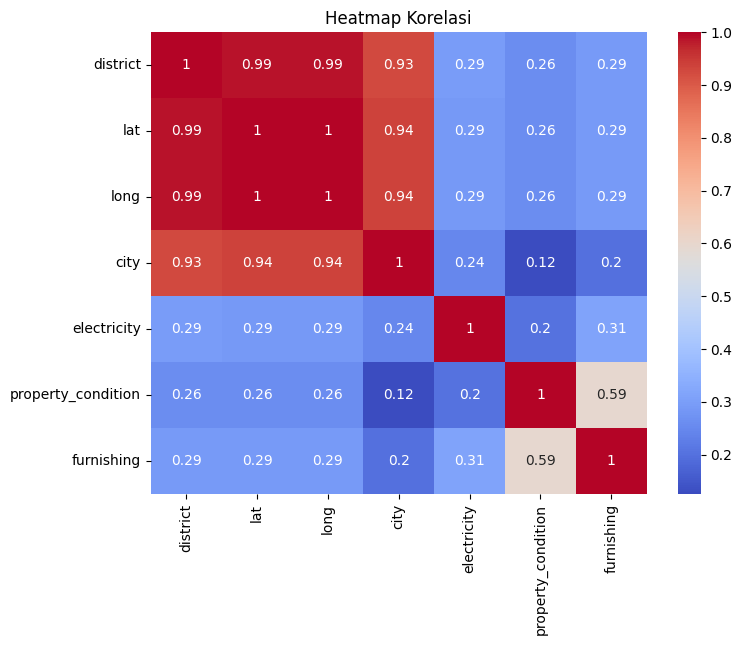

In [ ]:
import pandas as pd
import numpy as np
import scipy.stats as ss
import seaborn as sns
import matplotlib.pyplot as pltKo

# Misalkan kita memiliki DataFrame df
def cramers_v(x, y):
    confusion_matrix = pd.crosstab(x,y)
    chi2 = ss.chi2_contingency(confusion_matrix)[0]
    n = confusion_matrix.sum().sum()
    phi2 = chi2/n
    r,k = confusion_matrix.shape
    phi2corr = max(0, phi2-((k-1)*(r-1))/(n-1))
    rcorr = r-((r-1)**2)/(n-1)
    kcorr = k-((k-1)**2)/(n-1)
    return np.sqrt(phi2corr/min((kcorr-1),(rcorr-1)))

# Hitung matriks korelasi
corr_matrix = df.apply(lambda x : pd.factorize(x)[0]).corr(method=cramers_v)

# Buat heatmap
plt.figure(figsize=(8, 6))
sns.heatmap(corr_matrix, annot=True, cmap='coolwarm')

# Tampilkan plot
plt.title('Heatmap Korelasi')
plt.show()


Init: initializing centroids
Init: initializing clusters
Starting iterations...
Run 1, iteration: 1/100, moves: 0, cost: 9487.0
Init: initializing centroids
Init: initializing clusters
Starting iterations...
Run 2, iteration: 1/100, moves: 0, cost: 9487.0
Init: initializing centroids
Init: initializing clusters
Starting iterations...
Run 3, iteration: 1/100, moves: 0, cost: 9487.0
Init: initializing centroids
Init: initializing clusters
Starting iterations...
Run 4, iteration: 1/100, moves: 0, cost: 9487.0
Init: initializing centroids
Init: initializing clusters
Starting iterations...
Run 5, iteration: 1/100, moves: 0, cost: 9487.0
Best run was number 1
Init: initializing centroids
Init: initializing clusters
Starting iterations...
Run 1, iteration: 1/100, moves: 498, cost: 8213.0
Run 1, iteration: 2/100, moves: 167, cost: 8213.0
Init: initializing centroids
Init: initializing clusters
Starting iterations...
Run 2, iteration: 1/100, moves: 602, cost: 8357.0
Run 2, iteration: 2/100, mov

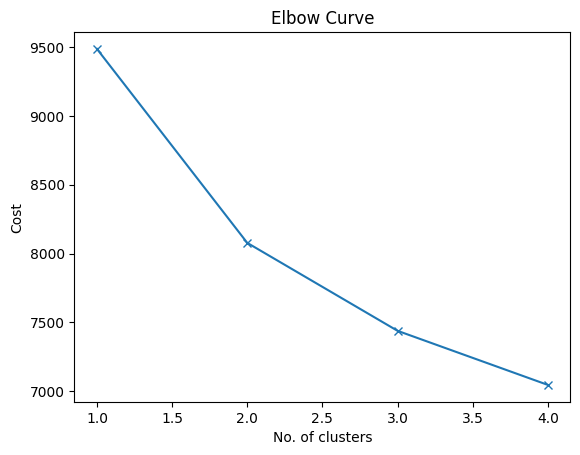

In [ ]:
# importing necessary libraries
import pandas as pd
import numpy as np
# !pip install kmodes
from kmodes.kmodes import KModes
import matplotlib.pyplot as plt
%matplotlib inline

# Elbow curve to find optimal K
cost = []
K = range(1,5)
for k in list(K):
    kmode = KModes(n_clusters=k, init = "random", n_init = 5, verbose=1)
    kmode.fit_predict(df[["district","city","electricity","property_condition","furnishing"]])
    cost.append(kmode.cost_)

plt.plot(K, cost, 'x-')
plt.xlabel('No. of clusters')
plt.ylabel('Cost')
plt.title('Elbow Curve')
plt.show()

In [ ]:
kn3 = KModes(n_clusters=3, random_state=1)
kn3

KModes(n_clusters=3, n_init=1, random_state=1)

In [ ]:
kn3.fit(df[["district","city","electricity","property_condition","furnishing"]])

KModes(n_clusters=3, n_init=1, random_state=1)

In [ ]:
kn3.labels_

array([0, 0, 0, ..., 1, 1, 1], dtype=uint16)

In [ ]:
# Building the model with 3 clusters
# kmode = kn3(n_clusters=3, init = "random", n_init = 5, verbose=1)
# clusters = kn3.fit_predict(df)
# clusters
df["cluster_kmodes"] = kn3.predict(df[["district","city","electricity","property_condition","furnishing"]])
display(df)


,district,lat,long,city,electricity,property_condition,furnishing,cluster_kmodes
0,Summarecon Bekasi,-6.223945,106.986275,0,4400 mah,0,3,0
2,Summarecon Bekasi,-6.223945,106.986275,0,2200 mah,0,3,0
3,Summarecon Bekasi,-6.223945,106.986275,0,3500 mah,1,3,0
4,Summarecon Bekasi,-6.223945,106.986275,0,3500 mah,0,3,0
5,Summarecon Bekasi,-6.223945,106.986275,0,3500 mah,0,2,0
...,...,...,...,...,...,...,...,...
3548,Jombang,-6.296615,106.704601,8,1300 mah,2,1,1
3549,Lengkong Kulon,-6.283454,106.638775,8,1300 mah,2,3,1
3550,Lengkong Kulon,-6.283454,106.638775,8,1300 mah,2,3,1
3551,BSD Provance Parkland,-6.288237,106.665859,8,2200 mah,2,1,1


In [ ]:
df['cluster_kmodes'].value_counts()

cluster_kmodes
0    1729
1     801
2     426
Name: count, dtype: int64

In [ ]:
!pip install gower

In [ ]:
import gower
from sklearn.metrics import silhouette_score
labels = kn3.labels_
# Menghitung matriks jarak dengan Gower's distance
distance_matrix = gower.gower_matrix(df[["district","city","electricity","property_condition","furnishing"]])

# Menghitung skor Silhouette
silhouette_score = silhouette_score(distance_matrix, labels, metric='precomputed')

print("Silhouette Score: ", silhouette_score)

Silhouette Score:  0.064878784


In [ ]:
kn5_b = KModes(n_clusters=3, random_state=1)
kn5_b.fit(df[["district","city","electricity","property_condition","furnishing"]])
kn5_b.labels_

array([0, 0, 0, ..., 1, 1, 1], dtype=uint16)

In [ ]:
import gower
from sklearn.metrics import silhouette_score
labels = kn5_b.labels_
# Menghitung matriks jarak dengan Gower's distance
distance_matrix = gower.gower_matrix(df[["district","city","electricity","property_condition","furnishing"]])

# Menghitung skor Silhouette
silhouette_score = silhouette_score(distance_matrix, labels, metric='precomputed')

print("Silhouette Score: ", silhouette_score)

Silhouette Score:  0.064878784


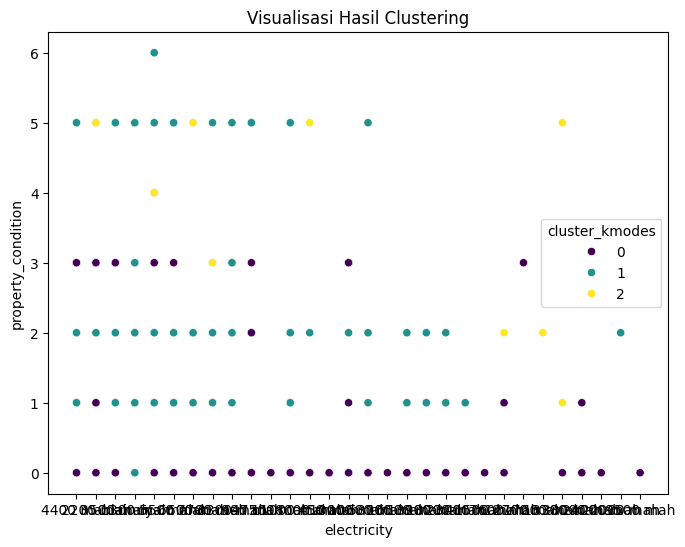

In [ ]:
import matplotlib.pyplot as plt

# Tambahkan hasil cluster ke DataFrame
# Plot hasil cluster
plt.figure(figsize=(8, 6))

# Ganti 'fitur1' dan 'fitur2' dengan nama kolom yang sesuai dari DataFrame Anda
sns.scatterplot(data=df, x='electricity', y='property_condition', hue='cluster_kmodes', palette='viridis')

plt.title('Visualisasi Hasil Clustering')
plt.show()


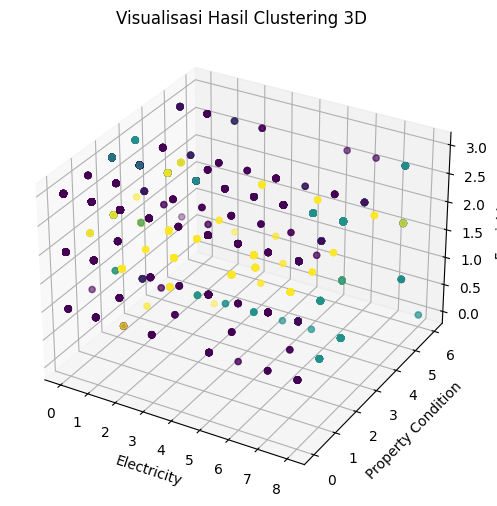

In [ ]:
from mpl_toolkits.mplot3d import Axes3D

fig = plt.figure(figsize=(8, 6))
ax = fig.add_subplot(111, projection='3d')

# Ganti 'fitur1', 'fitur2', dan 'fitur3' dengan nama kolom yang sesuai dari DataFrame Anda
ax.scatter(df['city'], df['property_condition'], df['furnishing'], c=df['cluster_kmodes'].values, cmap='viridis')
ax.set_xlabel('Electricity')
ax.set_ylabel('Property Condition')
ax.set_zlabel('Furnishing')

plt.title('Visualisasi Hasil Clustering 3D')
plt.show()


In [ ]:
cluster_1 = df[['lat','long']][df["cluster_kmodes"]==0].values.tolist()
cluster_2 = df[['lat','long']][df["cluster_kmodes"]==1].values.tolist()
cluster_3 = df[['lat','long']][df["cluster_kmodes"]==2].values.tolist()


In [ ]:
import folium
from folium import plugins
map = folium.Map(location = [-2.548926, 118.0148634], zoom_start = 10, title = "openstreetmap")
map

In [ ]:
for i in cluster_1 :
  folium.CircleMarker(i,radius =2, color = "blue").add_to(map)
for i in cluster_2 :
  folium.CircleMarker(i,radius =2, color = "red").add_to(map)
for i in cluster_3 :
  folium.CircleMarker(i,radius =2, color = "yellow").add_to(map)
map

# Data numeric standar scaler

In [ ]:
df = pd.read_csv("/content/gdrive/MyDrive/datamining/jabodetabek_house_price.csv")
print(df.columns)

Index(['url', 'price_in_rp', 'title', 'address', 'district', 'city', 'lat',
       'long', 'facilities', 'property_type', 'ads_id', 'bedrooms',
       'bathrooms', 'land_size_m2', 'building_size_m2', 'carports',
       'certificate', 'electricity', 'maid_bedrooms', 'maid_bathrooms',
       'floors', 'building_age', 'year_built', 'property_condition',
       'building_orientation', 'garages', 'furnishing'],
      dtype='object')


In [ ]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 3553 entries, 0 to 3552
Data columns (total 27 columns):
 #   Column                Non-Null Count  Dtype  
---  ------                --------------  -----  
 0   url                   3553 non-null   object 
 1   price_in_rp           3553 non-null   float64
 2   title                 3553 non-null   object 
 3   address               3553 non-null   object 
 4   district              3553 non-null   object 
 5   city                  3553 non-null   object 
 6   lat                   3553 non-null   float64
 7   long                  3553 non-null   float64
 8   facilities            3553 non-null   object 
 9   property_type         3552 non-null   object 
 10  ads_id                3549 non-null   object 
 11  bedrooms              3519 non-null   float64
 12  bathrooms             3524 non-null   float64
 13  land_size_m2          3551 non-null   float64
 14  building_size_m2      3551 non-null   float64
 15  carports             

In [ ]:
df = df.drop(["url","property_type"], axis = 1)

In [ ]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 3553 entries, 0 to 3552
Data columns (total 25 columns):
 #   Column                Non-Null Count  Dtype  
---  ------                --------------  -----  
 0   price_in_rp           3553 non-null   float64
 1   title                 3553 non-null   object 
 2   address               3553 non-null   object 
 3   district              3553 non-null   object 
 4   city                  3553 non-null   object 
 5   lat                   3553 non-null   float64
 6   long                  3553 non-null   float64
 7   facilities            3553 non-null   object 
 8   ads_id                3549 non-null   object 
 9   bedrooms              3519 non-null   float64
 10  bathrooms             3524 non-null   float64
 11  land_size_m2          3551 non-null   float64
 12  building_size_m2      3551 non-null   float64
 13  carports              3553 non-null   float64
 14  certificate           3412 non-null   object 
 15  electricity          

In [ ]:
for column in df.columns:
    print(f"Column: {column}")
    print(df[column].unique())
    print()


Column: price_in_rp
[2.99e+09 1.27e+09 1.95e+09 3.30e+09 4.50e+09 2.70e+09 2.35e+09 2.90e+09
 2.55e+09 9.52e+08 1.80e+09 2.50e+09 5.36e+09 2.25e+09 2.45e+09 1.25e+08
 1.98e+09 7.64e+08 2.00e+09 4.80e+08 1.90e+09 3.00e+08 5.27e+09 2.80e+09
 2.71e+09 5.00e+08 4.39e+08 8.00e+08 8.50e+08 7.00e+08 4.95e+09 1.30e+09
 1.20e+09 2.65e+09 4.25e+08 2.80e+08 9.99e+08 5.75e+09 1.50e+09 6.80e+09
 3.00e+09 1.68e+08 8.70e+08 4.95e+08 2.75e+08 1.44e+09 3.65e+08 3.50e+08
 3.51e+08 3.93e+08 3.92e+08 4.40e+08 4.01e+08 1.99e+09 1.15e+09 3.20e+09
 9.50e+08 1.25e+09 1.28e+09 8.95e+08 1.45e+09 6.90e+08 1.35e+09 1.00e+09
 2.85e+09 3.42e+08 3.27e+08 9.75e+08 1.37e+09 2.15e+09 1.55e+09 1.40e+09
 7.99e+08 7.79e+08 7.75e+08 1.75e+09 7.50e+08 4.30e+09 5.20e+08 6.85e+08
 9.30e+08 2.10e+09 2.17e+09 6.20e+08 1.60e+09 9.70e+08 5.75e+08 9.00e+08
 5.25e+08 5.10e+08 1.65e+09 4.20e+07 5.99e+08 1.68e+09 1.56e+09 1.18e+09
 9.90e+08 7.18e+08 1.39e+09 1.31e+09 6.80e+08 3.90e+08 4.55e+08 1.01e+09
 9.88e+08 4.65e+08 6.25e+08 1.0

In [ ]:
furnishing_counts = df['furnishing'].value_counts()
print(furnishing_counts)


furnishing
unfurnished       2066
semi furnished     833
furnished          238
baru                29
Name: count, dtype: int64


In [ ]:
df = df.drop(["title","address","ads_id","building_orientation","building_age","year_built","certificate"], axis = 1)


In [ ]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 3553 entries, 0 to 3552
Data columns (total 18 columns):
 #   Column              Non-Null Count  Dtype  
---  ------              --------------  -----  
 0   price_in_rp         3553 non-null   float64
 1   district            3553 non-null   object 
 2   city                3553 non-null   object 
 3   lat                 3553 non-null   float64
 4   long                3553 non-null   float64
 5   facilities          3553 non-null   object 
 6   bedrooms            3519 non-null   float64
 7   bathrooms           3524 non-null   float64
 8   land_size_m2        3551 non-null   float64
 9   building_size_m2    3551 non-null   float64
 10  carports            3553 non-null   float64
 11  electricity         3553 non-null   object 
 12  maid_bedrooms       3553 non-null   float64
 13  maid_bathrooms      3553 non-null   float64
 14  floors              3547 non-null   float64
 15  property_condition  3307 non-null   object 
 16  garage

In [ ]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 3553 entries, 0 to 3552
Data columns (total 18 columns):
 #   Column              Non-Null Count  Dtype  
---  ------              --------------  -----  
 0   price_in_rp         3553 non-null   float64
 1   district            3553 non-null   object 
 2   city                3553 non-null   object 
 3   lat                 3553 non-null   float64
 4   long                3553 non-null   float64
 5   facilities          3553 non-null   object 
 6   bedrooms            3519 non-null   float64
 7   bathrooms           3524 non-null   float64
 8   land_size_m2        3551 non-null   float64
 9   building_size_m2    3551 non-null   float64
 10  carports            3553 non-null   float64
 11  electricity         3553 non-null   object 
 12  maid_bedrooms       3553 non-null   float64
 13  maid_bathrooms      3553 non-null   float64
 14  floors              3547 non-null   float64
 15  property_condition  3307 non-null   object 
 16  garage

In [ ]:
df = df[["price_in_rp","lat","long","bedrooms","bathrooms","land_size_m2","building_size_m2","carports","floors","garages"]]

In [ ]:
df = df.dropna()
df.isnull().sum()

price_in_rp         0
lat                 0
long                0
bedrooms            0
bathrooms           0
land_size_m2        0
building_size_m2    0
carports            0
floors              0
garages             0
dtype: int64

In [ ]:
df.head()

,price_in_rp,lat,long,bedrooms,bathrooms,land_size_m2,building_size_m2,carports,floors,garages
0,2.990000e+09,-6.223945,106.986275,4.0,4.0,239.0,272.0,0.0,2.0,0.0
1,1.270000e+09,-6.223945,106.986275,3.0,2.0,55.0,69.0,1.0,2.0,0.0
2,1.950000e+09,-6.223945,106.986275,3.0,3.0,119.0,131.0,1.0,2.0,1.0
3,3.300000e+09,-6.223945,106.986275,3.0,3.0,180.0,174.0,0.0,2.0,2.0
4,4.500000e+09,-6.223945,106.986275,4.0,3.0,328.0,196.0,2.0,2.0,1.0


In [ ]:
df.info()

<class 'pandas.core.frame.DataFrame'>
Index: 3510 entries, 0 to 3552
Data columns (total 10 columns):
 #   Column            Non-Null Count  Dtype  
---  ------            --------------  -----  
 0   price_in_rp       3510 non-null   float64
 1   lat               3510 non-null   float64
 2   long              3510 non-null   float64
 3   bedrooms          3510 non-null   float64
 4   bathrooms         3510 non-null   float64
 5   land_size_m2      3510 non-null   float64
 6   building_size_m2  3510 non-null   float64
 7   carports          3510 non-null   float64
 8   floors            3510 non-null   float64
 9   garages           3510 non-null   float64
dtypes: float64(10)
memory usage: 301.6 KB


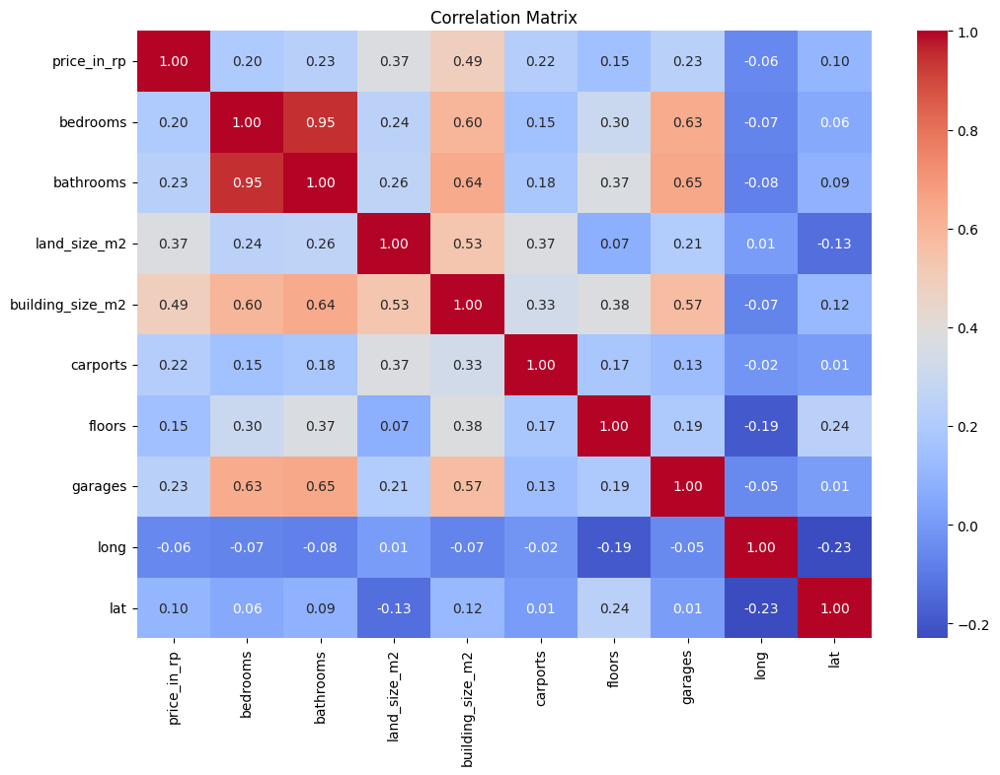

In [ ]:

# Langkah 3: Preprocessing data (contoh: menangani missing values, mengkonversi tipe data)
# df = df.fillna(0)  # Misalnya mengisi missing values dengan 0

# Langkah 4: Select numerical columns
numerical_cols = ['price_in_rp', 'bedrooms', 'bathrooms', 'land_size_m2', 'building_size_m2',
                  'carports', 'floors', 'garages', 'long', 'lat']

# Langkah 5: Compute correlation matrix
correlation_matrix = df[numerical_cols].corr()

# Plotting the correlation matrix
plt.figure(figsize=(12, 8))
sns.heatmap(correlation_matrix, annot=True, cmap='coolwarm', fmt=".2f")
plt.title('Correlation Matrix')
plt.show()

In [ ]:
df.info()

<class 'pandas.core.frame.DataFrame'>
Index: 3510 entries, 0 to 3552
Data columns (total 10 columns):
 #   Column            Non-Null Count  Dtype  
---  ------            --------------  -----  
 0   price_in_rp       3510 non-null   float64
 1   lat               3510 non-null   float64
 2   long              3510 non-null   float64
 3   bedrooms          3510 non-null   float64
 4   bathrooms         3510 non-null   float64
 5   land_size_m2      3510 non-null   float64
 6   building_size_m2  3510 non-null   float64
 7   carports          3510 non-null   float64
 8   floors            3510 non-null   float64
 9   garages           3510 non-null   float64
dtypes: float64(10)
memory usage: 301.6 KB


In [ ]:
from sklearn.preprocessing import StandardScaler

# Membuat salinan dataframe
df2 = df.copy(deep=True)

# Mengubah kolom menggunakan StandardScaler
df2['price_in_rp_scale'] = StandardScaler().fit_transform(df2[['price_in_rp']])
df2['city_encoded_scale'] = StandardScaler().fit_transform(df2[['city_encoded']])
df2['building_size_m2_scale'] = StandardScaler().fit_transform(df2[['building_size_m2']])
df2['land_size_m2_scale'] = StandardScaler().fit_transform(df2[['land_size_m2']])
df2['carports_scale'] = StandardScaler().fit_transform(df2[['carports']])
df2['garages_scale'] = StandardScaler().fit_transform(df2[['garages']])
df2['bathrooms_scale'] = StandardScaler().fit_transform(df2[['bathrooms']])
df2

,price_in_rp,city,lat,long,facilities,bedrooms,bathrooms,land_size_m2,building_size_m2,carports,...,city_encoded,furnishing_encoded,Cluster_KM,price_in_rp_scale,city_encoded_scale,building_size_m2_scale,land_size_m2_scale,carports_scale,garages_scale,bathrooms_scale
0,2.990000e+09,Bekasi,-6.223945,106.986275,"Tempat Jemuran, Jalur Telepon, Taman, Taman",4.0,4.0,239.0,272.0,0.0,...,0,3,0,-0.078027,-1.103103,0.376036,0.106179,-1.173441,-0.520653,0.479123
2,1.950000e+09,Bekasi,-6.223945,106.986275,"Jogging Track, Kolam Renang, Masjid, Taman,...",3.0,3.0,119.0,131.0,1.0,...,0,3,0,-0.152375,-1.103103,-0.215548,-0.208316,-0.219288,0.200018,0.133864
3,3.300000e+09,Bekasi,-6.223945,106.986275,"Jalur Telepon, Jogging Track, Track Lari, K...",3.0,3.0,180.0,174.0,0.0,...,0,3,0,-0.055865,-1.103103,-0.035136,-0.048448,-1.173441,0.920688,0.133864
4,4.500000e+09,Bekasi,-6.223945,106.986275,"Jogging Track, Kolam Renang, Taman, Jalur Te...",4.0,3.0,328.0,196.0,2.0,...,0,3,0,0.029921,-1.103103,0.057168,0.339429,0.734865,0.200018,0.133864
5,2.700000e+09,Bekasi,-6.223945,106.986275,"Jalur Telepon, Taman, Keamanan, Kolam Renang",3.0,3.0,136.0,200.0,2.0,...,0,2,0,-0.098759,-1.103103,0.073951,-0.163763,0.734865,0.200018,0.133864
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
3548,5.880000e+08,Tangerang,-6.296615,106.704601,"Masjid, Taman, Tempat Jemuran, Keamanan 24 ja...",2.0,1.0,72.0,36.0,1.0,...,8,1,1,-0.249742,1.506166,-0.614133,-0.331494,-0.219288,0.200018,-0.556655
3549,7.850000e+08,Tangerang,-6.283454,106.638775,"Masjid, Keamanan, Jogging Track, Taman, Tem...",3.0,2.0,85.0,60.0,1.0,...,8,3,1,-0.235659,1.506166,-0.513438,-0.297423,-0.219288,-0.520653,-0.211396
3550,7.550000e+08,Tangerang,-6.283454,106.638775,"Keamanan, Taman, Jogging Track, Tempat Jemur...",3.0,2.0,78.0,60.0,1.0,...,8,3,1,-0.237804,1.506166,-0.513438,-0.315769,-0.219288,-0.520653,-0.211396
3551,8.000000e+08,Tangerang,-6.288237,106.665859,"Tempat Jemuran, Keamanan, Keamanan 24 jam, Was...",3.0,2.0,60.0,65.0,2.0,...,8,1,1,-0.234587,1.506166,-0.492460,-0.362943,0.734865,-0.520653,-0.211396


In [ ]:
print(df2['price_in_rp_scale'].min())
print(df2['price_in_rp_scale'].max())
print(df2['land_size_m2_scale'].min())
print(df2['land_size_m2_scale'].max())
print(df2['building_size_m2_scale'].min())
print(df2['building_size_m2_scale'].max())
print(df2['city_encoded_scale'].min())
print(df2['city_encoded_scale'].max())
print(df2['carports_scale'].min())
print(df2['carports_scale'].max())
print(df2['garages_scale'].min())
print(df2['garages_scale'].max())
print(df2['bathrooms_scale'].min())
print(df2['bathrooms_scale'].max())

-0.288775252401958
41.171612032668826
-0.4887410852090448
20.446152275190723
-0.6896541179078004
24.408605012350506
-1.1031028356365824
1.5061662433668492
-1.1734407668984284
12.184700916196375
-0.5206526962475044
35.512863192664284
-0.5566552168207386
33.278775046080746


In [ ]:
from sklearn.cluster import KMeans

k = range(1,16)
inertia = []

for i in k:
    km_model = KMeans(n_clusters=i) # jumlah cluster akan di looping
    km_model.fit(df2[['price_in_rp_scale','land_size_m2_scale','building_size_m2_scale','city_encoded_scale','carports_scale','garages_scale','bathrooms_scale']])
    inertia.append(km_model.inertia_)

print(list(k))
print(inertia)

/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:8

[1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15]
[19950.000000000007, 15878.290007819276, 13006.742790133692, 10460.101272111586, 8907.539105382015, 7638.579171950913, 6699.24242798905, 5926.527668567987, 5461.9218835449765, 5015.071020627511, 4672.799249534353, 4546.306243480171, 4268.583695677779, 3984.1200186783954, 3806.006866729087]


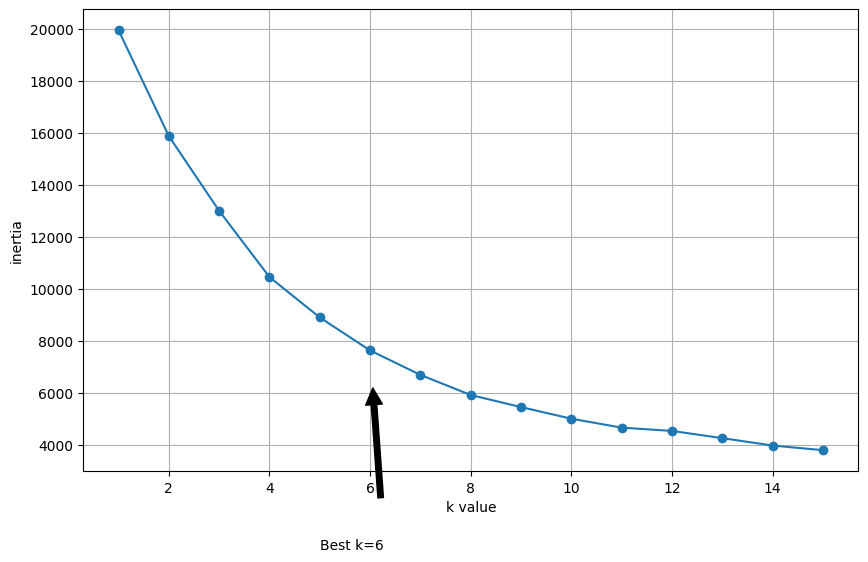

In [ ]:
plt.figure(figsize=(10,6))
plt.plot(k, inertia, marker='o')
plt.xlabel('k value')
plt.ylabel('inertia')
plt.annotate(
    'Best k=6', xy = (k[5], inertia[5]),
    xytext = (5, 8), arrowprops = dict(facecolor='black', shrink=0.2)
)
plt.grid()
plt.show()

In [ ]:
kn5 = KMeans(n_clusters=6, random_state=1)
kn5

KMeans(n_clusters=6, random_state=1)

In [ ]:
kn5.fit(df2[['price_in_rp_scale','land_size_m2_scale','building_size_m2_scale','city_encoded_scale','carports_scale','garages_scale','bathrooms_scale']])

/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(


KMeans(n_clusters=6, random_state=1)

In [ ]:
kn5.labels_

array([2, 2, 2, ..., 0, 0, 0], dtype=int32)

In [ ]:
df['Cluster_KM'] = kn5.predict(df2[['price_in_rp_scale','land_size_m2_scale','building_size_m2_scale','city_encoded_scale','carports_scale','garages_scale','bathrooms_scale']])
df2['Cluster_KM'] = kn5.predict(df2[['price_in_rp_scale','land_size_m2_scale','building_size_m2_scale','city_encoded_scale','carports_scale','garages_scale','bathrooms_scale']])

display(df)
display(df2)

,price_in_rp,city,lat,long,facilities,bedrooms,bathrooms,land_size_m2,building_size_m2,carports,certificate,electricity,property_condition,garages,furnishing,property_condition_encoded,city_encoded,furnishing_encoded,Cluster_KM
0,2.990000e+09,Bekasi,-6.223945,106.986275,"Tempat Jemuran, Jalur Telepon, Taman, Taman",4.0,4.0,239.0,272.0,0.0,shm - sertifikat hak milik,4400 mah,bagus,0.0,unfurnished,0,0,3,2
2,1.950000e+09,Bekasi,-6.223945,106.986275,"Jogging Track, Kolam Renang, Masjid, Taman,...",3.0,3.0,119.0,131.0,1.0,hgb - hak guna bangunan,2200 mah,bagus,1.0,unfurnished,0,0,3,2
3,3.300000e+09,Bekasi,-6.223945,106.986275,"Jalur Telepon, Jogging Track, Track Lari, K...",3.0,3.0,180.0,174.0,0.0,shm - sertifikat hak milik,3500 mah,bagus sekali,2.0,unfurnished,1,0,3,2
4,4.500000e+09,Bekasi,-6.223945,106.986275,"Jogging Track, Kolam Renang, Taman, Jalur Te...",4.0,3.0,328.0,196.0,2.0,shm - sertifikat hak milik,3500 mah,bagus,1.0,unfurnished,0,0,3,2
5,2.700000e+09,Bekasi,-6.223945,106.986275,"Jalur Telepon, Taman, Keamanan, Kolam Renang",3.0,3.0,136.0,200.0,2.0,shm - sertifikat hak milik,3500 mah,bagus,1.0,semi furnished,0,0,2,2
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
3548,5.880000e+08,Tangerang,-6.296615,106.704601,"Masjid, Taman, Tempat Jemuran, Keamanan 24 ja...",2.0,1.0,72.0,36.0,1.0,shm - sertifikat hak milik,1300 mah,baru,1.0,furnished,2,8,1,0
3549,7.850000e+08,Tangerang,-6.283454,106.638775,"Masjid, Keamanan, Jogging Track, Taman, Tem...",3.0,2.0,85.0,60.0,1.0,shm - sertifikat hak milik,1300 mah,baru,0.0,unfurnished,2,8,3,0
3550,7.550000e+08,Tangerang,-6.283454,106.638775,"Keamanan, Taman, Jogging Track, Tempat Jemur...",3.0,2.0,78.0,60.0,1.0,shm - sertifikat hak milik,1300 mah,baru,0.0,unfurnished,2,8,3,0
3551,8.000000e+08,Tangerang,-6.288237,106.665859,"Tempat Jemuran, Keamanan, Keamanan 24 jam, Was...",3.0,2.0,60.0,65.0,2.0,shm - sertifikat hak milik,2200 mah,baru,0.0,furnished,2,8,1,0


,price_in_rp,city,lat,long,facilities,bedrooms,bathrooms,land_size_m2,building_size_m2,carports,...,city_encoded,furnishing_encoded,Cluster_KM,price_in_rp_scale,city_encoded_scale,building_size_m2_scale,land_size_m2_scale,carports_scale,garages_scale,bathrooms_scale
0,2.990000e+09,Bekasi,-6.223945,106.986275,"Tempat Jemuran, Jalur Telepon, Taman, Taman",4.0,4.0,239.0,272.0,0.0,...,0,3,2,-0.078027,-1.103103,0.376036,0.106179,-1.173441,-0.520653,0.479123
2,1.950000e+09,Bekasi,-6.223945,106.986275,"Jogging Track, Kolam Renang, Masjid, Taman,...",3.0,3.0,119.0,131.0,1.0,...,0,3,2,-0.152375,-1.103103,-0.215548,-0.208316,-0.219288,0.200018,0.133864
3,3.300000e+09,Bekasi,-6.223945,106.986275,"Jalur Telepon, Jogging Track, Track Lari, K...",3.0,3.0,180.0,174.0,0.0,...,0,3,2,-0.055865,-1.103103,-0.035136,-0.048448,-1.173441,0.920688,0.133864
4,4.500000e+09,Bekasi,-6.223945,106.986275,"Jogging Track, Kolam Renang, Taman, Jalur Te...",4.0,3.0,328.0,196.0,2.0,...,0,3,2,0.029921,-1.103103,0.057168,0.339429,0.734865,0.200018,0.133864
5,2.700000e+09,Bekasi,-6.223945,106.986275,"Jalur Telepon, Taman, Keamanan, Kolam Renang",3.0,3.0,136.0,200.0,2.0,...,0,2,2,-0.098759,-1.103103,0.073951,-0.163763,0.734865,0.200018,0.133864
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
3548,5.880000e+08,Tangerang,-6.296615,106.704601,"Masjid, Taman, Tempat Jemuran, Keamanan 24 ja...",2.0,1.0,72.0,36.0,1.0,...,8,1,0,-0.249742,1.506166,-0.614133,-0.331494,-0.219288,0.200018,-0.556655
3549,7.850000e+08,Tangerang,-6.283454,106.638775,"Masjid, Keamanan, Jogging Track, Taman, Tem...",3.0,2.0,85.0,60.0,1.0,...,8,3,0,-0.235659,1.506166,-0.513438,-0.297423,-0.219288,-0.520653,-0.211396
3550,7.550000e+08,Tangerang,-6.283454,106.638775,"Keamanan, Taman, Jogging Track, Tempat Jemur...",3.0,2.0,78.0,60.0,1.0,...,8,3,0,-0.237804,1.506166,-0.513438,-0.315769,-0.219288,-0.520653,-0.211396
3551,8.000000e+08,Tangerang,-6.288237,106.665859,"Tempat Jemuran, Keamanan, Keamanan 24 jam, Was...",3.0,2.0,60.0,65.0,2.0,...,8,1,0,-0.234587,1.506166,-0.492460,-0.362943,0.734865,-0.520653,-0.211396


In [ ]:
df['Cluster_KM'].value_counts()

Cluster_KM
2    1646
0     822
4     341
3      36
1       4
5       1
Name: count, dtype: int64

In [ ]:
from sklearn import metrics
labels = kn5.labels_
metrics.silhouette_score(df2[['price_in_rp_scale','land_size_m2_scale','building_size_m2_scale','city_encoded_scale','carports_scale','garages_scale','bathrooms_scale']], labels, metric='euclidean')

0.4083496652281685

In [ ]:
df2[['price_in_rp_scale','land_size_m2_scale','building_size_m2_scale','city_encoded_scale','carports_scale','garages_scale','bathrooms_scale']].head()

,price_in_rp_scale,land_size_m2_scale,building_size_m2_scale,city_encoded_scale,carports_scale,garages_scale,bathrooms_scale
0,-0.078027,0.106179,0.376036,-1.103103,-1.173441,-0.520653,0.479123
2,-0.152375,-0.208316,-0.215548,-1.103103,-0.219288,0.200018,0.133864
3,-0.055865,-0.048448,-0.035136,-1.103103,-1.173441,0.920688,0.133864
4,0.029921,0.339429,0.057168,-1.103103,0.734865,0.200018,0.133864
5,-0.098759,-0.163763,0.073951,-1.103103,0.734865,0.200018,0.133864


In [ ]:
kn5_b = KMeans(n_clusters=6, random_state=1)
kn5_b.fit(df2[['price_in_rp_scale','land_size_m2_scale','building_size_m2_scale','city_encoded_scale','carports_scale','garages_scale','bathrooms_scale']])
kn5_b.labels_

/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(


array([2, 2, 2, ..., 0, 0, 0], dtype=int32)

In [ ]:
from sklearn import metrics
labels = kn5_b.labels_
metrics.silhouette_score(df2[['price_in_rp_scale','land_size_m2_scale','building_size_m2_scale','city_encoded_scale','carports_scale','garages_scale','bathrooms_scale']], labels, metric='euclidean')

0.4083496652281685

In [ ]:
df[df["Cluster_KM"]==0].head(10)

,price_in_rp,lat,long,bedrooms,bathrooms,land_size_m2,building_size_m2,carports,floors,garages,Cluster_KM
51,6.800000e+09,-6.284978,106.970127,8.0,9.0,700.0,1400.0,2.0,4.0,2.0,0
346,9.000000e+09,-6.280399,106.994535,36.0,36.0,939.0,500.0,0.0,1.0,0.0,0
522,6.000000e+09,-6.257300,106.946846,5.0,4.0,1070.0,720.0,12.0,2.0,0.0,0
590,2.250000e+10,-6.518350,106.851279,5.0,4.0,1064.0,800.0,4.0,2.0,4.0,0
594,9.500000e+09,-6.518350,106.851279,4.0,3.0,1400.0,300.0,0.0,1.0,4.0,0
629,1.800000e+10,-6.518350,106.851279,6.0,5.0,450.0,800.0,2.0,3.0,2.0,0
773,1.450000e+10,-6.518350,106.851279,4.0,4.0,886.0,500.0,3.0,2.0,0.0,0
774,1.550000e+10,-6.518350,106.851279,5.0,4.0,1118.0,600.0,2.0,2.0,2.0,0
775,2.200000e+10,-6.518350,106.851279,5.0,5.0,1050.0,1000.0,4.0,2.0,4.0,0
776,1.550000e+10,-6.518350,106.851279,3.0,3.0,1156.0,500.0,3.0,2.0,0.0,0


In [ ]:
df[df["Cluster_KM"]==1].head(10)

,price_in_rp,lat,long,bedrooms,bathrooms,land_size_m2,building_size_m2,carports,floors,garages,Cluster_KM
1,1.270000e+09,-6.223945,106.986275,3.0,2.0,55.0,69.0,1.0,2.0,0.0,1
2,1.950000e+09,-6.223945,106.986275,3.0,3.0,119.0,131.0,1.0,2.0,1.0,1
3,3.300000e+09,-6.223945,106.986275,3.0,3.0,180.0,174.0,0.0,2.0,2.0,1
5,2.700000e+09,-6.223945,106.986275,3.0,3.0,136.0,200.0,2.0,2.0,1.0,1
6,2.350000e+09,-6.223945,106.986275,2.0,2.0,144.0,144.0,1.0,2.0,1.0,1
9,2.700000e+09,-6.223945,106.986275,3.0,3.0,136.0,200.0,1.0,2.0,1.0,1
10,2.550000e+09,-6.223945,106.986275,3.0,2.0,144.0,186.0,1.0,2.0,0.0,1
11,9.520000e+08,-6.223945,106.986275,2.0,2.0,55.0,50.0,1.0,2.0,0.0,1
12,1.800000e+09,-6.223945,106.986275,2.0,1.0,119.0,82.0,1.0,2.0,1.0,1
13,2.350000e+09,-6.223945,106.986275,3.0,3.0,144.0,149.0,1.0,2.0,1.0,1


In [ ]:
df[df["Cluster_KM"]==2].head(10)

,price_in_rp,lat,long,bedrooms,bathrooms,land_size_m2,building_size_m2,carports,floors,garages,Cluster_KM
596,1.650000e+10,-6.518350,106.851279,2.0,6.0,2916.0,500.0,4.0,3.0,0.0,2
601,1.650000e+10,-6.518350,106.851279,3.0,2.0,2916.0,500.0,4.0,2.0,4.0,2
632,3.000000e+10,-6.518350,106.851279,5.0,5.0,2786.0,1500.0,1.0,2.0,1.0,2
642,3.000000e+10,-6.518350,106.851279,5.0,5.0,2786.0,1500.0,1.0,2.0,1.0,2
1332,1.390000e+10,-6.587507,106.731955,4.0,5.0,8000.0,1000.0,10.0,2.0,0.0,2
1366,4.500000e+10,-6.721369,106.944413,5.0,7.0,7400.0,1233.0,0.0,2.0,0.0,2
1369,6.000000e+09,-6.721369,106.944413,4.0,4.0,4640.0,500.0,0.0,1.0,0.0,2
1371,7.000000e+09,-6.721369,106.944413,4.0,3.0,4600.0,500.0,0.0,3.0,0.0,2
1376,5.000000e+09,-6.675820,106.921930,16.0,8.0,3033.0,500.0,0.0,1.0,10.0,2
1385,5.000000e+10,-6.599425,106.748736,4.0,2.0,5025.0,300.0,10.0,1.0,2.0,2


In [ ]:
df[df["Cluster_KM"]==3].head(10)

,price_in_rp,lat,long,bedrooms,bathrooms,land_size_m2,building_size_m2,carports,floors,garages,Cluster_KM
0,2.990000e+09,-6.223945,106.986275,4.0,4.0,239.0,272.0,0.0,2.0,0.0,3
4,4.500000e+09,-6.223945,106.986275,4.0,3.0,328.0,196.0,2.0,2.0,1.0,3
7,4.500000e+09,-6.223945,106.986275,4.0,4.0,216.0,250.0,2.0,2.0,1.0,3
16,5.360000e+09,-6.223945,106.986275,5.0,4.0,192.0,370.0,2.0,2.0,0.0,3
31,5.270000e+09,-6.284978,106.970127,4.0,3.0,192.0,307.0,2.0,3.0,0.0,3
39,4.950000e+09,-6.284978,106.970127,5.0,4.0,348.0,430.0,1.0,2.0,1.0,3
42,2.650000e+09,-6.284978,106.970127,5.0,4.0,160.0,296.0,0.0,2.0,0.0,3
49,5.750000e+09,-6.284978,106.970127,5.0,4.0,400.0,398.0,2.0,2.0,1.0,3
52,3.000000e+09,-6.284978,106.970127,4.0,5.0,250.0,400.0,1.0,1.0,1.0,3
75,3.200000e+09,-6.181752,106.973684,5.0,4.0,376.0,700.0,2.0,2.0,2.0,3


<Figure size 1200x600 with 0 Axes>

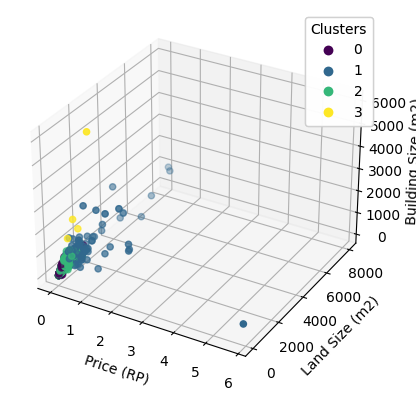

In [ ]:
import matplotlib.pyplot as plt
from mpl_toolkits.mplot3d import Axes3D
import seaborn as sns

plt.figure(figsize=(12, 6))
palette = ['blue', 'red', 'gold', 'green', 'cyan', 'brown']

# Buat plot 3D
fig = plt.figure()
ax = fig.add_subplot(111, projection='3d')

# Scatter plot
scatter = ax.scatter(df['price_in_rp'], df['land_size_m2'], df['building_size_m2'], c=df['Cluster_KM'], cmap='viridis')

# Label sumbu
ax.set_xlabel('Price (RP)')
ax.set_ylabel('Land Size (m2)')
ax.set_zlabel('Building Size (m2)')

# Tambahkan legenda
legend = ax.legend(*scatter.legend_elements(), title='Clusters', loc='upper right')
ax.add_artist(legend)

plt.show()


# Processing Data Numerik

In [ ]:
df = pd.read_csv("/content/gdrive/MyDrive/datamining/jabodetabek_house_price.csv")
print(df.columns)

Index(['url', 'price_in_rp', 'title', 'address', 'district', 'city', 'lat',
       'long', 'facilities', 'property_type', 'ads_id', 'bedrooms',
       'bathrooms', 'land_size_m2', 'building_size_m2', 'carports',
       'certificate', 'electricity', 'maid_bedrooms', 'maid_bathrooms',
       'floors', 'building_age', 'year_built', 'property_condition',
       'building_orientation', 'garages', 'furnishing'],
      dtype='object')


In [ ]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 3553 entries, 0 to 3552
Data columns (total 27 columns):
 #   Column                Non-Null Count  Dtype  
---  ------                --------------  -----  
 0   url                   3553 non-null   object 
 1   price_in_rp           3553 non-null   float64
 2   title                 3553 non-null   object 
 3   address               3553 non-null   object 
 4   district              3553 non-null   object 
 5   city                  3553 non-null   object 
 6   lat                   3553 non-null   float64
 7   long                  3553 non-null   float64
 8   facilities            3553 non-null   object 
 9   property_type         3552 non-null   object 
 10  ads_id                3549 non-null   object 
 11  bedrooms              3519 non-null   float64
 12  bathrooms             3524 non-null   float64
 13  land_size_m2          3551 non-null   float64
 14  building_size_m2      3551 non-null   float64
 15  carports             

In [ ]:
df = df.drop(["url","property_type"], axis = 1)

In [ ]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 3553 entries, 0 to 3552
Data columns (total 27 columns):
 #   Column                Non-Null Count  Dtype  
---  ------                --------------  -----  
 0   url                   3553 non-null   object 
 1   price_in_rp           3553 non-null   float64
 2   title                 3553 non-null   object 
 3   address               3553 non-null   object 
 4   district              3553 non-null   object 
 5   city                  3553 non-null   object 
 6   lat                   3553 non-null   float64
 7   long                  3553 non-null   float64
 8   facilities            3553 non-null   object 
 9   property_type         3552 non-null   object 
 10  ads_id                3549 non-null   object 
 11  bedrooms              3519 non-null   float64
 12  bathrooms             3524 non-null   float64
 13  land_size_m2          3551 non-null   float64
 14  building_size_m2      3551 non-null   float64
 15  carports             

In [ ]:
df = df.drop(["url","property_type", "maid_bedrooms","ads_id","title", "address","district","maid_bathrooms","building_orientation","floors","year_built","building_age"], axis = 1)

In [ ]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 3553 entries, 0 to 3552
Data columns (total 15 columns):
 #   Column              Non-Null Count  Dtype  
---  ------              --------------  -----  
 0   price_in_rp         3553 non-null   float64
 1   city                3553 non-null   object 
 2   lat                 3553 non-null   float64
 3   long                3553 non-null   float64
 4   facilities          3553 non-null   object 
 5   bedrooms            3519 non-null   float64
 6   bathrooms           3524 non-null   float64
 7   land_size_m2        3551 non-null   float64
 8   building_size_m2    3551 non-null   float64
 9   carports            3553 non-null   float64
 10  certificate         3412 non-null   object 
 11  electricity         3553 non-null   object 
 12  property_condition  3307 non-null   object 
 13  garages             3553 non-null   float64
 14  furnishing          3166 non-null   object 
dtypes: float64(9), object(6)
memory usage: 416.5+ KB


In [ ]:
df = df.dropna()

In [ ]:
df.isnull().sum()

price_in_rp           0
city                  0
lat                   0
long                  0
facilities            0
bedrooms              0
bathrooms             0
land_size_m2          0
building_size_m2      0
carports              0
certificate           0
electricity           0
property_condition    0
garages               0
furnishing            0
dtype: int64

In [ ]:
from sklearn.preprocessing import LabelEncoder
label_encoder = LabelEncoder()

# Ganti 'kolom1' dan 'kolom2' dengan nama kolom yang sebenarnya di DataFrame Anda
df['property_condition_encoded'] = label_encoder.fit_transform(df['property_condition'])
df['city_encoded'] = label_encoder.fit_transform(df['city'])
df['furnishing_encoded'] = label_encoder.fit_transform(df['furnishing'])

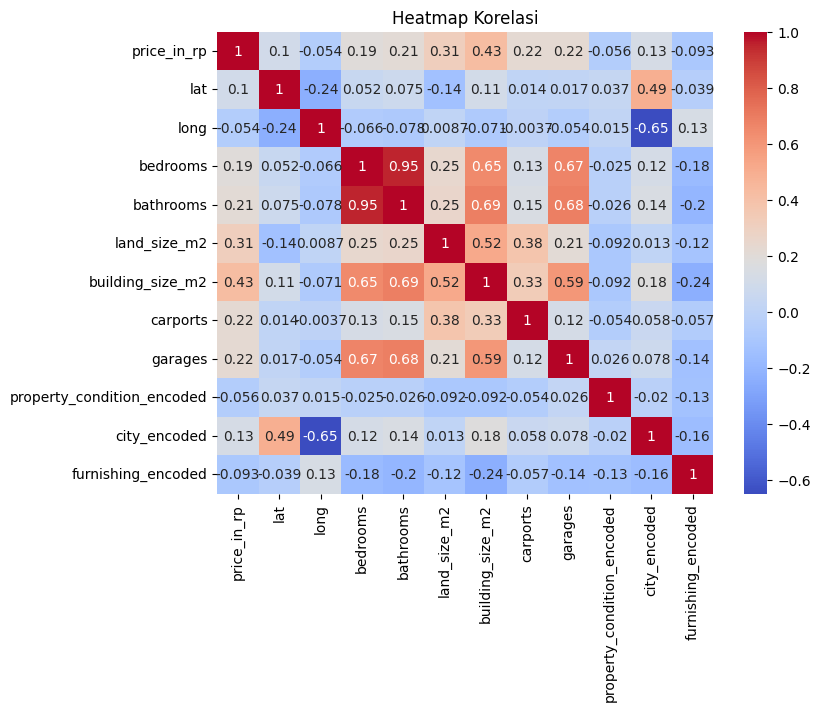

In [ ]:
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt

# Pilih hanya kolom numerik
df_numerik = df.select_dtypes(include=[np.number])

# Hitung matriks korelasi
corr_matrix = df_numerik.corr()

# Buat heatmap
plt.figure(figsize=(8, 6))
sns.heatmap(corr_matrix, annot=True, cmap='coolwarm')

# Tampilkan plot
plt.title('Heatmap Korelasi')
plt.show()


# clustering menggunakan 3 fitur (kmeans)

In [ ]:
from sklearn.preprocessing import MinMaxScaler

df2 = df.copy(deep=True)
df2['price_in_rp_scale'] = MinMaxScaler().fit_transform(df2[['price_in_rp']])
df2['city_encoded_scale'] = MinMaxScaler().fit_transform(df2[['city_encoded']])
df2['building_size_m2_scale'] = MinMaxScaler().fit_transform(df2[['building_size_m2']])
df2

,price_in_rp,city,lat,long,facilities,bedrooms,bathrooms,land_size_m2,building_size_m2,carports,...,electricity,property_condition,garages,furnishing,property_condition_encoded,city_encoded,furnishing_encoded,price_in_rp_scale,city_encoded_scale,building_size_m2_scale
0,2.990000e+09,Bekasi,-6.223945,106.986275,"Tempat Jemuran, Jalur Telepon, Taman, Taman",4.0,4.0,239.0,272.0,0.0,...,4400 mah,bagus,0.0,unfurnished,0,0,3,0.005083,0.0,0.042461
2,1.950000e+09,Bekasi,-6.223945,106.986275,"Jogging Track, Kolam Renang, Masjid, Taman,...",3.0,3.0,119.0,131.0,1.0,...,2200 mah,bagus,1.0,unfurnished,0,0,3,0.003290,0.0,0.018890
3,3.300000e+09,Bekasi,-6.223945,106.986275,"Jalur Telepon, Jogging Track, Track Lari, K...",3.0,3.0,180.0,174.0,0.0,...,3500 mah,bagus sekali,2.0,unfurnished,1,0,3,0.005618,0.0,0.026078
4,4.500000e+09,Bekasi,-6.223945,106.986275,"Jogging Track, Kolam Renang, Taman, Jalur Te...",4.0,3.0,328.0,196.0,2.0,...,3500 mah,bagus,1.0,unfurnished,0,0,3,0.007687,0.0,0.029756
5,2.700000e+09,Bekasi,-6.223945,106.986275,"Jalur Telepon, Taman, Keamanan, Kolam Renang",3.0,3.0,136.0,200.0,2.0,...,3500 mah,bagus,1.0,semi furnished,0,0,2,0.004583,0.0,0.030425
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
3548,5.880000e+08,Tangerang,-6.296615,106.704601,"Masjid, Taman, Tempat Jemuran, Keamanan 24 ja...",2.0,1.0,72.0,36.0,1.0,...,1300 mah,baru,1.0,furnished,2,8,1,0.000941,1.0,0.003009
3549,7.850000e+08,Tangerang,-6.283454,106.638775,"Masjid, Keamanan, Jogging Track, Taman, Tem...",3.0,2.0,85.0,60.0,1.0,...,1300 mah,baru,0.0,unfurnished,2,8,3,0.001281,1.0,0.007021
3550,7.550000e+08,Tangerang,-6.283454,106.638775,"Keamanan, Taman, Jogging Track, Tempat Jemur...",3.0,2.0,78.0,60.0,1.0,...,1300 mah,baru,0.0,unfurnished,2,8,3,0.001229,1.0,0.007021
3551,8.000000e+08,Tangerang,-6.288237,106.665859,"Tempat Jemuran, Keamanan, Keamanan 24 jam, Was...",3.0,2.0,60.0,65.0,2.0,...,2200 mah,baru,0.0,furnished,2,8,1,0.001307,1.0,0.007857


In [ ]:
print(df2['price_in_rp_scale'].min())
print(df2['price_in_rp_scale'].max())
print(df2['city_encoded_scale'].min())
print(df2['city_encoded_scale'].max())
print(df2['building_size_m2_scale'].min())
print(df2['building_size_m2_scale'].max())

0.0
0.9999999999999999
0.0
1.0
0.0
1.0


In [ ]:
from sklearn.cluster import KMeans

k = range(1,16)
inertia = []

for i in k:
    km_model = KMeans(n_clusters=i) # jumlah cluster akan di looping
    km_model.fit(df2[['price_in_rp_scale','city_encoded_scale','building_size_m2_scale']])
    inertia.append(km_model.inertia_)

print(list(k))
print(inertia)

/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:8

[1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15]
[424.78995608552276, 55.49641714931525, 29.929487832179078, 14.900290144662335, 10.453520241994898, 8.284819826306515, 6.5809015459457845, 5.3120381252269, 4.4586282050127, 3.5626702597504694, 3.028515195578206, 2.5975023768447256, 2.125087839520367, 1.8721791102878182, 1.6865495471903194]


/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(


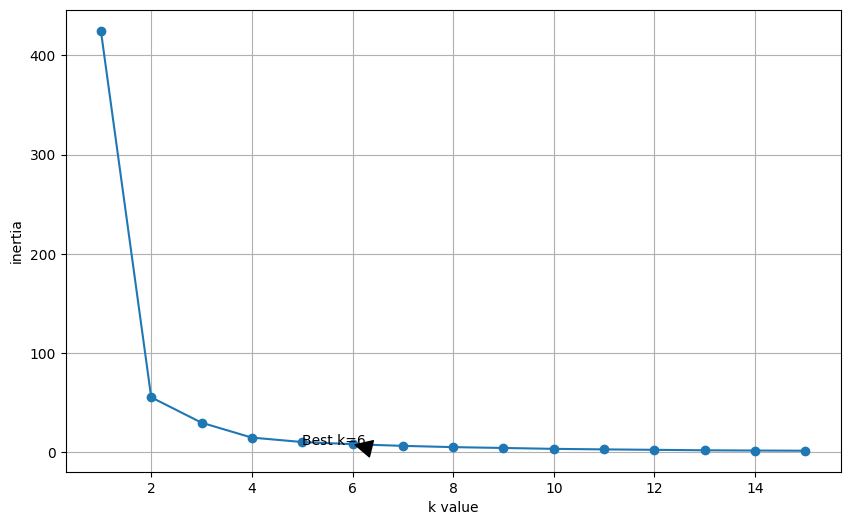

In [ ]:
plt.figure(figsize=(10,6))
plt.plot(k, inertia, marker='o')
plt.xlabel('k value')
plt.ylabel('inertia')
plt.annotate(
    'Best k=6', xy = (k[5], inertia[5]),
    xytext = (5, 8), arrowprops = dict(facecolor='black', shrink=0.2)
)
plt.grid()
plt.show()

In [ ]:
kn5 = KMeans(n_clusters=4, random_state=1)
kn5

KMeans(n_clusters=4, random_state=1)

In [ ]:
kn5.fit(df2[['price_in_rp_scale','city_encoded_scale','building_size_m2_scale']])

/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(


KMeans(n_clusters=4, random_state=1)

In [ ]:
kn5.labels_

array([0, 0, 0, ..., 1, 1, 1], dtype=int32)

In [ ]:
df['Cluster_KM'] = kn5.predict(df2[['price_in_rp_scale','city_encoded_scale','building_size_m2_scale']])
df2['Cluster_KM'] = kn5.predict(df2[['price_in_rp_scale','city_encoded_scale','building_size_m2_scale']])

display(df)
display(df2)

,price_in_rp,city,lat,long,facilities,bedrooms,bathrooms,land_size_m2,building_size_m2,carports,certificate,electricity,property_condition,garages,furnishing,property_condition_encoded,city_encoded,furnishing_encoded,Cluster_KM
0,2.990000e+09,Bekasi,-6.223945,106.986275,"Tempat Jemuran, Jalur Telepon, Taman, Taman",4.0,4.0,239.0,272.0,0.0,shm - sertifikat hak milik,4400 mah,bagus,0.0,unfurnished,0,0,3,0
2,1.950000e+09,Bekasi,-6.223945,106.986275,"Jogging Track, Kolam Renang, Masjid, Taman,...",3.0,3.0,119.0,131.0,1.0,hgb - hak guna bangunan,2200 mah,bagus,1.0,unfurnished,0,0,3,0
3,3.300000e+09,Bekasi,-6.223945,106.986275,"Jalur Telepon, Jogging Track, Track Lari, K...",3.0,3.0,180.0,174.0,0.0,shm - sertifikat hak milik,3500 mah,bagus sekali,2.0,unfurnished,1,0,3,0
4,4.500000e+09,Bekasi,-6.223945,106.986275,"Jogging Track, Kolam Renang, Taman, Jalur Te...",4.0,3.0,328.0,196.0,2.0,shm - sertifikat hak milik,3500 mah,bagus,1.0,unfurnished,0,0,3,0
5,2.700000e+09,Bekasi,-6.223945,106.986275,"Jalur Telepon, Taman, Keamanan, Kolam Renang",3.0,3.0,136.0,200.0,2.0,shm - sertifikat hak milik,3500 mah,bagus,1.0,semi furnished,0,0,2,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
3548,5.880000e+08,Tangerang,-6.296615,106.704601,"Masjid, Taman, Tempat Jemuran, Keamanan 24 ja...",2.0,1.0,72.0,36.0,1.0,shm - sertifikat hak milik,1300 mah,baru,1.0,furnished,2,8,1,1
3549,7.850000e+08,Tangerang,-6.283454,106.638775,"Masjid, Keamanan, Jogging Track, Taman, Tem...",3.0,2.0,85.0,60.0,1.0,shm - sertifikat hak milik,1300 mah,baru,0.0,unfurnished,2,8,3,1
3550,7.550000e+08,Tangerang,-6.283454,106.638775,"Keamanan, Taman, Jogging Track, Tempat Jemur...",3.0,2.0,78.0,60.0,1.0,shm - sertifikat hak milik,1300 mah,baru,0.0,unfurnished,2,8,3,1
3551,8.000000e+08,Tangerang,-6.288237,106.665859,"Tempat Jemuran, Keamanan, Keamanan 24 jam, Was...",3.0,2.0,60.0,65.0,2.0,shm - sertifikat hak milik,2200 mah,baru,0.0,furnished,2,8,1,1


,price_in_rp,city,lat,long,facilities,bedrooms,bathrooms,land_size_m2,building_size_m2,carports,...,property_condition,garages,furnishing,property_condition_encoded,city_encoded,furnishing_encoded,price_in_rp_scale,city_encoded_scale,building_size_m2_scale,Cluster_KM
0,2.990000e+09,Bekasi,-6.223945,106.986275,"Tempat Jemuran, Jalur Telepon, Taman, Taman",4.0,4.0,239.0,272.0,0.0,...,bagus,0.0,unfurnished,0,0,3,0.005083,0.0,0.042461,0
2,1.950000e+09,Bekasi,-6.223945,106.986275,"Jogging Track, Kolam Renang, Masjid, Taman,...",3.0,3.0,119.0,131.0,1.0,...,bagus,1.0,unfurnished,0,0,3,0.003290,0.0,0.018890,0
3,3.300000e+09,Bekasi,-6.223945,106.986275,"Jalur Telepon, Jogging Track, Track Lari, K...",3.0,3.0,180.0,174.0,0.0,...,bagus sekali,2.0,unfurnished,1,0,3,0.005618,0.0,0.026078,0
4,4.500000e+09,Bekasi,-6.223945,106.986275,"Jogging Track, Kolam Renang, Taman, Jalur Te...",4.0,3.0,328.0,196.0,2.0,...,bagus,1.0,unfurnished,0,0,3,0.007687,0.0,0.029756,0
5,2.700000e+09,Bekasi,-6.223945,106.986275,"Jalur Telepon, Taman, Keamanan, Kolam Renang",3.0,3.0,136.0,200.0,2.0,...,bagus,1.0,semi furnished,0,0,2,0.004583,0.0,0.030425,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
3548,5.880000e+08,Tangerang,-6.296615,106.704601,"Masjid, Taman, Tempat Jemuran, Keamanan 24 ja...",2.0,1.0,72.0,36.0,1.0,...,baru,1.0,furnished,2,8,1,0.000941,1.0,0.003009,1
3549,7.850000e+08,Tangerang,-6.283454,106.638775,"Masjid, Keamanan, Jogging Track, Taman, Tem...",3.0,2.0,85.0,60.0,1.0,...,baru,0.0,unfurnished,2,8,3,0.001281,1.0,0.007021,1
3550,7.550000e+08,Tangerang,-6.283454,106.638775,"Keamanan, Taman, Jogging Track, Tempat Jemur...",3.0,2.0,78.0,60.0,1.0,...,baru,0.0,unfurnished,2,8,3,0.001229,1.0,0.007021,1
3551,8.000000e+08,Tangerang,-6.288237,106.665859,"Tempat Jemuran, Keamanan, Keamanan 24 jam, Was...",3.0,2.0,60.0,65.0,2.0,...,baru,0.0,furnished,2,8,1,0.001307,1.0,0.007857,1


In [ ]:
df['Cluster_KM'].value_counts()

Cluster_KM
0    1195
1     759
2     578
3     318
Name: count, dtype: int64

In [ ]:
from sklearn import metrics
labels = kn5.labels_
metrics.silhouette_score(df2[['price_in_rp_scale','city_encoded_scale','building_size_m2_scale']], labels, metric='euclidean')

0.6991632229220253

In [ ]:
df2[['price_in_rp_scale','city_encoded_scale','building_size_m2_scale']].head()

,price_in_rp_scale,city_encoded_scale,building_size_m2_scale
0,0.005083,0.0,0.042461
2,0.003290,0.0,0.018890
3,0.005618,0.0,0.026078
4,0.007687,0.0,0.029756
5,0.004583,0.0,0.030425


In [ ]:
kn5_b = KMeans(n_clusters=4, random_state=1)
kn5_b.fit(df2[['price_in_rp_scale','city_encoded_scale','building_size_m2_scale']])
kn5_b.labels_

/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(


array([0, 0, 0, ..., 1, 1, 1], dtype=int32)

In [ ]:
from sklearn import metrics
labels = kn5_b.labels_
metrics.silhouette_score(df2[['price_in_rp_scale','city_encoded_scale','building_size_m2_scale']], labels, metric='euclidean')

0.6991632229220253

<Figure size 1200x600 with 0 Axes>

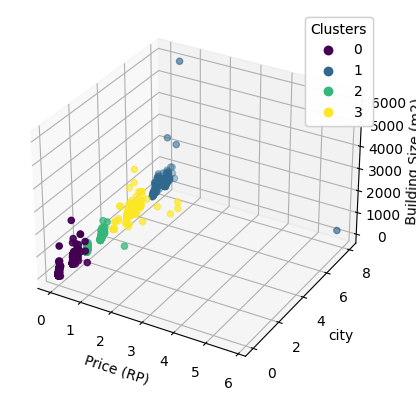

In [ ]:
import matplotlib.pyplot as plt
from mpl_toolkits.mplot3d import Axes3D
import seaborn as sns

plt.figure(figsize=(12, 6))
palette = ['blue', 'red', 'yellow', 'green']

# Buat plot 3D
fig = plt.figure()
ax = fig.add_subplot(111, projection='3d')

# Scatter plot
scatter = ax.scatter(df['price_in_rp'], df['city_encoded'], df['building_size_m2'], c=df['Cluster_KM'], cmap='viridis')

# Label sumbu
ax.set_xlabel('Price (RP)')
ax.set_ylabel('city')
ax.set_zlabel('Building Size (m2)')

# Tambahkan legenda
legend = ax.legend(*scatter.legend_elements(), title='Clusters', loc='upper right')
ax.add_artist(legend)

plt.show()


In [ ]:
cluster_1 = df[['lat','long']][df["Cluster_KM"]==0].values.tolist()
cluster_2 = df[['lat','long']][df["Cluster_KM"]==1].values.tolist()
cluster_3 = df[['lat','long']][df["Cluster_KM"]==2].values.tolist()
cluster_4 = df[['lat','long']][df["Cluster_KM"]==3].values.tolist()
cluster_5 = df[['lat','long']][df["Cluster_KM"]==4].values.tolist()
cluster_6 = df[['lat','long']][df["Cluster_KM"]==5].values.tolist()

In [ ]:
import folium
from folium import plugins
map = folium.Map(location = [-2.548926, 118.0148634], zoom_start = 10, title = "openstreetmap")
map

In [ ]:
for i in cluster_1 :
  folium.CircleMarker(i,radius =2, color = "blue").add_to(map)
for i in cluster_2 :
  folium.CircleMarker(i,radius =2, color = "red").add_to(map)
for i in cluster_3 :
  folium.CircleMarker(i,radius =2, color = "yellow").add_to(map)
for i in cluster_4 :
  folium.CircleMarker(i,radius =2, color = "green").add_to(map)
for i in cluster_5 :
  folium.CircleMarker(i,radius =2, color = "gray").add_to(map)
for i in cluster_6 :
  folium.CircleMarker(i,radius =2, color = "brown").add_to(map)
map

# clustering menggunakan 4 fitur (kmeans)





In [ ]:
from sklearn.preprocessing import MinMaxScaler

df2 = df.copy(deep=True)
df2['price_in_rp_scale'] = MinMaxScaler().fit_transform(df2[['price_in_rp']])
df2['city_encoded_scale'] = MinMaxScaler().fit_transform(df2[['city_encoded']])
df2['building_size_m2_scale'] = MinMaxScaler().fit_transform(df2[['building_size_m2']])
df2['land_size_m2_scale'] = MinMaxScaler().fit_transform(df2[['land_size_m2']])
df2.head()




,price_in_rp,city,lat,long,facilities,bedrooms,bathrooms,land_size_m2,building_size_m2,carports,...,garages,furnishing,property_condition_encoded,city_encoded,furnishing_encoded,Cluster_KM,price_in_rp_scale,city_encoded_scale,building_size_m2_scale,land_size_m2_scale
0,2.990000e+09,Bekasi,-6.223945,106.986275,"Tempat Jemuran, Jalur Telepon, Taman, Taman",4.0,4.0,239.0,272.0,0.0,...,0.0,unfurnished,0,0,3,1,0.005083,0.0,0.042461,0.028418
2,1.950000e+09,Bekasi,-6.223945,106.986275,"Jogging Track, Kolam Renang, Masjid, Taman,...",3.0,3.0,119.0,131.0,1.0,...,1.0,unfurnished,0,0,3,1,0.003290,0.0,0.018890,0.013395
3,3.300000e+09,Bekasi,-6.223945,106.986275,"Jalur Telepon, Jogging Track, Track Lari, K...",3.0,3.0,180.0,174.0,0.0,...,2.0,unfurnished,1,0,3,1,0.005618,0.0,0.026078,0.021032
4,4.500000e+09,Bekasi,-6.223945,106.986275,"Jogging Track, Kolam Renang, Taman, Jalur Te...",4.0,3.0,328.0,196.0,2.0,...,1.0,unfurnished,0,0,3,1,0.007687,0.0,0.029756,0.039559
5,2.700000e+09,Bekasi,-6.223945,106.986275,"Jalur Telepon, Taman, Keamanan, Kolam Renang",3.0,3.0,136.0,200.0,2.0,...,1.0,semi furnished,0,0,2,1,0.004583,0.0,0.030425,0.015523


In [ ]:
print(df2['price_in_rp_scale'].min())
print(df2['price_in_rp_scale'].max())
print(df2['land_size_m2_scale'].min())
print(df2['land_size_m2_scale'].max())
print(df2['building_size_m2_scale'].min())
print(df2['building_size_m2_scale'].max())
print(df2['city_encoded_scale'].min())
print(df2['city_encoded_scale'].max())

0.0
0.9999999999999999
0.0
0.9999999999999998
0.0
1.0
0.0
1.0


In [ ]:
from sklearn.cluster import KMeans

k = range(1,16)
inertia = []

for i in k:
    km_model = KMeans(n_clusters=i) # jumlah cluster akan di looping
    km_model.fit(df2[['price_in_rp_scale','land_size_m2_scale','building_size_m2_scale','city_encoded_scale']])
    inertia.append(km_model.inertia_)

print(list(k))
print(inertia)

/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:8

[1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15]
[431.2928003609903, 61.982248465198495, 36.358132709177255, 21.235764084458182, 16.680615111425553, 12.912816501376561, 10.638237065256527, 8.87732076102963, 7.5640399916373795, 6.579641197135571, 5.729810914383313, 4.866043079791455, 4.156860572731485, 3.823497136296196, 3.534941680931325]


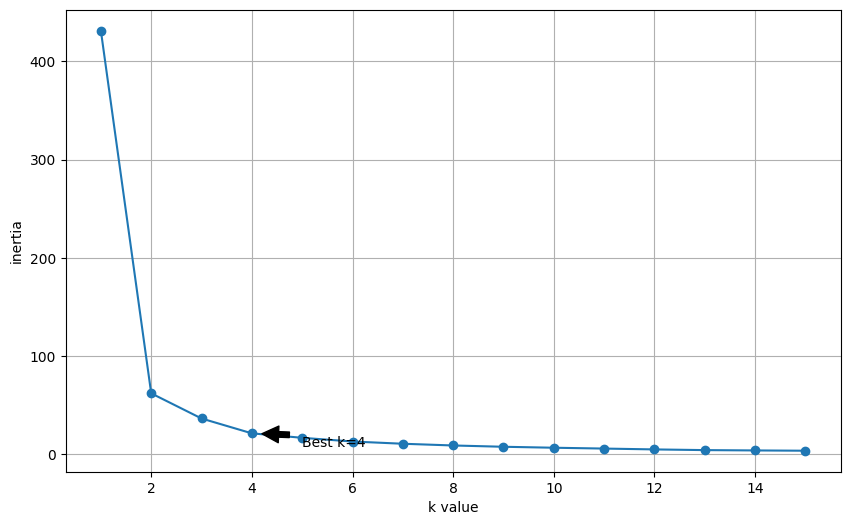

In [ ]:
plt.figure(figsize=(10,6))
plt.plot(k, inertia, marker='o')
plt.xlabel('k value')
plt.ylabel('inertia')
plt.annotate(
    'Best k=4', xy = (k[3], inertia[3]),
    xytext = (5, 8), arrowprops = dict(facecolor='black', shrink=0.2)
)
plt.grid()
plt.show()

In [ ]:
kn5 = KMeans(n_clusters=4, random_state=1)
kn5

KMeans(n_clusters=4, random_state=1)

In [ ]:
kn5.fit(df2[['price_in_rp_scale','land_size_m2_scale','building_size_m2_scale','city_encoded_scale']])

/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(


KMeans(n_clusters=4, random_state=1)

In [ ]:
kn5.labels_

array([0, 0, 0, ..., 1, 1, 1], dtype=int32)

In [ ]:
df['Cluster_KM'] = kn5.predict(df2[['price_in_rp_scale','land_size_m2_scale','building_size_m2_scale','city_encoded_scale']])
df2['Cluster_KM'] = kn5.predict(df2[['price_in_rp_scale','land_size_m2_scale','building_size_m2_scale','city_encoded_scale']])

display(df)
display(df2)

,price_in_rp,city,lat,long,facilities,bedrooms,bathrooms,land_size_m2,building_size_m2,carports,certificate,electricity,property_condition,garages,furnishing,property_condition_encoded,city_encoded,furnishing_encoded,Cluster_KM
0,2.990000e+09,Bekasi,-6.223945,106.986275,"Tempat Jemuran, Jalur Telepon, Taman, Taman",4.0,4.0,239.0,272.0,0.0,shm - sertifikat hak milik,4400 mah,bagus,0.0,unfurnished,0,0,3,0
2,1.950000e+09,Bekasi,-6.223945,106.986275,"Jogging Track, Kolam Renang, Masjid, Taman,...",3.0,3.0,119.0,131.0,1.0,hgb - hak guna bangunan,2200 mah,bagus,1.0,unfurnished,0,0,3,0
3,3.300000e+09,Bekasi,-6.223945,106.986275,"Jalur Telepon, Jogging Track, Track Lari, K...",3.0,3.0,180.0,174.0,0.0,shm - sertifikat hak milik,3500 mah,bagus sekali,2.0,unfurnished,1,0,3,0
4,4.500000e+09,Bekasi,-6.223945,106.986275,"Jogging Track, Kolam Renang, Taman, Jalur Te...",4.0,3.0,328.0,196.0,2.0,shm - sertifikat hak milik,3500 mah,bagus,1.0,unfurnished,0,0,3,0
5,2.700000e+09,Bekasi,-6.223945,106.986275,"Jalur Telepon, Taman, Keamanan, Kolam Renang",3.0,3.0,136.0,200.0,2.0,shm - sertifikat hak milik,3500 mah,bagus,1.0,semi furnished,0,0,2,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
3548,5.880000e+08,Tangerang,-6.296615,106.704601,"Masjid, Taman, Tempat Jemuran, Keamanan 24 ja...",2.0,1.0,72.0,36.0,1.0,shm - sertifikat hak milik,1300 mah,baru,1.0,furnished,2,8,1,1
3549,7.850000e+08,Tangerang,-6.283454,106.638775,"Masjid, Keamanan, Jogging Track, Taman, Tem...",3.0,2.0,85.0,60.0,1.0,shm - sertifikat hak milik,1300 mah,baru,0.0,unfurnished,2,8,3,1
3550,7.550000e+08,Tangerang,-6.283454,106.638775,"Keamanan, Taman, Jogging Track, Tempat Jemur...",3.0,2.0,78.0,60.0,1.0,shm - sertifikat hak milik,1300 mah,baru,0.0,unfurnished,2,8,3,1
3551,8.000000e+08,Tangerang,-6.288237,106.665859,"Tempat Jemuran, Keamanan, Keamanan 24 jam, Was...",3.0,2.0,60.0,65.0,2.0,shm - sertifikat hak milik,2200 mah,baru,0.0,furnished,2,8,1,1


,price_in_rp,city,lat,long,facilities,bedrooms,bathrooms,land_size_m2,building_size_m2,carports,...,garages,furnishing,property_condition_encoded,city_encoded,furnishing_encoded,Cluster_KM,price_in_rp_scale,city_encoded_scale,building_size_m2_scale,land_size_m2_scale
0,2.990000e+09,Bekasi,-6.223945,106.986275,"Tempat Jemuran, Jalur Telepon, Taman, Taman",4.0,4.0,239.0,272.0,0.0,...,0.0,unfurnished,0,0,3,0,0.005083,0.0,0.042461,0.028418
2,1.950000e+09,Bekasi,-6.223945,106.986275,"Jogging Track, Kolam Renang, Masjid, Taman,...",3.0,3.0,119.0,131.0,1.0,...,1.0,unfurnished,0,0,3,0,0.003290,0.0,0.018890,0.013395
3,3.300000e+09,Bekasi,-6.223945,106.986275,"Jalur Telepon, Jogging Track, Track Lari, K...",3.0,3.0,180.0,174.0,0.0,...,2.0,unfurnished,1,0,3,0,0.005618,0.0,0.026078,0.021032
4,4.500000e+09,Bekasi,-6.223945,106.986275,"Jogging Track, Kolam Renang, Taman, Jalur Te...",4.0,3.0,328.0,196.0,2.0,...,1.0,unfurnished,0,0,3,0,0.007687,0.0,0.029756,0.039559
5,2.700000e+09,Bekasi,-6.223945,106.986275,"Jalur Telepon, Taman, Keamanan, Kolam Renang",3.0,3.0,136.0,200.0,2.0,...,1.0,semi furnished,0,0,2,0,0.004583,0.0,0.030425,0.015523
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
3548,5.880000e+08,Tangerang,-6.296615,106.704601,"Masjid, Taman, Tempat Jemuran, Keamanan 24 ja...",2.0,1.0,72.0,36.0,1.0,...,1.0,furnished,2,8,1,1,0.000941,1.0,0.003009,0.007511
3549,7.850000e+08,Tangerang,-6.283454,106.638775,"Masjid, Keamanan, Jogging Track, Taman, Tem...",3.0,2.0,85.0,60.0,1.0,...,0.0,unfurnished,2,8,3,1,0.001281,1.0,0.007021,0.009139
3550,7.550000e+08,Tangerang,-6.283454,106.638775,"Keamanan, Taman, Jogging Track, Tempat Jemur...",3.0,2.0,78.0,60.0,1.0,...,0.0,unfurnished,2,8,3,1,0.001229,1.0,0.007021,0.008262
3551,8.000000e+08,Tangerang,-6.288237,106.665859,"Tempat Jemuran, Keamanan, Keamanan 24 jam, Was...",3.0,2.0,60.0,65.0,2.0,...,0.0,furnished,2,8,1,1,0.001307,1.0,0.007857,0.006009


In [ ]:
df['Cluster_KM'].value_counts()

Cluster_KM
0    1195
1     759
2     578
3     318
Name: count, dtype: int64

In [ ]:
from sklearn import metrics
labels = kn5.labels_
metrics.silhouette_score(df2[['price_in_rp_scale','land_size_m2_scale','building_size_m2_scale','city_encoded_scale']], labels, metric='euclidean')

0.6668548767987513

In [ ]:
df2[['price_in_rp_scale','land_size_m2_scale','building_size_m2_scale','city_encoded_scale']].head()

,price_in_rp_scale,land_size_m2_scale,building_size_m2_scale,city_encoded_scale
0,0.005083,0.028418,0.042461,0.0
2,0.003290,0.013395,0.018890,0.0
3,0.005618,0.021032,0.026078,0.0
4,0.007687,0.039559,0.029756,0.0
5,0.004583,0.015523,0.030425,0.0


In [ ]:
kn5_b = KMeans(n_clusters=6, random_state=1)
kn5_b.fit(df2[['price_in_rp_scale','land_size_m2_scale','building_size_m2_scale','city_encoded_scale']])
kn5_b.labels_

/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(


array([4, 4, 4, ..., 1, 1, 1], dtype=int32)

In [ ]:
from sklearn import metrics
labels = kn5_b.labels_
metrics.silhouette_score(df2[['price_in_rp_scale','land_size_m2_scale','building_size_m2_scale','city_encoded_scale']], labels, metric='euclidean')

0.7406248706294323

<Figure size 1200x600 with 0 Axes>

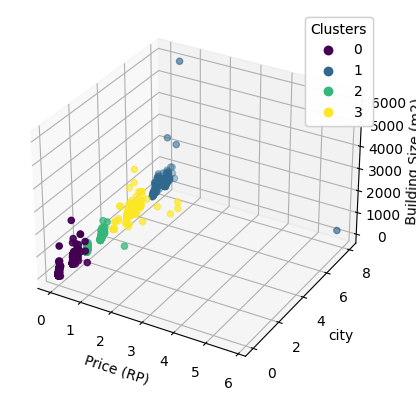

In [ ]:
import matplotlib.pyplot as plt
from mpl_toolkits.mplot3d import Axes3D
import seaborn as sns

plt.figure(figsize=(12, 6))
palette = ['blue', 'red', 'gold', 'green']

# Buat plot 3D
fig = plt.figure()
ax = fig.add_subplot(111, projection='3d')

# Scatter plot
scatter = ax.scatter(df['price_in_rp'], df['city_encoded'], df['building_size_m2'], c=df['Cluster_KM'], cmap='viridis')

# Label sumbu
ax.set_xlabel('Price (RP)')
ax.set_ylabel('city')
ax.set_zlabel('Building Size (m2)')

# Tambahkan legenda
legend = ax.legend(*scatter.legend_elements(), title='Clusters', loc='upper right')
ax.add_artist(legend)

plt.show()


In [ ]:
df

,price_in_rp,city,lat,long,facilities,bedrooms,bathrooms,land_size_m2,building_size_m2,carports,certificate,electricity,property_condition,garages,furnishing,property_condition_encoded,city_encoded,furnishing_encoded,Cluster_KM
0,2.990000e+09,Bekasi,-6.223945,106.986275,"Tempat Jemuran, Jalur Telepon, Taman, Taman",4.0,4.0,239.0,272.0,0.0,shm - sertifikat hak milik,4400 mah,bagus,0.0,unfurnished,0,0,3,0
2,1.950000e+09,Bekasi,-6.223945,106.986275,"Jogging Track, Kolam Renang, Masjid, Taman,...",3.0,3.0,119.0,131.0,1.0,hgb - hak guna bangunan,2200 mah,bagus,1.0,unfurnished,0,0,3,0
3,3.300000e+09,Bekasi,-6.223945,106.986275,"Jalur Telepon, Jogging Track, Track Lari, K...",3.0,3.0,180.0,174.0,0.0,shm - sertifikat hak milik,3500 mah,bagus sekali,2.0,unfurnished,1,0,3,0
4,4.500000e+09,Bekasi,-6.223945,106.986275,"Jogging Track, Kolam Renang, Taman, Jalur Te...",4.0,3.0,328.0,196.0,2.0,shm - sertifikat hak milik,3500 mah,bagus,1.0,unfurnished,0,0,3,0
5,2.700000e+09,Bekasi,-6.223945,106.986275,"Jalur Telepon, Taman, Keamanan, Kolam Renang",3.0,3.0,136.0,200.0,2.0,shm - sertifikat hak milik,3500 mah,bagus,1.0,semi furnished,0,0,2,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
3548,5.880000e+08,Tangerang,-6.296615,106.704601,"Masjid, Taman, Tempat Jemuran, Keamanan 24 ja...",2.0,1.0,72.0,36.0,1.0,shm - sertifikat hak milik,1300 mah,baru,1.0,furnished,2,8,1,1
3549,7.850000e+08,Tangerang,-6.283454,106.638775,"Masjid, Keamanan, Jogging Track, Taman, Tem...",3.0,2.0,85.0,60.0,1.0,shm - sertifikat hak milik,1300 mah,baru,0.0,unfurnished,2,8,3,1
3550,7.550000e+08,Tangerang,-6.283454,106.638775,"Keamanan, Taman, Jogging Track, Tempat Jemur...",3.0,2.0,78.0,60.0,1.0,shm - sertifikat hak milik,1300 mah,baru,0.0,unfurnished,2,8,3,1
3551,8.000000e+08,Tangerang,-6.288237,106.665859,"Tempat Jemuran, Keamanan, Keamanan 24 jam, Was...",3.0,2.0,60.0,65.0,2.0,shm - sertifikat hak milik,2200 mah,baru,0.0,furnished,2,8,1,1


<Figure size 1200x600 with 0 Axes>

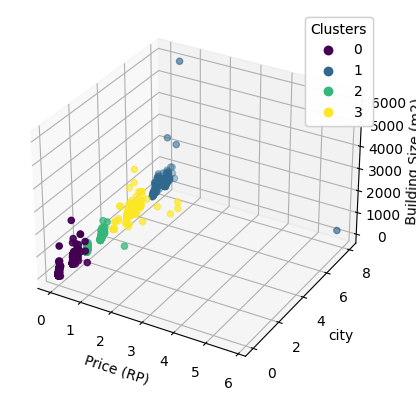

In [ ]:
import matplotlib.pyplot as plt
from mpl_toolkits.mplot3d import Axes3D
import seaborn as sns

plt.figure(figsize=(12, 6))
palette = ['blue', 'red', 'gold', 'green']

# Buat plot 3D
fig = plt.figure()
ax = fig.add_subplot(111, projection='3d')

# Scatter plot
scatter = ax.scatter(df['price_in_rp'], df['city_encoded'], df['building_size_m2'], c=df['Cluster_KM'], cmap='viridis')

# Label sumbu
ax.set_xlabel('Price (RP)')
ax.set_ylabel('city')
ax.set_zlabel('Building Size (m2)')

# Tambahkan legenda
legend = ax.legend(*scatter.legend_elements(), title='Clusters', loc='upper right')
ax.add_artist(legend)

plt.show()


In [ ]:
cluster_1 = df[['lat','long']][df["Cluster_KM"]==0].values.tolist()
cluster_2 = df[['lat','long']][df["Cluster_KM"]==1].values.tolist()
cluster_3 = df[['lat','long']][df["Cluster_KM"]==2].values.tolist()
cluster_4 = df[['lat','long']][df["Cluster_KM"]==3].values.tolist()

In [ ]:
import folium
from folium import plugins
map = folium.Map(location = [-2.548926, 118.0148634], zoom_start = 10, title = "openstreetmap")
map

In [ ]:
for i in cluster_1 :
  folium.CircleMarker(i,radius =2, color = "blue").add_to(map)
for i in cluster_2 :
  folium.CircleMarker(i,radius =2, color = "red").add_to(map)
for i in cluster_3 :
  folium.CircleMarker(i,radius =2, color = "yellow").add_to(map)
for i in cluster_4 :
  folium.CircleMarker(i,radius =2, color = "green").add_to(map)
map

# clustering menggunakan 5 fitur (kmeans)






In [ ]:
from sklearn.preprocessing import MinMaxScaler

df2 = df.copy(deep=True)
df2['price_in_rp_scale'] = MinMaxScaler().fit_transform(df2[['price_in_rp']])
df2['city_encoded_scale'] = MinMaxScaler().fit_transform(df2[['city_encoded']])
df2['building_size_m2_scale'] = MinMaxScaler().fit_transform(df2[['building_size_m2']])
df2['land_size_m2_scale'] = MinMaxScaler().fit_transform(df2[['land_size_m2']])
df2['carports_scale'] = MinMaxScaler().fit_transform(df2[['carports']])
df2.head()




,price_in_rp,city,lat,long,facilities,bedrooms,bathrooms,land_size_m2,building_size_m2,carports,...,furnishing,property_condition_encoded,city_encoded,furnishing_encoded,Cluster_KM,price_in_rp_scale,city_encoded_scale,building_size_m2_scale,land_size_m2_scale,carports_scale
0,2.990000e+09,Bekasi,-6.223945,106.986275,"Tempat Jemuran, Jalur Telepon, Taman, Taman",4.0,4.0,239.0,272.0,0.0,...,unfurnished,0,0,3,0,0.005083,0.0,0.042461,0.028418,0.000000
2,1.950000e+09,Bekasi,-6.223945,106.986275,"Jogging Track, Kolam Renang, Masjid, Taman,...",3.0,3.0,119.0,131.0,1.0,...,unfurnished,0,0,3,0,0.003290,0.0,0.018890,0.013395,0.071429
3,3.300000e+09,Bekasi,-6.223945,106.986275,"Jalur Telepon, Jogging Track, Track Lari, K...",3.0,3.0,180.0,174.0,0.0,...,unfurnished,1,0,3,0,0.005618,0.0,0.026078,0.021032,0.000000
4,4.500000e+09,Bekasi,-6.223945,106.986275,"Jogging Track, Kolam Renang, Taman, Jalur Te...",4.0,3.0,328.0,196.0,2.0,...,unfurnished,0,0,3,0,0.007687,0.0,0.029756,0.039559,0.142857
5,2.700000e+09,Bekasi,-6.223945,106.986275,"Jalur Telepon, Taman, Keamanan, Kolam Renang",3.0,3.0,136.0,200.0,2.0,...,semi furnished,0,0,2,0,0.004583,0.0,0.030425,0.015523,0.142857


In [ ]:
print(df2['price_in_rp_scale'].min())
print(df2['price_in_rp_scale'].max())
print(df2['land_size_m2_scale'].min())
print(df2['land_size_m2_scale'].max())
print(df2['building_size_m2_scale'].min())
print(df2['building_size_m2_scale'].max())
print(df2['city_encoded_scale'].min())
print(df2['city_encoded_scale'].max())
print(df2['carports_scale'].min())
print(df2['carports_scale'].max())

0.0
0.9999999999999999
0.0
0.9999999999999998
0.0
1.0
0.0
1.0
0.0
1.0


In [ ]:
from sklearn.cluster import KMeans

k = range(1,16)
inertia = []

for i in k:
    km_model = KMeans(n_clusters=i) # jumlah cluster akan di looping
    km_model.fit(df2[['price_in_rp_scale','land_size_m2_scale','building_size_m2_scale','city_encoded_scale','carports_scale']])
    inertia.append(km_model.inertia_)

print(list(k))
print(inertia)

/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:8

[1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15]
[447.2645601175239, 77.74708948093003, 52.20376057407259, 36.54502599664937, 31.142079673951137, 26.668249652612126, 23.5175534880947, 21.556534992979753, 19.68704671823425, 18.773082202748007, 17.19941750690892, 15.90609909969685, 14.699331848740986, 13.904892088104841, 12.149507068272078]


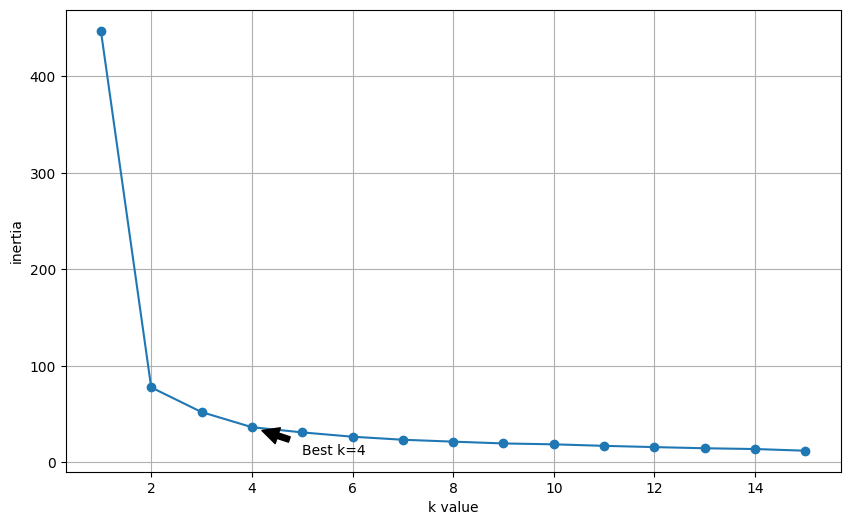

In [ ]:
plt.figure(figsize=(10,6))
plt.plot(k, inertia, marker='o')
plt.xlabel('k value')
plt.ylabel('inertia')
plt.annotate(
    'Best k=4', xy = (k[3], inertia[3]),
    xytext = (5, 8), arrowprops = dict(facecolor='black', shrink=0.2)
)
plt.grid()
plt.show()

In [ ]:
kn5 = KMeans(n_clusters=4, random_state=1)
kn5

KMeans(n_clusters=4, random_state=1)

In [ ]:
kn5.fit(df2[['price_in_rp_scale','land_size_m2_scale','building_size_m2_scale','city_encoded_scale','carports_scale']])

/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(


KMeans(n_clusters=4, random_state=1)

In [ ]:
kn5.labels_

array([0, 0, 0, ..., 1, 1, 1], dtype=int32)

In [ ]:
df['Cluster_KM'] = kn5.predict(df2[['price_in_rp_scale','land_size_m2_scale','building_size_m2_scale','city_encoded_scale','carports_scale']])
df2['Cluster_KM'] = kn5.predict(df2[['price_in_rp_scale','land_size_m2_scale','building_size_m2_scale','city_encoded_scale','carports_scale']])

display(df)
display(df2)

,price_in_rp,city,lat,long,facilities,bedrooms,bathrooms,land_size_m2,building_size_m2,carports,certificate,electricity,property_condition,garages,furnishing,property_condition_encoded,city_encoded,furnishing_encoded,Cluster_KM
0,2.990000e+09,Bekasi,-6.223945,106.986275,"Tempat Jemuran, Jalur Telepon, Taman, Taman",4.0,4.0,239.0,272.0,0.0,shm - sertifikat hak milik,4400 mah,bagus,0.0,unfurnished,0,0,3,0
2,1.950000e+09,Bekasi,-6.223945,106.986275,"Jogging Track, Kolam Renang, Masjid, Taman,...",3.0,3.0,119.0,131.0,1.0,hgb - hak guna bangunan,2200 mah,bagus,1.0,unfurnished,0,0,3,0
3,3.300000e+09,Bekasi,-6.223945,106.986275,"Jalur Telepon, Jogging Track, Track Lari, K...",3.0,3.0,180.0,174.0,0.0,shm - sertifikat hak milik,3500 mah,bagus sekali,2.0,unfurnished,1,0,3,0
4,4.500000e+09,Bekasi,-6.223945,106.986275,"Jogging Track, Kolam Renang, Taman, Jalur Te...",4.0,3.0,328.0,196.0,2.0,shm - sertifikat hak milik,3500 mah,bagus,1.0,unfurnished,0,0,3,0
5,2.700000e+09,Bekasi,-6.223945,106.986275,"Jalur Telepon, Taman, Keamanan, Kolam Renang",3.0,3.0,136.0,200.0,2.0,shm - sertifikat hak milik,3500 mah,bagus,1.0,semi furnished,0,0,2,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
3548,5.880000e+08,Tangerang,-6.296615,106.704601,"Masjid, Taman, Tempat Jemuran, Keamanan 24 ja...",2.0,1.0,72.0,36.0,1.0,shm - sertifikat hak milik,1300 mah,baru,1.0,furnished,2,8,1,1
3549,7.850000e+08,Tangerang,-6.283454,106.638775,"Masjid, Keamanan, Jogging Track, Taman, Tem...",3.0,2.0,85.0,60.0,1.0,shm - sertifikat hak milik,1300 mah,baru,0.0,unfurnished,2,8,3,1
3550,7.550000e+08,Tangerang,-6.283454,106.638775,"Keamanan, Taman, Jogging Track, Tempat Jemur...",3.0,2.0,78.0,60.0,1.0,shm - sertifikat hak milik,1300 mah,baru,0.0,unfurnished,2,8,3,1
3551,8.000000e+08,Tangerang,-6.288237,106.665859,"Tempat Jemuran, Keamanan, Keamanan 24 jam, Was...",3.0,2.0,60.0,65.0,2.0,shm - sertifikat hak milik,2200 mah,baru,0.0,furnished,2,8,1,1


,price_in_rp,city,lat,long,facilities,bedrooms,bathrooms,land_size_m2,building_size_m2,carports,...,furnishing,property_condition_encoded,city_encoded,furnishing_encoded,Cluster_KM,price_in_rp_scale,city_encoded_scale,building_size_m2_scale,land_size_m2_scale,carports_scale
0,2.990000e+09,Bekasi,-6.223945,106.986275,"Tempat Jemuran, Jalur Telepon, Taman, Taman",4.0,4.0,239.0,272.0,0.0,...,unfurnished,0,0,3,0,0.005083,0.0,0.042461,0.028418,0.000000
2,1.950000e+09,Bekasi,-6.223945,106.986275,"Jogging Track, Kolam Renang, Masjid, Taman,...",3.0,3.0,119.0,131.0,1.0,...,unfurnished,0,0,3,0,0.003290,0.0,0.018890,0.013395,0.071429
3,3.300000e+09,Bekasi,-6.223945,106.986275,"Jalur Telepon, Jogging Track, Track Lari, K...",3.0,3.0,180.0,174.0,0.0,...,unfurnished,1,0,3,0,0.005618,0.0,0.026078,0.021032,0.000000
4,4.500000e+09,Bekasi,-6.223945,106.986275,"Jogging Track, Kolam Renang, Taman, Jalur Te...",4.0,3.0,328.0,196.0,2.0,...,unfurnished,0,0,3,0,0.007687,0.0,0.029756,0.039559,0.142857
5,2.700000e+09,Bekasi,-6.223945,106.986275,"Jalur Telepon, Taman, Keamanan, Kolam Renang",3.0,3.0,136.0,200.0,2.0,...,semi furnished,0,0,2,0,0.004583,0.0,0.030425,0.015523,0.142857
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
3548,5.880000e+08,Tangerang,-6.296615,106.704601,"Masjid, Taman, Tempat Jemuran, Keamanan 24 ja...",2.0,1.0,72.0,36.0,1.0,...,furnished,2,8,1,1,0.000941,1.0,0.003009,0.007511,0.071429
3549,7.850000e+08,Tangerang,-6.283454,106.638775,"Masjid, Keamanan, Jogging Track, Taman, Tem...",3.0,2.0,85.0,60.0,1.0,...,unfurnished,2,8,3,1,0.001281,1.0,0.007021,0.009139,0.071429
3550,7.550000e+08,Tangerang,-6.283454,106.638775,"Keamanan, Taman, Jogging Track, Tempat Jemur...",3.0,2.0,78.0,60.0,1.0,...,unfurnished,2,8,3,1,0.001229,1.0,0.007021,0.008262,0.071429
3551,8.000000e+08,Tangerang,-6.288237,106.665859,"Tempat Jemuran, Keamanan, Keamanan 24 jam, Was...",3.0,2.0,60.0,65.0,2.0,...,furnished,2,8,1,1,0.001307,1.0,0.007857,0.006009,0.142857


In [ ]:
df['Cluster_KM'].value_counts()

Cluster_KM
0    1195
1     759
2     578
3     318
Name: count, dtype: int64

In [ ]:
from sklearn import metrics
labels = kn5.labels_
metrics.silhouette_score(df2[['price_in_rp_scale','land_size_m2_scale','building_size_m2_scale','city_encoded_scale','carports_scale']], labels, metric='euclidean')

0.5567363367114564

In [ ]:
df2[['price_in_rp_scale','land_size_m2_scale','building_size_m2_scale','city_encoded_scale','carports_scale']].head()

,price_in_rp_scale,land_size_m2_scale,building_size_m2_scale,city_encoded_scale,carports_scale
0,0.005083,0.028418,0.042461,0.0,0.000000
2,0.003290,0.013395,0.018890,0.0,0.071429
3,0.005618,0.021032,0.026078,0.0,0.000000
4,0.007687,0.039559,0.029756,0.0,0.142857
5,0.004583,0.015523,0.030425,0.0,0.142857


In [ ]:
kn5_b = KMeans(n_clusters=6, random_state=1)
kn5_b.fit(df2[['price_in_rp_scale','land_size_m2_scale','building_size_m2_scale','city_encoded_scale','carports_scale']])
kn5_b.labels_

/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(


array([5, 5, 5, ..., 1, 1, 1], dtype=int32)

In [ ]:
from sklearn import metrics
labels = kn5_b.labels_
metrics.silhouette_score(df2[['price_in_rp_scale','land_size_m2_scale','building_size_m2_scale','city_encoded_scale','carports_scale']], labels, metric='euclidean')

0.5756749033888241

<Figure size 1200x600 with 0 Axes>

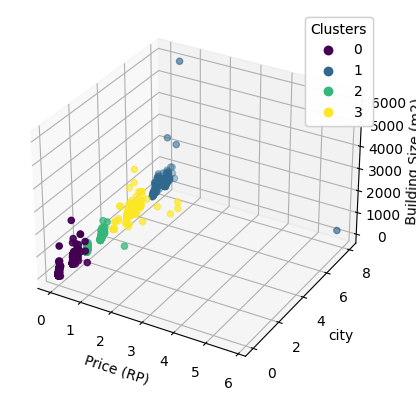

In [ ]:
import matplotlib.pyplot as plt
from mpl_toolkits.mplot3d import Axes3D
import seaborn as sns

plt.figure(figsize=(12, 6))
palette = ['blue', 'red', 'gold', 'green']

# Buat plot 3D
fig = plt.figure()
ax = fig.add_subplot(111, projection='3d')

# Scatter plot
scatter = ax.scatter(df['price_in_rp'], df['city_encoded'], df['building_size_m2'], c=df['Cluster_KM'], cmap='viridis')

# Label sumbu
ax.set_xlabel('Price (RP)')
ax.set_ylabel('city')
ax.set_zlabel('Building Size (m2)')

# Tambahkan legenda
legend = ax.legend(*scatter.legend_elements(), title='Clusters', loc='upper right')
ax.add_artist(legend)

plt.show()


In [ ]:
df

,price_in_rp,city,lat,long,facilities,bedrooms,bathrooms,land_size_m2,building_size_m2,carports,certificate,electricity,property_condition,garages,furnishing,property_condition_encoded,city_encoded,furnishing_encoded,Cluster_KM
0,2.990000e+09,Bekasi,-6.223945,106.986275,"Tempat Jemuran, Jalur Telepon, Taman, Taman",4.0,4.0,239.0,272.0,0.0,shm - sertifikat hak milik,4400 mah,bagus,0.0,unfurnished,0,0,3,0
2,1.950000e+09,Bekasi,-6.223945,106.986275,"Jogging Track, Kolam Renang, Masjid, Taman,...",3.0,3.0,119.0,131.0,1.0,hgb - hak guna bangunan,2200 mah,bagus,1.0,unfurnished,0,0,3,0
3,3.300000e+09,Bekasi,-6.223945,106.986275,"Jalur Telepon, Jogging Track, Track Lari, K...",3.0,3.0,180.0,174.0,0.0,shm - sertifikat hak milik,3500 mah,bagus sekali,2.0,unfurnished,1,0,3,0
4,4.500000e+09,Bekasi,-6.223945,106.986275,"Jogging Track, Kolam Renang, Taman, Jalur Te...",4.0,3.0,328.0,196.0,2.0,shm - sertifikat hak milik,3500 mah,bagus,1.0,unfurnished,0,0,3,0
5,2.700000e+09,Bekasi,-6.223945,106.986275,"Jalur Telepon, Taman, Keamanan, Kolam Renang",3.0,3.0,136.0,200.0,2.0,shm - sertifikat hak milik,3500 mah,bagus,1.0,semi furnished,0,0,2,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
3548,5.880000e+08,Tangerang,-6.296615,106.704601,"Masjid, Taman, Tempat Jemuran, Keamanan 24 ja...",2.0,1.0,72.0,36.0,1.0,shm - sertifikat hak milik,1300 mah,baru,1.0,furnished,2,8,1,1
3549,7.850000e+08,Tangerang,-6.283454,106.638775,"Masjid, Keamanan, Jogging Track, Taman, Tem...",3.0,2.0,85.0,60.0,1.0,shm - sertifikat hak milik,1300 mah,baru,0.0,unfurnished,2,8,3,1
3550,7.550000e+08,Tangerang,-6.283454,106.638775,"Keamanan, Taman, Jogging Track, Tempat Jemur...",3.0,2.0,78.0,60.0,1.0,shm - sertifikat hak milik,1300 mah,baru,0.0,unfurnished,2,8,3,1
3551,8.000000e+08,Tangerang,-6.288237,106.665859,"Tempat Jemuran, Keamanan, Keamanan 24 jam, Was...",3.0,2.0,60.0,65.0,2.0,shm - sertifikat hak milik,2200 mah,baru,0.0,furnished,2,8,1,1


<Figure size 1200x600 with 0 Axes>

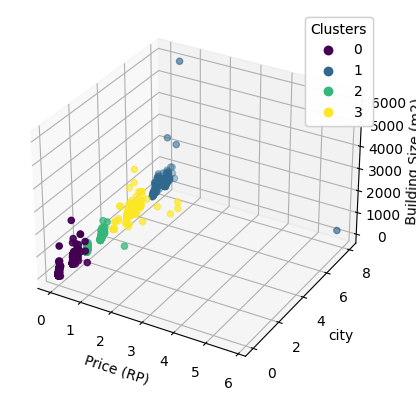

In [ ]:
import matplotlib.pyplot as plt
from mpl_toolkits.mplot3d import Axes3D
import seaborn as sns

plt.figure(figsize=(12, 6))
palette = ['blue', 'red', 'gold', 'green']

# Buat plot 3D
fig = plt.figure()
ax = fig.add_subplot(111, projection='3d')

# Scatter plot
scatter = ax.scatter(df['price_in_rp'], df['city_encoded'], df['building_size_m2'], c=df['Cluster_KM'], cmap='viridis')

# Label sumbu
ax.set_xlabel('Price (RP)')
ax.set_ylabel('city')
ax.set_zlabel('Building Size (m2)')

# Tambahkan legenda
legend = ax.legend(*scatter.legend_elements(), title='Clusters', loc='upper right')
ax.add_artist(legend)

plt.show()


In [ ]:
cluster_1 = df[['lat','long']][df["Cluster_KM"]==0].values.tolist()
cluster_2 = df[['lat','long']][df["Cluster_KM"]==1].values.tolist()
cluster_3 = df[['lat','long']][df["Cluster_KM"]==2].values.tolist()
cluster_4 = df[['lat','long']][df["Cluster_KM"]==3].values.tolist()

In [ ]:
import folium
from folium import plugins
map = folium.Map(location = [-2.548926, 118.0148634], zoom_start = 10, title = "openstreetmap")
map

In [ ]:
for i in cluster_1 :
  folium.CircleMarker(i,radius =2, color = "blue").add_to(map)
for i in cluster_2 :
  folium.CircleMarker(i,radius =2, color = "red").add_to(map)
for i in cluster_3 :
  folium.CircleMarker(i,radius =2, color = "yellow").add_to(map)
for i in cluster_4 :
  folium.CircleMarker(i,radius =2, color = "green").add_to(map)
map

# clustering menggunakan 6 fitur (kmeans)






In [ ]:
from sklearn.preprocessing import MinMaxScaler

df2 = df.copy(deep=True)
df2['price_in_rp_scale'] = MinMaxScaler().fit_transform(df2[['price_in_rp']])
df2['city_encoded_scale'] = MinMaxScaler().fit_transform(df2[['city_encoded']])
df2['building_size_m2_scale'] = MinMaxScaler().fit_transform(df2[['building_size_m2']])
df2['land_size_m2_scale'] = MinMaxScaler().fit_transform(df2[['land_size_m2']])
df2['carports_scale'] = MinMaxScaler().fit_transform(df2[['carports']])
df2['garages_scale'] = MinMaxScaler().fit_transform(df2[['garages']])
df2.head()




,price_in_rp,city,lat,long,facilities,bedrooms,bathrooms,land_size_m2,building_size_m2,carports,...,property_condition_encoded,city_encoded,furnishing_encoded,Cluster_KM,price_in_rp_scale,city_encoded_scale,building_size_m2_scale,land_size_m2_scale,carports_scale,garages_scale
0,2.990000e+09,Bekasi,-6.223945,106.986275,"Tempat Jemuran, Jalur Telepon, Taman, Taman",4.0,4.0,239.0,272.0,0.0,...,0,0,3,0,0.005083,0.0,0.042461,0.028418,0.000000,0.00
2,1.950000e+09,Bekasi,-6.223945,106.986275,"Jogging Track, Kolam Renang, Masjid, Taman,...",3.0,3.0,119.0,131.0,1.0,...,0,0,3,0,0.003290,0.0,0.018890,0.013395,0.071429,0.02
3,3.300000e+09,Bekasi,-6.223945,106.986275,"Jalur Telepon, Jogging Track, Track Lari, K...",3.0,3.0,180.0,174.0,0.0,...,1,0,3,0,0.005618,0.0,0.026078,0.021032,0.000000,0.04
4,4.500000e+09,Bekasi,-6.223945,106.986275,"Jogging Track, Kolam Renang, Taman, Jalur Te...",4.0,3.0,328.0,196.0,2.0,...,0,0,3,0,0.007687,0.0,0.029756,0.039559,0.142857,0.02
5,2.700000e+09,Bekasi,-6.223945,106.986275,"Jalur Telepon, Taman, Keamanan, Kolam Renang",3.0,3.0,136.0,200.0,2.0,...,0,0,2,0,0.004583,0.0,0.030425,0.015523,0.142857,0.02


In [ ]:
print(df2['price_in_rp_scale'].min())
print(df2['price_in_rp_scale'].max())
print(df2['land_size_m2_scale'].min())
print(df2['land_size_m2_scale'].max())
print(df2['building_size_m2_scale'].min())
print(df2['building_size_m2_scale'].max())
print(df2['city_encoded_scale'].min())
print(df2['city_encoded_scale'].max())
print(df2['carports_scale'].min())
print(df2['carports_scale'].max())
print(df2['garages_scale'].min())
print(df2['garages_scale'].max())

0.0
0.9999999999999999
0.0
0.9999999999999998
0.0
1.0
0.0
1.0
0.0
1.0
0.0
1.0


In [ ]:
from sklearn.cluster import KMeans

k = range(1,16)
inertia = []

for i in k:
    km_model = KMeans(n_clusters=i) # jumlah cluster akan di looping
    km_model.fit(df2[['price_in_rp_scale','land_size_m2_scale','building_size_m2_scale','city_encoded_scale','carports_scale','garages_scale']])
    inertia.append(km_model.inertia_)

print(list(k))
print(inertia)

/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:8

[1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15]
[449.45954524033107, 79.91978693748997, 54.08735797168836, 38.69102009905889, 33.28524642580137, 28.971183059818557, 25.610795252214324, 23.932093937905687, 21.632476645249906, 20.108103274056617, 18.646333000718258, 17.193815775451988, 15.65417160152094, 14.640996033431945, 14.006546758613286]


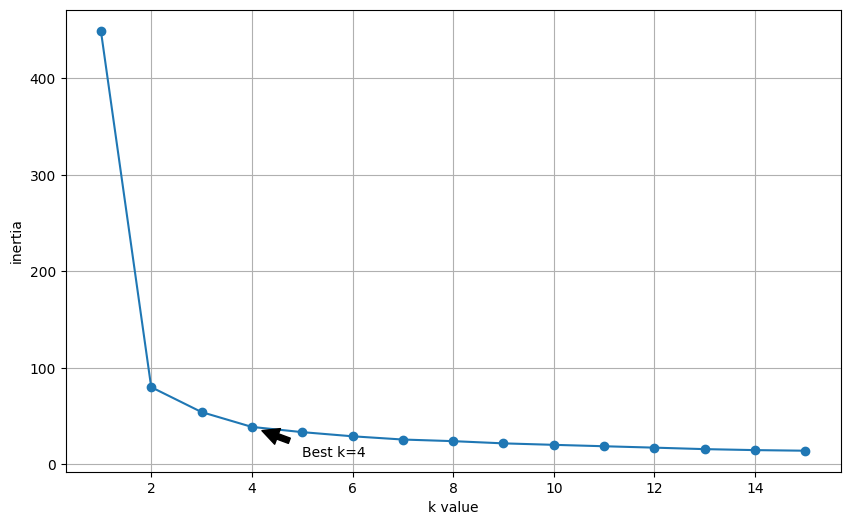

In [ ]:
plt.figure(figsize=(10,6))
plt.plot(k, inertia, marker='o')
plt.xlabel('k value')
plt.ylabel('inertia')
plt.annotate(
    'Best k=4', xy = (k[3], inertia[3]),
    xytext = (5, 8), arrowprops = dict(facecolor='black', shrink=0.2)
)
plt.grid()
plt.show()

In [ ]:
kn5 = KMeans(n_clusters=4, random_state=1)
kn5

KMeans(n_clusters=4, random_state=1)

In [ ]:
kn5.fit(df2[['price_in_rp_scale','land_size_m2_scale','building_size_m2_scale','city_encoded_scale','carports_scale','garages_scale']])

/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(


KMeans(n_clusters=4, random_state=1)

In [ ]:
kn5.labels_

array([0, 0, 0, ..., 1, 1, 1], dtype=int32)

In [ ]:
df['Cluster_KM'] = kn5.predict(df2[['price_in_rp_scale','land_size_m2_scale','building_size_m2_scale','city_encoded_scale','carports_scale','garages_scale']])
df2['Cluster_KM'] = kn5.predict(df2[['price_in_rp_scale','land_size_m2_scale','building_size_m2_scale','city_encoded_scale','carports_scale','garages_scale']])

display(df)
display(df2)

,price_in_rp,city,lat,long,facilities,bedrooms,bathrooms,land_size_m2,building_size_m2,carports,certificate,electricity,property_condition,garages,furnishing,property_condition_encoded,city_encoded,furnishing_encoded,Cluster_KM
0,2.990000e+09,Bekasi,-6.223945,106.986275,"Tempat Jemuran, Jalur Telepon, Taman, Taman",4.0,4.0,239.0,272.0,0.0,shm - sertifikat hak milik,4400 mah,bagus,0.0,unfurnished,0,0,3,0
2,1.950000e+09,Bekasi,-6.223945,106.986275,"Jogging Track, Kolam Renang, Masjid, Taman,...",3.0,3.0,119.0,131.0,1.0,hgb - hak guna bangunan,2200 mah,bagus,1.0,unfurnished,0,0,3,0
3,3.300000e+09,Bekasi,-6.223945,106.986275,"Jalur Telepon, Jogging Track, Track Lari, K...",3.0,3.0,180.0,174.0,0.0,shm - sertifikat hak milik,3500 mah,bagus sekali,2.0,unfurnished,1,0,3,0
4,4.500000e+09,Bekasi,-6.223945,106.986275,"Jogging Track, Kolam Renang, Taman, Jalur Te...",4.0,3.0,328.0,196.0,2.0,shm - sertifikat hak milik,3500 mah,bagus,1.0,unfurnished,0,0,3,0
5,2.700000e+09,Bekasi,-6.223945,106.986275,"Jalur Telepon, Taman, Keamanan, Kolam Renang",3.0,3.0,136.0,200.0,2.0,shm - sertifikat hak milik,3500 mah,bagus,1.0,semi furnished,0,0,2,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
3548,5.880000e+08,Tangerang,-6.296615,106.704601,"Masjid, Taman, Tempat Jemuran, Keamanan 24 ja...",2.0,1.0,72.0,36.0,1.0,shm - sertifikat hak milik,1300 mah,baru,1.0,furnished,2,8,1,1
3549,7.850000e+08,Tangerang,-6.283454,106.638775,"Masjid, Keamanan, Jogging Track, Taman, Tem...",3.0,2.0,85.0,60.0,1.0,shm - sertifikat hak milik,1300 mah,baru,0.0,unfurnished,2,8,3,1
3550,7.550000e+08,Tangerang,-6.283454,106.638775,"Keamanan, Taman, Jogging Track, Tempat Jemur...",3.0,2.0,78.0,60.0,1.0,shm - sertifikat hak milik,1300 mah,baru,0.0,unfurnished,2,8,3,1
3551,8.000000e+08,Tangerang,-6.288237,106.665859,"Tempat Jemuran, Keamanan, Keamanan 24 jam, Was...",3.0,2.0,60.0,65.0,2.0,shm - sertifikat hak milik,2200 mah,baru,0.0,furnished,2,8,1,1


,price_in_rp,city,lat,long,facilities,bedrooms,bathrooms,land_size_m2,building_size_m2,carports,...,property_condition_encoded,city_encoded,furnishing_encoded,Cluster_KM,price_in_rp_scale,city_encoded_scale,building_size_m2_scale,land_size_m2_scale,carports_scale,garages_scale
0,2.990000e+09,Bekasi,-6.223945,106.986275,"Tempat Jemuran, Jalur Telepon, Taman, Taman",4.0,4.0,239.0,272.0,0.0,...,0,0,3,0,0.005083,0.0,0.042461,0.028418,0.000000,0.00
2,1.950000e+09,Bekasi,-6.223945,106.986275,"Jogging Track, Kolam Renang, Masjid, Taman,...",3.0,3.0,119.0,131.0,1.0,...,0,0,3,0,0.003290,0.0,0.018890,0.013395,0.071429,0.02
3,3.300000e+09,Bekasi,-6.223945,106.986275,"Jalur Telepon, Jogging Track, Track Lari, K...",3.0,3.0,180.0,174.0,0.0,...,1,0,3,0,0.005618,0.0,0.026078,0.021032,0.000000,0.04
4,4.500000e+09,Bekasi,-6.223945,106.986275,"Jogging Track, Kolam Renang, Taman, Jalur Te...",4.0,3.0,328.0,196.0,2.0,...,0,0,3,0,0.007687,0.0,0.029756,0.039559,0.142857,0.02
5,2.700000e+09,Bekasi,-6.223945,106.986275,"Jalur Telepon, Taman, Keamanan, Kolam Renang",3.0,3.0,136.0,200.0,2.0,...,0,0,2,0,0.004583,0.0,0.030425,0.015523,0.142857,0.02
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
3548,5.880000e+08,Tangerang,-6.296615,106.704601,"Masjid, Taman, Tempat Jemuran, Keamanan 24 ja...",2.0,1.0,72.0,36.0,1.0,...,2,8,1,1,0.000941,1.0,0.003009,0.007511,0.071429,0.02
3549,7.850000e+08,Tangerang,-6.283454,106.638775,"Masjid, Keamanan, Jogging Track, Taman, Tem...",3.0,2.0,85.0,60.0,1.0,...,2,8,3,1,0.001281,1.0,0.007021,0.009139,0.071429,0.00
3550,7.550000e+08,Tangerang,-6.283454,106.638775,"Keamanan, Taman, Jogging Track, Tempat Jemur...",3.0,2.0,78.0,60.0,1.0,...,2,8,3,1,0.001229,1.0,0.007021,0.008262,0.071429,0.00
3551,8.000000e+08,Tangerang,-6.288237,106.665859,"Tempat Jemuran, Keamanan, Keamanan 24 jam, Was...",3.0,2.0,60.0,65.0,2.0,...,2,8,1,1,0.001307,1.0,0.007857,0.006009,0.142857,0.00


In [ ]:
df['Cluster_KM'].value_counts()

Cluster_KM
0    1195
1     759
2     578
3     318
Name: count, dtype: int64

In [ ]:
from sklearn import metrics
labels = kn5.labels_
metrics.silhouette_score(df2[['price_in_rp_scale','land_size_m2_scale','building_size_m2_scale','city_encoded_scale','carports_scale','garages_scale']], labels, metric='euclidean')

0.5439908991805861

In [ ]:
df2[['price_in_rp_scale','land_size_m2_scale','building_size_m2_scale','city_encoded_scale','carports_scale','garages_scale']].head()

,price_in_rp_scale,land_size_m2_scale,building_size_m2_scale,city_encoded_scale,carports_scale,garages_scale
0,0.005083,0.028418,0.042461,0.0,0.000000,0.00
2,0.003290,0.013395,0.018890,0.0,0.071429,0.02
3,0.005618,0.021032,0.026078,0.0,0.000000,0.04
4,0.007687,0.039559,0.029756,0.0,0.142857,0.02
5,0.004583,0.015523,0.030425,0.0,0.142857,0.02


In [ ]:
kn5_b = KMeans(n_clusters=4, random_state=1)
kn5_b.fit(df2[['price_in_rp_scale','land_size_m2_scale','building_size_m2_scale','city_encoded_scale','carports_scale','garages_scale']])
kn5_b.labels_

/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(


array([0, 0, 0, ..., 1, 1, 1], dtype=int32)

In [ ]:
from sklearn import metrics
labels = kn5_b.labels_
metrics.silhouette_score(df2[['price_in_rp_scale','land_size_m2_scale','building_size_m2_scale','city_encoded_scale','carports_scale','garages_scale']], labels, metric='euclidean')

0.5439908991805861

<Figure size 1200x600 with 0 Axes>

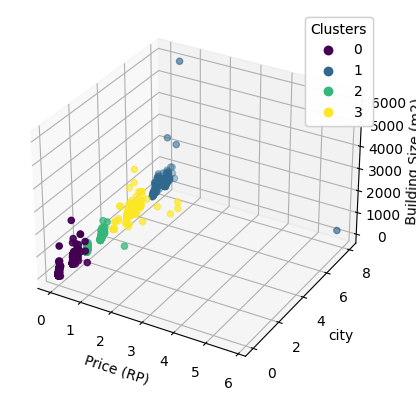

In [ ]:
import matplotlib.pyplot as plt
from mpl_toolkits.mplot3d import Axes3D
import seaborn as sns

plt.figure(figsize=(12, 6))
palette = ['blue', 'red', 'gold', 'green']

# Buat plot 3D
fig = plt.figure()
ax = fig.add_subplot(111, projection='3d')

# Scatter plot
scatter = ax.scatter(df['price_in_rp'], df['city_encoded'], df['building_size_m2'], c=df['Cluster_KM'], cmap='viridis')

# Label sumbu
ax.set_xlabel('Price (RP)')
ax.set_ylabel('city')
ax.set_zlabel('Building Size (m2)')

# Tambahkan legenda
legend = ax.legend(*scatter.legend_elements(), title='Clusters', loc='upper right')
ax.add_artist(legend)

plt.show()


In [ ]:
df

,price_in_rp,city,lat,long,facilities,bedrooms,bathrooms,land_size_m2,building_size_m2,carports,certificate,electricity,property_condition,garages,furnishing,property_condition_encoded,city_encoded,furnishing_encoded,Cluster_KM
0,2.990000e+09,Bekasi,-6.223945,106.986275,"Tempat Jemuran, Jalur Telepon, Taman, Taman",4.0,4.0,239.0,272.0,0.0,shm - sertifikat hak milik,4400 mah,bagus,0.0,unfurnished,0,0,3,0
2,1.950000e+09,Bekasi,-6.223945,106.986275,"Jogging Track, Kolam Renang, Masjid, Taman,...",3.0,3.0,119.0,131.0,1.0,hgb - hak guna bangunan,2200 mah,bagus,1.0,unfurnished,0,0,3,0
3,3.300000e+09,Bekasi,-6.223945,106.986275,"Jalur Telepon, Jogging Track, Track Lari, K...",3.0,3.0,180.0,174.0,0.0,shm - sertifikat hak milik,3500 mah,bagus sekali,2.0,unfurnished,1,0,3,0
4,4.500000e+09,Bekasi,-6.223945,106.986275,"Jogging Track, Kolam Renang, Taman, Jalur Te...",4.0,3.0,328.0,196.0,2.0,shm - sertifikat hak milik,3500 mah,bagus,1.0,unfurnished,0,0,3,0
5,2.700000e+09,Bekasi,-6.223945,106.986275,"Jalur Telepon, Taman, Keamanan, Kolam Renang",3.0,3.0,136.0,200.0,2.0,shm - sertifikat hak milik,3500 mah,bagus,1.0,semi furnished,0,0,2,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
3548,5.880000e+08,Tangerang,-6.296615,106.704601,"Masjid, Taman, Tempat Jemuran, Keamanan 24 ja...",2.0,1.0,72.0,36.0,1.0,shm - sertifikat hak milik,1300 mah,baru,1.0,furnished,2,8,1,1
3549,7.850000e+08,Tangerang,-6.283454,106.638775,"Masjid, Keamanan, Jogging Track, Taman, Tem...",3.0,2.0,85.0,60.0,1.0,shm - sertifikat hak milik,1300 mah,baru,0.0,unfurnished,2,8,3,1
3550,7.550000e+08,Tangerang,-6.283454,106.638775,"Keamanan, Taman, Jogging Track, Tempat Jemur...",3.0,2.0,78.0,60.0,1.0,shm - sertifikat hak milik,1300 mah,baru,0.0,unfurnished,2,8,3,1
3551,8.000000e+08,Tangerang,-6.288237,106.665859,"Tempat Jemuran, Keamanan, Keamanan 24 jam, Was...",3.0,2.0,60.0,65.0,2.0,shm - sertifikat hak milik,2200 mah,baru,0.0,furnished,2,8,1,1


<Figure size 1200x600 with 0 Axes>

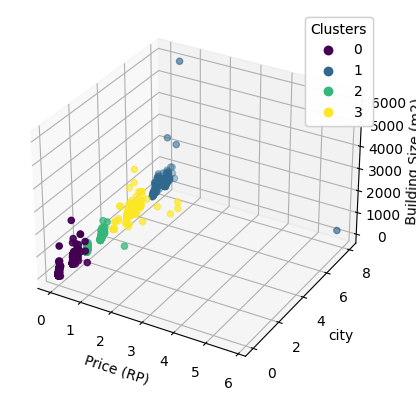

In [ ]:
import matplotlib.pyplot as plt
from mpl_toolkits.mplot3d import Axes3D
import seaborn as sns

plt.figure(figsize=(12, 6))
palette = ['blue', 'red', 'gold', 'green']

# Buat plot 3D
fig = plt.figure()
ax = fig.add_subplot(111, projection='3d')

# Scatter plot
scatter = ax.scatter(df['price_in_rp'], df['city_encoded'], df['building_size_m2'], c=df['Cluster_KM'], cmap='viridis')

# Label sumbu
ax.set_xlabel('Price (RP)')
ax.set_ylabel('city')
ax.set_zlabel('Building Size (m2)')

# Tambahkan legenda
legend = ax.legend(*scatter.legend_elements(), title='Clusters', loc='upper right')
ax.add_artist(legend)

plt.show()


In [ ]:
cluster_1 = df[['lat','long']][df["Cluster_KM"]==0].values.tolist()
cluster_2 = df[['lat','long']][df["Cluster_KM"]==1].values.tolist()
cluster_3 = df[['lat','long']][df["Cluster_KM"]==2].values.tolist()
cluster_4 = df[['lat','long']][df["Cluster_KM"]==3].values.tolist()

In [ ]:
import folium
from folium import plugins
map = folium.Map(location = [-2.548926, 118.0148634], zoom_start = 10, title = "openstreetmap")
map

In [ ]:
for i in cluster_1 :
  folium.CircleMarker(i,radius =2, color = "blue").add_to(map)
for i in cluster_2 :
  folium.CircleMarker(i,radius =2, color = "red").add_to(map)
for i in cluster_3 :
  folium.CircleMarker(i,radius =2, color = "yellow").add_to(map)
for i in cluster_4 :
  folium.CircleMarker(i,radius =2, color = "green").add_to(map)
map

# clustering menggunakan 7 fitur (kmeans)





In [ ]:
from sklearn.preprocessing import MinMaxScaler

df2 = df.copy(deep=True)
df2['price_in_rp_scale'] = MinMaxScaler().fit_transform(df2[['price_in_rp']])
df2['city_encoded_scale'] = MinMaxScaler().fit_transform(df2[['city_encoded']])
df2['building_size_m2_scale'] = MinMaxScaler().fit_transform(df2[['building_size_m2']])
df2['land_size_m2_scale'] = MinMaxScaler().fit_transform(df2[['land_size_m2']])
df2['carports_scale'] = MinMaxScaler().fit_transform(df2[['carports']])
df2['garages_scale'] = MinMaxScaler().fit_transform(df2[['garages']])
df2['bathrooms_scale'] = MinMaxScaler().fit_transform(df2[['bathrooms']])
df2.head()




,price_in_rp,city,lat,long,facilities,bedrooms,bathrooms,land_size_m2,building_size_m2,carports,...,property_condition_encoded,city_encoded,furnishing_encoded,price_in_rp_scale,city_encoded_scale,building_size_m2_scale,land_size_m2_scale,carports_scale,garages_scale,bathrooms_scale
0,2.990000e+09,Bekasi,-6.223945,106.986275,"Tempat Jemuran, Jalur Telepon, Taman, Taman",4.0,4.0,239.0,272.0,0.0,...,0,0,3,0.005083,0.0,0.042461,0.028418,0.000000,0.00,0.030612
2,1.950000e+09,Bekasi,-6.223945,106.986275,"Jogging Track, Kolam Renang, Masjid, Taman,...",3.0,3.0,119.0,131.0,1.0,...,0,0,3,0.003290,0.0,0.018890,0.013395,0.071429,0.02,0.020408
3,3.300000e+09,Bekasi,-6.223945,106.986275,"Jalur Telepon, Jogging Track, Track Lari, K...",3.0,3.0,180.0,174.0,0.0,...,1,0,3,0.005618,0.0,0.026078,0.021032,0.000000,0.04,0.020408
4,4.500000e+09,Bekasi,-6.223945,106.986275,"Jogging Track, Kolam Renang, Taman, Jalur Te...",4.0,3.0,328.0,196.0,2.0,...,0,0,3,0.007687,0.0,0.029756,0.039559,0.142857,0.02,0.020408
5,2.700000e+09,Bekasi,-6.223945,106.986275,"Jalur Telepon, Taman, Keamanan, Kolam Renang",3.0,3.0,136.0,200.0,2.0,...,0,0,2,0.004583,0.0,0.030425,0.015523,0.142857,0.02,0.020408


In [ ]:
print(df2['price_in_rp_scale'].min())
print(df2['price_in_rp_scale'].max())
print(df2['land_size_m2_scale'].min())
print(df2['land_size_m2_scale'].max())
print(df2['building_size_m2_scale'].min())
print(df2['building_size_m2_scale'].max())
print(df2['city_encoded_scale'].min())
print(df2['city_encoded_scale'].max())
print(df2['carports_scale'].min())
print(df2['carports_scale'].max())
print(df2['garages_scale'].min())
print(df2['garages_scale'].max())
print(df2['bathrooms_scale'].min())
print(df2['bathrooms_scale'].max())

0.0
0.9999999999999999
0.0
0.9999999999999998
0.0
1.0
0.0
1.0
0.0
1.0
0.0
1.0
0.0
0.9999999999999999


In [ ]:
from sklearn.cluster import KMeans

k = range(1,16)
inertia = []

for i in k:
    km_model = KMeans(n_clusters=i) # jumlah cluster akan di looping
    km_model.fit(df2[['price_in_rp_scale','land_size_m2_scale','building_size_m2_scale','city_encoded_scale','garages_scale','carports_scale','bathrooms_scale']])
    inertia.append(km_model.inertia_)

print(list(k))
print(inertia)

/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:8

[1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15]
[451.94898403410866, 82.33601408031876, 57.019919666202114, 41.08021828088938, 35.64933504376535, 32.23797421534735, 27.823183076565893, 25.106734974277764, 23.034657427181628, 21.303943415365367, 19.438476129468857, 18.547569155847555, 17.368677588688268, 15.442696886962747, 14.92869152053478]


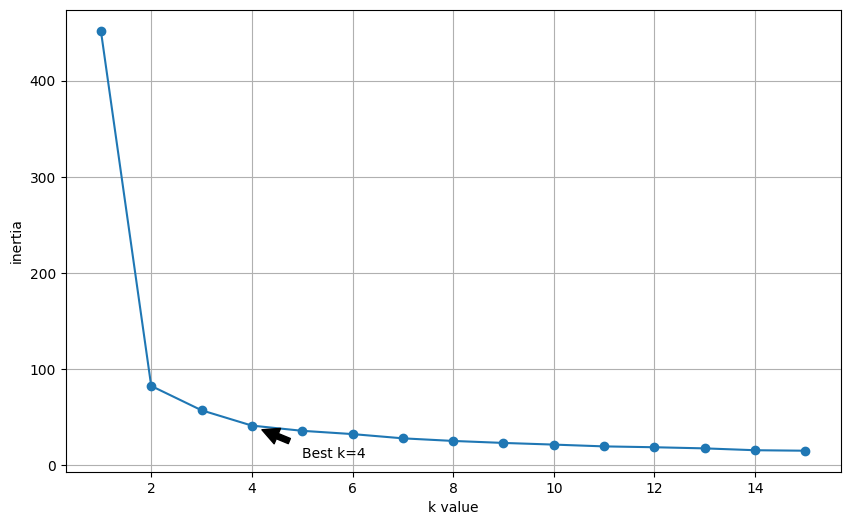

In [ ]:
plt.figure(figsize=(10,6))
plt.plot(k, inertia, marker='o')
plt.xlabel('k value')
plt.ylabel('inertia')
plt.annotate(
    'Best k=4', xy = (k[3], inertia[3]),
    xytext = (5, 8), arrowprops = dict(facecolor='black', shrink=0.2)
)
plt.grid()
plt.show()

In [ ]:
kn5 = KMeans(n_clusters=4, random_state=1)
kn5

KMeans(n_clusters=4, random_state=1)

In [ ]:
kn5.fit(df2[['price_in_rp_scale','land_size_m2_scale','building_size_m2_scale','city_encoded_scale','garages_scale','carports_scale','bathrooms_scale']])

/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(


KMeans(n_clusters=4, random_state=1)

In [ ]:
kn5.labels_

array([0, 0, 0, ..., 1, 1, 1], dtype=int32)

In [ ]:
df['Cluster_KM'] = kn5.predict(df2[['price_in_rp_scale','land_size_m2_scale','building_size_m2_scale','city_encoded_scale', 'garages_scale','carports_scale','bathrooms_scale']])
df2['Cluster_KM'] = kn5.predict(df2[['price_in_rp_scale','land_size_m2_scale','building_size_m2_scale','city_encoded_scale', 'garages_scale','carports_scale','bathrooms_scale']])

display(df)
display(df2)

,price_in_rp,city,lat,long,facilities,bedrooms,bathrooms,land_size_m2,building_size_m2,carports,certificate,electricity,property_condition,garages,furnishing,property_condition_encoded,city_encoded,furnishing_encoded,Cluster_KM
0,2.990000e+09,Bekasi,-6.223945,106.986275,"Tempat Jemuran, Jalur Telepon, Taman, Taman",4.0,4.0,239.0,272.0,0.0,shm - sertifikat hak milik,4400 mah,bagus,0.0,unfurnished,0,0,3,0
2,1.950000e+09,Bekasi,-6.223945,106.986275,"Jogging Track, Kolam Renang, Masjid, Taman,...",3.0,3.0,119.0,131.0,1.0,hgb - hak guna bangunan,2200 mah,bagus,1.0,unfurnished,0,0,3,0
3,3.300000e+09,Bekasi,-6.223945,106.986275,"Jalur Telepon, Jogging Track, Track Lari, K...",3.0,3.0,180.0,174.0,0.0,shm - sertifikat hak milik,3500 mah,bagus sekali,2.0,unfurnished,1,0,3,0
4,4.500000e+09,Bekasi,-6.223945,106.986275,"Jogging Track, Kolam Renang, Taman, Jalur Te...",4.0,3.0,328.0,196.0,2.0,shm - sertifikat hak milik,3500 mah,bagus,1.0,unfurnished,0,0,3,0
5,2.700000e+09,Bekasi,-6.223945,106.986275,"Jalur Telepon, Taman, Keamanan, Kolam Renang",3.0,3.0,136.0,200.0,2.0,shm - sertifikat hak milik,3500 mah,bagus,1.0,semi furnished,0,0,2,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
3548,5.880000e+08,Tangerang,-6.296615,106.704601,"Masjid, Taman, Tempat Jemuran, Keamanan 24 ja...",2.0,1.0,72.0,36.0,1.0,shm - sertifikat hak milik,1300 mah,baru,1.0,furnished,2,8,1,1
3549,7.850000e+08,Tangerang,-6.283454,106.638775,"Masjid, Keamanan, Jogging Track, Taman, Tem...",3.0,2.0,85.0,60.0,1.0,shm - sertifikat hak milik,1300 mah,baru,0.0,unfurnished,2,8,3,1
3550,7.550000e+08,Tangerang,-6.283454,106.638775,"Keamanan, Taman, Jogging Track, Tempat Jemur...",3.0,2.0,78.0,60.0,1.0,shm - sertifikat hak milik,1300 mah,baru,0.0,unfurnished,2,8,3,1
3551,8.000000e+08,Tangerang,-6.288237,106.665859,"Tempat Jemuran, Keamanan, Keamanan 24 jam, Was...",3.0,2.0,60.0,65.0,2.0,shm - sertifikat hak milik,2200 mah,baru,0.0,furnished,2,8,1,1


,price_in_rp,city,lat,long,facilities,bedrooms,bathrooms,land_size_m2,building_size_m2,carports,...,city_encoded,furnishing_encoded,price_in_rp_scale,city_encoded_scale,building_size_m2_scale,land_size_m2_scale,carports_scale,garages_scale,bathrooms_scale,Cluster_KM
0,2.990000e+09,Bekasi,-6.223945,106.986275,"Tempat Jemuran, Jalur Telepon, Taman, Taman",4.0,4.0,239.0,272.0,0.0,...,0,3,0.005083,0.0,0.042461,0.028418,0.000000,0.00,0.030612,0
2,1.950000e+09,Bekasi,-6.223945,106.986275,"Jogging Track, Kolam Renang, Masjid, Taman,...",3.0,3.0,119.0,131.0,1.0,...,0,3,0.003290,0.0,0.018890,0.013395,0.071429,0.02,0.020408,0
3,3.300000e+09,Bekasi,-6.223945,106.986275,"Jalur Telepon, Jogging Track, Track Lari, K...",3.0,3.0,180.0,174.0,0.0,...,0,3,0.005618,0.0,0.026078,0.021032,0.000000,0.04,0.020408,0
4,4.500000e+09,Bekasi,-6.223945,106.986275,"Jogging Track, Kolam Renang, Taman, Jalur Te...",4.0,3.0,328.0,196.0,2.0,...,0,3,0.007687,0.0,0.029756,0.039559,0.142857,0.02,0.020408,0
5,2.700000e+09,Bekasi,-6.223945,106.986275,"Jalur Telepon, Taman, Keamanan, Kolam Renang",3.0,3.0,136.0,200.0,2.0,...,0,2,0.004583,0.0,0.030425,0.015523,0.142857,0.02,0.020408,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
3548,5.880000e+08,Tangerang,-6.296615,106.704601,"Masjid, Taman, Tempat Jemuran, Keamanan 24 ja...",2.0,1.0,72.0,36.0,1.0,...,8,1,0.000941,1.0,0.003009,0.007511,0.071429,0.02,0.000000,1
3549,7.850000e+08,Tangerang,-6.283454,106.638775,"Masjid, Keamanan, Jogging Track, Taman, Tem...",3.0,2.0,85.0,60.0,1.0,...,8,3,0.001281,1.0,0.007021,0.009139,0.071429,0.00,0.010204,1
3550,7.550000e+08,Tangerang,-6.283454,106.638775,"Keamanan, Taman, Jogging Track, Tempat Jemur...",3.0,2.0,78.0,60.0,1.0,...,8,3,0.001229,1.0,0.007021,0.008262,0.071429,0.00,0.010204,1
3551,8.000000e+08,Tangerang,-6.288237,106.665859,"Tempat Jemuran, Keamanan, Keamanan 24 jam, Was...",3.0,2.0,60.0,65.0,2.0,...,8,1,0.001307,1.0,0.007857,0.006009,0.142857,0.00,0.010204,1


In [ ]:
df['Cluster_KM'].value_counts()

Cluster_KM
0    1195
1     759
3     578
2     318
Name: count, dtype: int64

In [ ]:
from sklearn import metrics
labels = kn5.labels_
metrics.silhouette_score(df2[['price_in_rp_scale','land_size_m2_scale','building_size_m2_scale','city_encoded_scale', 'garages_scale','carports_scale','bathrooms_scale']], labels, metric='euclidean')

0.5374843549479196

In [ ]:
df2[['price_in_rp_scale','land_size_m2_scale','building_size_m2_scale','city_encoded_scale', 'garages_scale','carports_scale','bathrooms_scale']].head()

,price_in_rp_scale,land_size_m2_scale,building_size_m2_scale,city_encoded_scale,garages_scale,carports_scale,bathrooms_scale
0,0.005083,0.028418,0.042461,0.0,0.00,0.000000,0.030612
2,0.003290,0.013395,0.018890,0.0,0.02,0.071429,0.020408
3,0.005618,0.021032,0.026078,0.0,0.04,0.000000,0.020408
4,0.007687,0.039559,0.029756,0.0,0.02,0.142857,0.020408
5,0.004583,0.015523,0.030425,0.0,0.02,0.142857,0.020408


In [ ]:
kn5_b = KMeans(n_clusters=6, random_state=1)
kn5_b.fit(df2[['price_in_rp_scale','land_size_m2_scale','building_size_m2_scale','city_encoded_scale', 'garages_scale','carports_scale','bathrooms_scale']])
kn5_b.labels_

/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(


array([4, 4, 4, ..., 1, 1, 1], dtype=int32)

In [ ]:
from sklearn import metrics
labels = kn5_b.labels_
metrics.silhouette_score(df2[['price_in_rp_scale','land_size_m2_scale','building_size_m2_scale','city_encoded_scale', 'garages_scale','carports_scale','bathrooms_scale']], labels, metric='euclidean')

0.5485331734171871

In [ ]:
df[df["Cluster_KM"]==0].head(10)

In [ ]:
df.to_csv("hasil_cluster_kmeans.csv")

In [ ]:
df[df["Cluster_KM"]==1].head(10)


,price_in_rp,city,lat,long,facilities,bedrooms,bathrooms,land_size_m2,building_size_m2,carports,certificate,electricity,property_condition,garages,furnishing,property_condition_encoded,city_encoded,furnishing_encoded,Cluster_KM
2095,2.900000e+10,Jakarta Utara,-6.102478,106.74119,"AC, Kolam Renang, Jalur Telepon, Keamanan 24...",4.0,4.0,450.0,850.0,2.0,shm - sertifikat hak milik,8000 mah,bagus,2.0,semi furnished,0,7,2,1
2096,7.700000e+09,Jakarta Utara,-6.102478,106.74119,"Keamanan 24 jam, Taman, Keamanan",4.0,3.0,200.0,400.0,0.0,shm - sertifikat hak milik,4400 mah,bagus,0.0,semi furnished,0,7,2,1
2098,1.800000e+10,Jakarta Utara,-6.102478,106.74119,"Jalur Telepon, Keamanan 24 jam, Kitchen Set, O...",5.0,3.0,450.0,600.0,0.0,shm - sertifikat hak milik,lainnya mah,bagus,0.0,semi furnished,0,7,2,1
2100,2.500000e+10,Jakarta Utara,-6.102478,106.74119,"Jalur Telepon, AC, Taman",6.0,6.0,785.0,839.0,0.0,shm - sertifikat hak milik,lainnya mah,bagus,0.0,semi furnished,0,7,2,1
2101,1.000000e+10,Jakarta Utara,-6.102478,106.74119,"Jalur Telepon, Kitchen Set, Wastafel, Keamanan...",6.0,5.0,270.0,700.0,0.0,shm - sertifikat hak milik,lainnya mah,bagus,0.0,semi furnished,0,7,2,1
2102,2.300000e+10,Jakarta Utara,-6.102478,106.74119,"Taman, Keamanan 24 jam, Kitchen Set, Wastafel,...",7.0,7.0,377.0,1100.0,0.0,shm - sertifikat hak milik,lainnya mah,bagus,0.0,semi furnished,0,7,2,1
2103,1.200000e+10,Jakarta Utara,-6.102478,106.74119,"Taman, Keamanan, Jogging Track, Track Lari, T...",3.0,3.0,300.0,320.0,1.0,"lainnya (ppjb,girik,adat,dll)",16500 mah,bagus,1.0,semi furnished,0,7,2,1
2104,2.350000e+09,Jakarta Utara,-6.102478,106.74119,"Taman, Kolam Renang, Keamanan, Jalur Telepon...",3.0,3.0,75.0,98.0,2.0,"lainnya (ppjb,girik,adat,dll)",4400 mah,baru,0.0,unfurnished,2,7,3,1
2105,2.500000e+10,Jakarta Utara,-6.102478,106.74119,"Kolam Renang, Taman, Jogging Track, Keamanan...",6.0,5.0,785.0,839.0,2.0,shm - sertifikat hak milik,16500 mah,bagus sekali,2.0,semi furnished,1,7,2,1
2106,3.150000e+09,Jakarta Utara,-6.102478,106.74119,"Jogging Track, Keamanan, Jalur Telepon, Kol...",3.0,3.0,100.0,150.0,1.0,"lainnya (ppjb,girik,adat,dll)",4400 mah,baru,1.0,unfurnished,2,7,3,1


In [ ]:
df[df["Cluster_KM"]==2].head(10)


,price_in_rp,city,lat,long,facilities,bedrooms,bathrooms,land_size_m2,building_size_m2,carports,certificate,electricity,property_condition,garages,furnishing,property_condition_encoded,city_encoded,furnishing_encoded,Cluster_KM
2038,1.710000e+09,Jakarta Selatan,-6.330417,106.825463,"AC, Jogging Track, Ac, Kolam Renang, Jalur...",3.0,3.0,80.0,130.0,1.0,shm - sertifikat hak milik,2200 mah,baru,1.0,semi furnished,2,5,2,2
2039,1.950000e+09,Jakarta Selatan,-6.330417,106.825463,"Kolam Renang, Taman, Kolam Renang, Keamanan,...",4.0,4.0,95.0,150.0,2.0,shm - sertifikat hak milik,2200 mah,baru,0.0,semi furnished,2,5,2,2
2041,2.400000e+09,Jakarta Selatan,-6.330417,106.825463,"Ac, AC",4.0,4.0,113.0,160.0,2.0,shm - sertifikat hak milik,2200 mah,baru,2.0,semi furnished,2,5,2,2
2042,1.550000e+09,Jakarta Selatan,-6.330417,106.825463,"Jogging Track, Track Lari, One Gate System,...",3.0,3.0,70.0,120.0,0.0,shm - sertifikat hak milik,2200 mah,baru,1.0,semi furnished,2,5,2,2
2043,6.950000e+08,Jakarta Selatan,-6.330417,106.825463,"Keamanan, Keamanan 24 jam, AC, Masjid, Masji...",2.0,2.0,40.0,80.0,1.0,shm - sertifikat hak milik,2200 mah,baru,0.0,unfurnished,2,5,3,2
2044,2.640000e+09,Jakarta Selatan,-6.330417,106.825463,"Tempat Jemuran, Keamanan 24 jam, Taman",4.0,4.0,110.0,140.0,1.0,shm - sertifikat hak milik,2200 mah,bagus,0.0,unfurnished,0,5,3,2
2045,4.500000e+09,Jakarta Selatan,-6.330417,106.825463,"Kolam Renang, Taman",4.0,4.0,168.0,230.0,1.0,shm - sertifikat hak milik,3300 mah,baru,2.0,unfurnished,2,5,3,2
2046,2.640000e+09,Jakarta Selatan,-6.330417,106.825463,"Taman, Keamanan",4.0,4.0,110.0,140.0,0.0,shm - sertifikat hak milik,2200 mah,bagus,1.0,unfurnished,0,5,3,2
2048,1.450000e+09,Jakarta Selatan,-6.330417,106.825463,"Taman, Keamanan, Ac, Jalur Telepon, Keamanan...",3.0,3.0,97.0,130.0,2.0,shm - sertifikat hak milik,2200 mah,baru,2.0,semi furnished,2,5,2,2
2049,3.700000e+09,Jakarta Selatan,-6.330417,106.825463,"Tempat Jemuran, Kitchen Set, Taman, Keamanan",4.0,4.0,112.0,240.0,2.0,shm - sertifikat hak milik,2200 mah,baru,2.0,unfurnished,2,5,3,2


In [ ]:
df[df["Cluster_KM"]==3].head(10)

,price_in_rp,city,lat,long,facilities,bedrooms,bathrooms,land_size_m2,building_size_m2,carports,certificate,electricity,property_condition,garages,furnishing,property_condition_encoded,city_encoded,furnishing_encoded,Cluster_KM
1467,7.990000e+08,Depok,-6.399113,106.799954,Taman,3.0,2.0,74.0,70.0,1.0,shm - sertifikat hak milik,2200 mah,baru,0.0,unfurnished,2,2,3,3
1468,8.110000e+08,Depok,-6.399113,106.799954,"Masjid, CCTV, Keamanan, Taman",3.0,2.0,72.0,70.0,0.0,shm - sertifikat hak milik,1300 mah,baru,2.0,unfurnished,2,2,3,3
1469,6.600000e+08,Depok,-6.399113,106.799954,"Keamanan, Taman",2.0,1.0,80.0,45.0,0.0,shm - sertifikat hak milik,2200 mah,bagus,1.0,unfurnished,0,2,3,3
1471,3.300000e+08,Depok,-6.399113,106.799954,"Tempat Jemuran, Akses Parkir, One Gate Syste...",2.0,1.0,60.0,40.0,1.0,shm - sertifikat hak milik,1300 mah,baru,1.0,semi furnished,2,2,2,3
1472,1.200000e+09,Depok,-6.399113,106.799954,"Keamanan, Taman",3.0,3.0,120.0,100.0,1.0,shm - sertifikat hak milik,2200 mah,bagus,0.0,unfurnished,0,2,3,3
1473,6.600000e+08,Depok,-6.399113,106.799954,"Keamanan, Taman",2.0,1.0,80.0,45.0,0.0,shm - sertifikat hak milik,2200 mah,bagus,1.0,unfurnished,0,2,3,3
1474,2.280000e+09,Depok,-6.399113,106.799954,"Keamanan, Taman",3.0,4.0,180.0,200.0,1.0,shm - sertifikat hak milik,2200 mah,bagus,1.0,unfurnished,0,2,3,3
1475,7.900000e+08,Depok,-6.399113,106.799954,"Tempat Jemuran, Ac, Jogging Track, Track Lar...",3.0,2.0,72.0,85.0,1.0,shm - sertifikat hak milik,2200 mah,baru,1.0,semi furnished,2,2,2,3
1476,6.900000e+08,Depok,-6.399113,106.799954,"Jogging Track, AC, Masjid, CCTV, Wastafel, ...",2.0,1.0,75.0,50.0,1.0,shm - sertifikat hak milik,2200 mah,baru,1.0,semi furnished,2,2,2,3
1477,1.030000e+09,Depok,-6.399113,106.799954,"Jalur Telepon, Taman, Keamanan",3.0,2.0,83.0,90.0,0.0,shm - sertifikat hak milik,2200 mah,baru,0.0,unfurnished,2,2,3,3


<Figure size 1200x600 with 0 Axes>

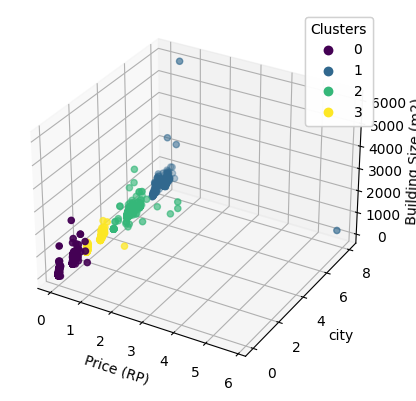

In [ ]:
import matplotlib.pyplot as plt
from mpl_toolkits.mplot3d import Axes3D
import seaborn as sns

plt.figure(figsize=(12, 6))
palette = ['blue', 'red', 'gold', 'green']

# Buat plot 3D
fig = plt.figure()
ax = fig.add_subplot(111, projection='3d')

# Scatter plot
scatter = ax.scatter(df['price_in_rp'], df['city_encoded'], df['building_size_m2'], c=df['Cluster_KM'], cmap='viridis')

# Label sumbu
ax.set_xlabel('Price (RP)')
ax.set_ylabel('city')
ax.set_zlabel('Building Size (m2)')

# Tambahkan legenda
legend = ax.legend(*scatter.legend_elements(), title='Clusters', loc='upper right')
ax.add_artist(legend)

plt.show()


In [ ]:
df

,price_in_rp,city,lat,long,facilities,bedrooms,bathrooms,land_size_m2,building_size_m2,carports,certificate,electricity,property_condition,garages,furnishing,property_condition_encoded,city_encoded,furnishing_encoded,Cluster_KM
0,2.990000e+09,Bekasi,-6.223945,106.986275,"Tempat Jemuran, Jalur Telepon, Taman, Taman",4.0,4.0,239.0,272.0,0.0,shm - sertifikat hak milik,4400 mah,bagus,0.0,unfurnished,0,0,3,0
2,1.950000e+09,Bekasi,-6.223945,106.986275,"Jogging Track, Kolam Renang, Masjid, Taman,...",3.0,3.0,119.0,131.0,1.0,hgb - hak guna bangunan,2200 mah,bagus,1.0,unfurnished,0,0,3,0
3,3.300000e+09,Bekasi,-6.223945,106.986275,"Jalur Telepon, Jogging Track, Track Lari, K...",3.0,3.0,180.0,174.0,0.0,shm - sertifikat hak milik,3500 mah,bagus sekali,2.0,unfurnished,1,0,3,0
4,4.500000e+09,Bekasi,-6.223945,106.986275,"Jogging Track, Kolam Renang, Taman, Jalur Te...",4.0,3.0,328.0,196.0,2.0,shm - sertifikat hak milik,3500 mah,bagus,1.0,unfurnished,0,0,3,0
5,2.700000e+09,Bekasi,-6.223945,106.986275,"Jalur Telepon, Taman, Keamanan, Kolam Renang",3.0,3.0,136.0,200.0,2.0,shm - sertifikat hak milik,3500 mah,bagus,1.0,semi furnished,0,0,2,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
3548,5.880000e+08,Tangerang,-6.296615,106.704601,"Masjid, Taman, Tempat Jemuran, Keamanan 24 ja...",2.0,1.0,72.0,36.0,1.0,shm - sertifikat hak milik,1300 mah,baru,1.0,furnished,2,8,1,1
3549,7.850000e+08,Tangerang,-6.283454,106.638775,"Masjid, Keamanan, Jogging Track, Taman, Tem...",3.0,2.0,85.0,60.0,1.0,shm - sertifikat hak milik,1300 mah,baru,0.0,unfurnished,2,8,3,1
3550,7.550000e+08,Tangerang,-6.283454,106.638775,"Keamanan, Taman, Jogging Track, Tempat Jemur...",3.0,2.0,78.0,60.0,1.0,shm - sertifikat hak milik,1300 mah,baru,0.0,unfurnished,2,8,3,1
3551,8.000000e+08,Tangerang,-6.288237,106.665859,"Tempat Jemuran, Keamanan, Keamanan 24 jam, Was...",3.0,2.0,60.0,65.0,2.0,shm - sertifikat hak milik,2200 mah,baru,0.0,furnished,2,8,1,1


In [ ]:
cluster_1 = df[['lat','long']][df["Cluster_KM"]==0].values.tolist()
cluster_2 = df[['lat','long']][df["Cluster_KM"]==1].values.tolist()
cluster_3 = df[['lat','long']][df["Cluster_KM"]==2].values.tolist()
cluster_4 = df[['lat','long']][df["Cluster_KM"]==3].values.tolist()

In [ ]:
import folium
from folium import plugins
map = folium.Map(location = [-2.548926, 118.0148634], zoom_start = 10, title = "openstreetmap")
map

In [ ]:
for i in cluster_1 :
  folium.CircleMarker(i,radius =2, color = "blue").add_to(map)
for i in cluster_2 :
  folium.CircleMarker(i,radius =2, color = "red").add_to(map)
for i in cluster_3 :
  folium.CircleMarker(i,radius =2, color = "yellow").add_to(map)
for i in cluster_4 :
  folium.CircleMarker(i,radius =2, color = "green").add_to(map)
map

# Clustering menggunakan 8 fitur (kmeans)





In [ ]:
from sklearn.preprocessing import MinMaxScaler

df2 = df.copy(deep=True)
df2['price_in_rp_scale'] = MinMaxScaler().fit_transform(df2[['price_in_rp']])
df2['city_encoded_scale'] = MinMaxScaler().fit_transform(df2[['city_encoded']])
df2['building_size_m2_scale'] = MinMaxScaler().fit_transform(df2[['building_size_m2']])
df2['land_size_m2_scale'] = MinMaxScaler().fit_transform(df2[['land_size_m2']])
df2['carports_scale'] = MinMaxScaler().fit_transform(df2[['carports']])
df2['garages_scale'] = MinMaxScaler().fit_transform(df2[['garages']])
df2['bathrooms_scale'] = MinMaxScaler().fit_transform(df2[['bathrooms']])
df2['bedrooms_scale'] = scaler.fit_transform(df2[['bedrooms']])
df2.head()




,price_in_rp,city,lat,long,facilities,bedrooms,bathrooms,land_size_m2,building_size_m2,carports,...,furnishing_encoded,Cluster_KM,price_in_rp_scale,city_encoded_scale,building_size_m2_scale,land_size_m2_scale,carports_scale,garages_scale,bathrooms_scale,bedrooms_scale
0,2.990000e+09,Bekasi,-6.223945,106.986275,"Tempat Jemuran, Jalur Telepon, Taman, Taman",4.0,4.0,239.0,272.0,0.0,...,3,2,0.005083,0.0,0.042461,0.028418,0.000000,0.00,0.030612,0.030612
2,1.950000e+09,Bekasi,-6.223945,106.986275,"Jogging Track, Kolam Renang, Masjid, Taman,...",3.0,3.0,119.0,131.0,1.0,...,3,2,0.003290,0.0,0.018890,0.013395,0.071429,0.02,0.020408,0.020408
3,3.300000e+09,Bekasi,-6.223945,106.986275,"Jalur Telepon, Jogging Track, Track Lari, K...",3.0,3.0,180.0,174.0,0.0,...,3,2,0.005618,0.0,0.026078,0.021032,0.000000,0.04,0.020408,0.020408
4,4.500000e+09,Bekasi,-6.223945,106.986275,"Jogging Track, Kolam Renang, Taman, Jalur Te...",4.0,3.0,328.0,196.0,2.0,...,3,2,0.007687,0.0,0.029756,0.039559,0.142857,0.02,0.020408,0.030612
5,2.700000e+09,Bekasi,-6.223945,106.986275,"Jalur Telepon, Taman, Keamanan, Kolam Renang",3.0,3.0,136.0,200.0,2.0,...,2,2,0.004583,0.0,0.030425,0.015523,0.142857,0.02,0.020408,0.020408


In [ ]:
print(df2['price_in_rp_scale'].min())
print(df2['price_in_rp_scale'].max())
print(df2['land_size_m2_scale'].min())
print(df2['land_size_m2_scale'].max())
print(df2['building_size_m2_scale'].min())
print(df2['building_size_m2_scale'].max())
print(df2['city_encoded_scale'].min())
print(df2['city_encoded_scale'].max())
print(df2['carports_scale'].min())
print(df2['carports_scale'].max())
print(df2['garages_scale'].min())
print(df2['garages_scale'].max())
print(df2['bathrooms_scale'].min())
print(df2['bathrooms_scale'].max())
print(df2['bedrooms_scale'].min())
print(df2['bedrooms_scale'].max())

0.0
0.9999999999999999
0.0
0.9999999999999998
0.0
1.0
0.0
1.0
0.0
1.0
0.0
1.0
0.0
0.9999999999999999
0.0
0.9999999999999999


In [ ]:
from sklearn.cluster import KMeans

k = range(1,16)
inertia = []

for i in k:
    km_model = KMeans(n_clusters=i) # jumlah cluster akan di looping
    km_model.fit(df2[['price_in_rp_scale','land_size_m2_scale','building_size_m2_scale','city_encoded_scale','garages_scale','carports_scale','bathrooms_scale','bedrooms_scale']])
    inertia.append(km_model.inertia_)

print(list(k))
print(inertia)

/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:8

[1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15]
[454.4321783171922, 84.76577182731646, 58.89159456597726, 43.49534327990185, 38.059969096390176, 33.556907260456455, 28.964879004116263, 25.741694525820193, 23.70997007708427, 22.4905484456052, 20.43000653062306, 18.678536800692132, 17.643786350621777, 16.49422169559165, 15.125979056738842]


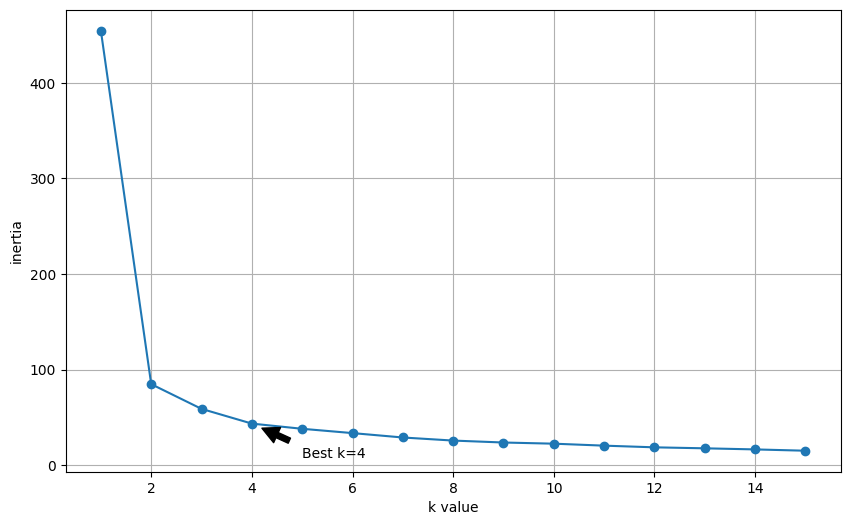

In [ ]:
plt.figure(figsize=(10,6))
plt.plot(k, inertia, marker='o')
plt.xlabel('k value')
plt.ylabel('inertia')
plt.annotate(
    'Best k=4', xy = (k[3], inertia[3]),
    xytext = (5, 8), arrowprops = dict(facecolor='black', shrink=0.2)
)
plt.grid()
plt.show()

In [ ]:
kn5 = KMeans(n_clusters=4, random_state=1)
kn5

KMeans(n_clusters=4, random_state=1)

In [ ]:
kn5.fit(df2[['price_in_rp_scale','land_size_m2_scale','building_size_m2_scale','city_encoded_scale','garages_scale','carports_scale','bathrooms_scale','bedrooms_scale']])

/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(


KMeans(n_clusters=4, random_state=1)

In [ ]:
kn5.labels_

array([0, 0, 0, ..., 1, 1, 1], dtype=int32)

In [ ]:
df['Cluster_KM'] = kn5.predict(df2[['price_in_rp_scale','land_size_m2_scale','building_size_m2_scale','city_encoded_scale', 'garages_scale','carports_scale','bathrooms_scale','bedrooms_scale']])
df2['Cluster_KM'] = kn5.predict(df2[['price_in_rp_scale','land_size_m2_scale','building_size_m2_scale','city_encoded_scale', 'garages_scale','carports_scale','bathrooms_scale','bedrooms_scale']])

display(df)
display(df2)

,price_in_rp,city,lat,long,facilities,bedrooms,bathrooms,land_size_m2,building_size_m2,carports,certificate,electricity,property_condition,garages,furnishing,property_condition_encoded,city_encoded,furnishing_encoded,Cluster_KM
0,2.990000e+09,Bekasi,-6.223945,106.986275,"Tempat Jemuran, Jalur Telepon, Taman, Taman",4.0,4.0,239.0,272.0,0.0,shm - sertifikat hak milik,4400 mah,bagus,0.0,unfurnished,0,0,3,0
2,1.950000e+09,Bekasi,-6.223945,106.986275,"Jogging Track, Kolam Renang, Masjid, Taman,...",3.0,3.0,119.0,131.0,1.0,hgb - hak guna bangunan,2200 mah,bagus,1.0,unfurnished,0,0,3,0
3,3.300000e+09,Bekasi,-6.223945,106.986275,"Jalur Telepon, Jogging Track, Track Lari, K...",3.0,3.0,180.0,174.0,0.0,shm - sertifikat hak milik,3500 mah,bagus sekali,2.0,unfurnished,1,0,3,0
4,4.500000e+09,Bekasi,-6.223945,106.986275,"Jogging Track, Kolam Renang, Taman, Jalur Te...",4.0,3.0,328.0,196.0,2.0,shm - sertifikat hak milik,3500 mah,bagus,1.0,unfurnished,0,0,3,0
5,2.700000e+09,Bekasi,-6.223945,106.986275,"Jalur Telepon, Taman, Keamanan, Kolam Renang",3.0,3.0,136.0,200.0,2.0,shm - sertifikat hak milik,3500 mah,bagus,1.0,semi furnished,0,0,2,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
3548,5.880000e+08,Tangerang,-6.296615,106.704601,"Masjid, Taman, Tempat Jemuran, Keamanan 24 ja...",2.0,1.0,72.0,36.0,1.0,shm - sertifikat hak milik,1300 mah,baru,1.0,furnished,2,8,1,1
3549,7.850000e+08,Tangerang,-6.283454,106.638775,"Masjid, Keamanan, Jogging Track, Taman, Tem...",3.0,2.0,85.0,60.0,1.0,shm - sertifikat hak milik,1300 mah,baru,0.0,unfurnished,2,8,3,1
3550,7.550000e+08,Tangerang,-6.283454,106.638775,"Keamanan, Taman, Jogging Track, Tempat Jemur...",3.0,2.0,78.0,60.0,1.0,shm - sertifikat hak milik,1300 mah,baru,0.0,unfurnished,2,8,3,1
3551,8.000000e+08,Tangerang,-6.288237,106.665859,"Tempat Jemuran, Keamanan, Keamanan 24 jam, Was...",3.0,2.0,60.0,65.0,2.0,shm - sertifikat hak milik,2200 mah,baru,0.0,furnished,2,8,1,1


,price_in_rp,city,lat,long,facilities,bedrooms,bathrooms,land_size_m2,building_size_m2,carports,...,furnishing_encoded,Cluster_KM,price_in_rp_scale,city_encoded_scale,building_size_m2_scale,land_size_m2_scale,carports_scale,garages_scale,bathrooms_scale,bedrooms_scale
0,2.990000e+09,Bekasi,-6.223945,106.986275,"Tempat Jemuran, Jalur Telepon, Taman, Taman",4.0,4.0,239.0,272.0,0.0,...,3,0,0.005083,0.0,0.042461,0.028418,0.000000,0.00,0.030612,0.030612
2,1.950000e+09,Bekasi,-6.223945,106.986275,"Jogging Track, Kolam Renang, Masjid, Taman,...",3.0,3.0,119.0,131.0,1.0,...,3,0,0.003290,0.0,0.018890,0.013395,0.071429,0.02,0.020408,0.020408
3,3.300000e+09,Bekasi,-6.223945,106.986275,"Jalur Telepon, Jogging Track, Track Lari, K...",3.0,3.0,180.0,174.0,0.0,...,3,0,0.005618,0.0,0.026078,0.021032,0.000000,0.04,0.020408,0.020408
4,4.500000e+09,Bekasi,-6.223945,106.986275,"Jogging Track, Kolam Renang, Taman, Jalur Te...",4.0,3.0,328.0,196.0,2.0,...,3,0,0.007687,0.0,0.029756,0.039559,0.142857,0.02,0.020408,0.030612
5,2.700000e+09,Bekasi,-6.223945,106.986275,"Jalur Telepon, Taman, Keamanan, Kolam Renang",3.0,3.0,136.0,200.0,2.0,...,2,0,0.004583,0.0,0.030425,0.015523,0.142857,0.02,0.020408,0.020408
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
3548,5.880000e+08,Tangerang,-6.296615,106.704601,"Masjid, Taman, Tempat Jemuran, Keamanan 24 ja...",2.0,1.0,72.0,36.0,1.0,...,1,1,0.000941,1.0,0.003009,0.007511,0.071429,0.02,0.000000,0.010204
3549,7.850000e+08,Tangerang,-6.283454,106.638775,"Masjid, Keamanan, Jogging Track, Taman, Tem...",3.0,2.0,85.0,60.0,1.0,...,3,1,0.001281,1.0,0.007021,0.009139,0.071429,0.00,0.010204,0.020408
3550,7.550000e+08,Tangerang,-6.283454,106.638775,"Keamanan, Taman, Jogging Track, Tempat Jemur...",3.0,2.0,78.0,60.0,1.0,...,3,1,0.001229,1.0,0.007021,0.008262,0.071429,0.00,0.010204,0.020408
3551,8.000000e+08,Tangerang,-6.288237,106.665859,"Tempat Jemuran, Keamanan, Keamanan 24 jam, Was...",3.0,2.0,60.0,65.0,2.0,...,1,1,0.001307,1.0,0.007857,0.006009,0.142857,0.00,0.010204,0.020408


In [ ]:
df['Cluster_KM'].value_counts()

Cluster_KM
0    1195
1     759
3     578
2     318
Name: count, dtype: int64

In [ ]:
from sklearn import metrics
labels = kn5.labels_
metrics.silhouette_score(df2[['price_in_rp_scale','land_size_m2_scale','building_size_m2_scale','city_encoded_scale', 'garages_scale','carports_scale','bathrooms_scale','bedrooms_scale']], labels, metric='euclidean')

0.5325135455222016

In [ ]:
df2[['price_in_rp_scale','land_size_m2_scale','building_size_m2_scale','city_encoded_scale', 'garages_scale','carports_scale','bathrooms_scale','bedrooms_scale']].head()

,price_in_rp_scale,land_size_m2_scale,building_size_m2_scale,city_encoded_scale,garages_scale,carports_scale,bathrooms_scale,bedrooms_scale
0,0.005083,0.028418,0.042461,0.0,0.00,0.000000,0.030612,0.030612
2,0.003290,0.013395,0.018890,0.0,0.02,0.071429,0.020408,0.020408
3,0.005618,0.021032,0.026078,0.0,0.04,0.000000,0.020408,0.020408
4,0.007687,0.039559,0.029756,0.0,0.02,0.142857,0.020408,0.030612
5,0.004583,0.015523,0.030425,0.0,0.02,0.142857,0.020408,0.020408


In [ ]:
kn5_b = KMeans(n_clusters=6, random_state=1)
kn5_b.fit(df2[['price_in_rp_scale','land_size_m2_scale','building_size_m2_scale','city_encoded_scale', 'garages_scale','carports_scale','bathrooms_scale','bedrooms_scale']])
kn5_b.labels_

/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(


array([4, 4, 4, ..., 0, 0, 0], dtype=int32)

In [ ]:
from sklearn import metrics
labels = kn5_b.labels_
metrics.silhouette_score(df2[['price_in_rp_scale','land_size_m2_scale','building_size_m2_scale','city_encoded_scale', 'garages_scale','carports_scale','bathrooms_scale']], labels, metric='euclidean')

0.5485331734171871

In [ ]:
df[df["Cluster_KM"]==0].head(10)

,price_in_rp,city,lat,long,facilities,bedrooms,bathrooms,land_size_m2,building_size_m2,carports,certificate,electricity,property_condition,garages,furnishing,property_condition_encoded,city_encoded,furnishing_encoded,Cluster_KM
0,2.990000e+09,Bekasi,-6.223945,106.986275,"Tempat Jemuran, Jalur Telepon, Taman, Taman",4.0,4.0,239.0,272.0,0.0,shm - sertifikat hak milik,4400 mah,bagus,0.0,unfurnished,0,0,3,0
2,1.950000e+09,Bekasi,-6.223945,106.986275,"Jogging Track, Kolam Renang, Masjid, Taman,...",3.0,3.0,119.0,131.0,1.0,hgb - hak guna bangunan,2200 mah,bagus,1.0,unfurnished,0,0,3,0
3,3.300000e+09,Bekasi,-6.223945,106.986275,"Jalur Telepon, Jogging Track, Track Lari, K...",3.0,3.0,180.0,174.0,0.0,shm - sertifikat hak milik,3500 mah,bagus sekali,2.0,unfurnished,1,0,3,0
4,4.500000e+09,Bekasi,-6.223945,106.986275,"Jogging Track, Kolam Renang, Taman, Jalur Te...",4.0,3.0,328.0,196.0,2.0,shm - sertifikat hak milik,3500 mah,bagus,1.0,unfurnished,0,0,3,0
5,2.700000e+09,Bekasi,-6.223945,106.986275,"Jalur Telepon, Taman, Keamanan, Kolam Renang",3.0,3.0,136.0,200.0,2.0,shm - sertifikat hak milik,3500 mah,bagus,1.0,semi furnished,0,0,2,0
11,9.520000e+08,Bekasi,-6.223945,106.986275,"One Gate System, Kolam Renang, Akses Parkir,...",2.0,2.0,55.0,50.0,1.0,"lainnya (ppjb,girik,adat,dll)",2200 mah,baru,0.0,unfurnished,2,0,3,0
12,1.800000e+09,Bekasi,-6.223945,106.986275,"Ac, Jogging Track, Kolam Renang, Taman, M...",2.0,1.0,119.0,82.0,1.0,shm - sertifikat hak milik,2200 mah,bagus sekali,1.0,semi furnished,1,0,2,0
13,2.350000e+09,Bekasi,-6.223945,106.986275,"Jogging Track, Kolam Renang, Taman, Jalur Te...",3.0,3.0,144.0,149.0,1.0,hgb - hak guna bangunan,2200 mah,bagus,1.0,unfurnished,0,0,3,0
15,2.700000e+09,Bekasi,-6.223945,106.986275,"Tempat Jemuran, Track Lari, One Gate System, ...",3.0,3.0,193.0,136.0,1.0,hgb - hak guna bangunan,3500 mah,bagus,1.0,unfurnished,0,0,3,0
16,5.360000e+09,Bekasi,-6.223945,106.986275,"Tempat Jemuran, Jogging Track, Tempat Gym, T...",5.0,4.0,192.0,370.0,2.0,hgb - hak guna bangunan,3500 mah,baru,0.0,unfurnished,2,0,3,0


In [ ]:
df.to_csv("hasil_cluster_kmeans.csv")

In [ ]:
df[df["Cluster_KM"]==1].head(10)


,price_in_rp,city,lat,long,facilities,bedrooms,bathrooms,land_size_m2,building_size_m2,carports,certificate,electricity,property_condition,garages,furnishing,property_condition_encoded,city_encoded,furnishing_encoded,Cluster_KM
2095,2.900000e+10,Jakarta Utara,-6.102478,106.74119,"AC, Kolam Renang, Jalur Telepon, Keamanan 24...",4.0,4.0,450.0,850.0,2.0,shm - sertifikat hak milik,8000 mah,bagus,2.0,semi furnished,0,7,2,1
2096,7.700000e+09,Jakarta Utara,-6.102478,106.74119,"Keamanan 24 jam, Taman, Keamanan",4.0,3.0,200.0,400.0,0.0,shm - sertifikat hak milik,4400 mah,bagus,0.0,semi furnished,0,7,2,1
2098,1.800000e+10,Jakarta Utara,-6.102478,106.74119,"Jalur Telepon, Keamanan 24 jam, Kitchen Set, O...",5.0,3.0,450.0,600.0,0.0,shm - sertifikat hak milik,lainnya mah,bagus,0.0,semi furnished,0,7,2,1
2100,2.500000e+10,Jakarta Utara,-6.102478,106.74119,"Jalur Telepon, AC, Taman",6.0,6.0,785.0,839.0,0.0,shm - sertifikat hak milik,lainnya mah,bagus,0.0,semi furnished,0,7,2,1
2101,1.000000e+10,Jakarta Utara,-6.102478,106.74119,"Jalur Telepon, Kitchen Set, Wastafel, Keamanan...",6.0,5.0,270.0,700.0,0.0,shm - sertifikat hak milik,lainnya mah,bagus,0.0,semi furnished,0,7,2,1
2102,2.300000e+10,Jakarta Utara,-6.102478,106.74119,"Taman, Keamanan 24 jam, Kitchen Set, Wastafel,...",7.0,7.0,377.0,1100.0,0.0,shm - sertifikat hak milik,lainnya mah,bagus,0.0,semi furnished,0,7,2,1
2103,1.200000e+10,Jakarta Utara,-6.102478,106.74119,"Taman, Keamanan, Jogging Track, Track Lari, T...",3.0,3.0,300.0,320.0,1.0,"lainnya (ppjb,girik,adat,dll)",16500 mah,bagus,1.0,semi furnished,0,7,2,1
2104,2.350000e+09,Jakarta Utara,-6.102478,106.74119,"Taman, Kolam Renang, Keamanan, Jalur Telepon...",3.0,3.0,75.0,98.0,2.0,"lainnya (ppjb,girik,adat,dll)",4400 mah,baru,0.0,unfurnished,2,7,3,1
2105,2.500000e+10,Jakarta Utara,-6.102478,106.74119,"Kolam Renang, Taman, Jogging Track, Keamanan...",6.0,5.0,785.0,839.0,2.0,shm - sertifikat hak milik,16500 mah,bagus sekali,2.0,semi furnished,1,7,2,1
2106,3.150000e+09,Jakarta Utara,-6.102478,106.74119,"Jogging Track, Keamanan, Jalur Telepon, Kol...",3.0,3.0,100.0,150.0,1.0,"lainnya (ppjb,girik,adat,dll)",4400 mah,baru,1.0,unfurnished,2,7,3,1


In [ ]:
df[df["Cluster_KM"]==2].head(10)


,price_in_rp,city,lat,long,facilities,bedrooms,bathrooms,land_size_m2,building_size_m2,carports,certificate,electricity,property_condition,garages,furnishing,property_condition_encoded,city_encoded,furnishing_encoded,Cluster_KM
2038,1.710000e+09,Jakarta Selatan,-6.330417,106.825463,"AC, Jogging Track, Ac, Kolam Renang, Jalur...",3.0,3.0,80.0,130.0,1.0,shm - sertifikat hak milik,2200 mah,baru,1.0,semi furnished,2,5,2,2
2039,1.950000e+09,Jakarta Selatan,-6.330417,106.825463,"Kolam Renang, Taman, Kolam Renang, Keamanan,...",4.0,4.0,95.0,150.0,2.0,shm - sertifikat hak milik,2200 mah,baru,0.0,semi furnished,2,5,2,2
2041,2.400000e+09,Jakarta Selatan,-6.330417,106.825463,"Ac, AC",4.0,4.0,113.0,160.0,2.0,shm - sertifikat hak milik,2200 mah,baru,2.0,semi furnished,2,5,2,2
2042,1.550000e+09,Jakarta Selatan,-6.330417,106.825463,"Jogging Track, Track Lari, One Gate System,...",3.0,3.0,70.0,120.0,0.0,shm - sertifikat hak milik,2200 mah,baru,1.0,semi furnished,2,5,2,2
2043,6.950000e+08,Jakarta Selatan,-6.330417,106.825463,"Keamanan, Keamanan 24 jam, AC, Masjid, Masji...",2.0,2.0,40.0,80.0,1.0,shm - sertifikat hak milik,2200 mah,baru,0.0,unfurnished,2,5,3,2
2044,2.640000e+09,Jakarta Selatan,-6.330417,106.825463,"Tempat Jemuran, Keamanan 24 jam, Taman",4.0,4.0,110.0,140.0,1.0,shm - sertifikat hak milik,2200 mah,bagus,0.0,unfurnished,0,5,3,2
2045,4.500000e+09,Jakarta Selatan,-6.330417,106.825463,"Kolam Renang, Taman",4.0,4.0,168.0,230.0,1.0,shm - sertifikat hak milik,3300 mah,baru,2.0,unfurnished,2,5,3,2
2046,2.640000e+09,Jakarta Selatan,-6.330417,106.825463,"Taman, Keamanan",4.0,4.0,110.0,140.0,0.0,shm - sertifikat hak milik,2200 mah,bagus,1.0,unfurnished,0,5,3,2
2048,1.450000e+09,Jakarta Selatan,-6.330417,106.825463,"Taman, Keamanan, Ac, Jalur Telepon, Keamanan...",3.0,3.0,97.0,130.0,2.0,shm - sertifikat hak milik,2200 mah,baru,2.0,semi furnished,2,5,2,2
2049,3.700000e+09,Jakarta Selatan,-6.330417,106.825463,"Tempat Jemuran, Kitchen Set, Taman, Keamanan",4.0,4.0,112.0,240.0,2.0,shm - sertifikat hak milik,2200 mah,baru,2.0,unfurnished,2,5,3,2


In [ ]:
df[df["Cluster_KM"]==3].head(10)

,price_in_rp,city,lat,long,facilities,bedrooms,bathrooms,land_size_m2,building_size_m2,carports,certificate,electricity,property_condition,garages,furnishing,property_condition_encoded,city_encoded,furnishing_encoded,Cluster_KM
1467,7.990000e+08,Depok,-6.399113,106.799954,Taman,3.0,2.0,74.0,70.0,1.0,shm - sertifikat hak milik,2200 mah,baru,0.0,unfurnished,2,2,3,3
1468,8.110000e+08,Depok,-6.399113,106.799954,"Masjid, CCTV, Keamanan, Taman",3.0,2.0,72.0,70.0,0.0,shm - sertifikat hak milik,1300 mah,baru,2.0,unfurnished,2,2,3,3
1469,6.600000e+08,Depok,-6.399113,106.799954,"Keamanan, Taman",2.0,1.0,80.0,45.0,0.0,shm - sertifikat hak milik,2200 mah,bagus,1.0,unfurnished,0,2,3,3
1471,3.300000e+08,Depok,-6.399113,106.799954,"Tempat Jemuran, Akses Parkir, One Gate Syste...",2.0,1.0,60.0,40.0,1.0,shm - sertifikat hak milik,1300 mah,baru,1.0,semi furnished,2,2,2,3
1472,1.200000e+09,Depok,-6.399113,106.799954,"Keamanan, Taman",3.0,3.0,120.0,100.0,1.0,shm - sertifikat hak milik,2200 mah,bagus,0.0,unfurnished,0,2,3,3
1473,6.600000e+08,Depok,-6.399113,106.799954,"Keamanan, Taman",2.0,1.0,80.0,45.0,0.0,shm - sertifikat hak milik,2200 mah,bagus,1.0,unfurnished,0,2,3,3
1474,2.280000e+09,Depok,-6.399113,106.799954,"Keamanan, Taman",3.0,4.0,180.0,200.0,1.0,shm - sertifikat hak milik,2200 mah,bagus,1.0,unfurnished,0,2,3,3
1475,7.900000e+08,Depok,-6.399113,106.799954,"Tempat Jemuran, Ac, Jogging Track, Track Lar...",3.0,2.0,72.0,85.0,1.0,shm - sertifikat hak milik,2200 mah,baru,1.0,semi furnished,2,2,2,3
1476,6.900000e+08,Depok,-6.399113,106.799954,"Jogging Track, AC, Masjid, CCTV, Wastafel, ...",2.0,1.0,75.0,50.0,1.0,shm - sertifikat hak milik,2200 mah,baru,1.0,semi furnished,2,2,2,3
1477,1.030000e+09,Depok,-6.399113,106.799954,"Jalur Telepon, Taman, Keamanan",3.0,2.0,83.0,90.0,0.0,shm - sertifikat hak milik,2200 mah,baru,0.0,unfurnished,2,2,3,3


<Figure size 1200x600 with 0 Axes>

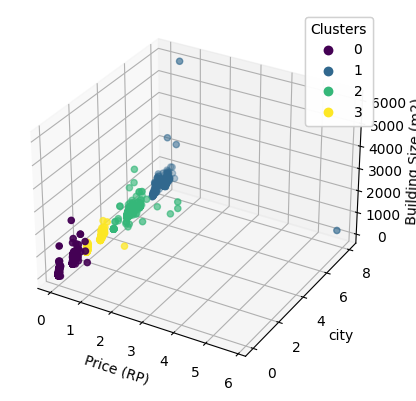

In [ ]:
import matplotlib.pyplot as plt
from mpl_toolkits.mplot3d import Axes3D
import seaborn as sns

plt.figure(figsize=(12, 6))
palette = ['blue', 'red', 'gold', 'green']

# Buat plot 3D
fig = plt.figure()
ax = fig.add_subplot(111, projection='3d')

# Scatter plot
scatter = ax.scatter(df['price_in_rp'], df['city_encoded'], df['building_size_m2'], c=df['Cluster_KM'], cmap='viridis')

# Label sumbu
ax.set_xlabel('Price (RP)')
ax.set_ylabel('city')
ax.set_zlabel('Building Size (m2)')

# Tambahkan legenda
legend = ax.legend(*scatter.legend_elements(), title='Clusters', loc='upper right')
ax.add_artist(legend)

plt.show()


In [ ]:
df

,price_in_rp,city,lat,long,facilities,bedrooms,bathrooms,land_size_m2,building_size_m2,carports,certificate,electricity,property_condition,garages,furnishing,property_condition_encoded,city_encoded,furnishing_encoded,Cluster_KM
0,2.990000e+09,Bekasi,-6.223945,106.986275,"Tempat Jemuran, Jalur Telepon, Taman, Taman",4.0,4.0,239.0,272.0,0.0,shm - sertifikat hak milik,4400 mah,bagus,0.0,unfurnished,0,0,3,0
2,1.950000e+09,Bekasi,-6.223945,106.986275,"Jogging Track, Kolam Renang, Masjid, Taman,...",3.0,3.0,119.0,131.0,1.0,hgb - hak guna bangunan,2200 mah,bagus,1.0,unfurnished,0,0,3,0
3,3.300000e+09,Bekasi,-6.223945,106.986275,"Jalur Telepon, Jogging Track, Track Lari, K...",3.0,3.0,180.0,174.0,0.0,shm - sertifikat hak milik,3500 mah,bagus sekali,2.0,unfurnished,1,0,3,0
4,4.500000e+09,Bekasi,-6.223945,106.986275,"Jogging Track, Kolam Renang, Taman, Jalur Te...",4.0,3.0,328.0,196.0,2.0,shm - sertifikat hak milik,3500 mah,bagus,1.0,unfurnished,0,0,3,0
5,2.700000e+09,Bekasi,-6.223945,106.986275,"Jalur Telepon, Taman, Keamanan, Kolam Renang",3.0,3.0,136.0,200.0,2.0,shm - sertifikat hak milik,3500 mah,bagus,1.0,semi furnished,0,0,2,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
3548,5.880000e+08,Tangerang,-6.296615,106.704601,"Masjid, Taman, Tempat Jemuran, Keamanan 24 ja...",2.0,1.0,72.0,36.0,1.0,shm - sertifikat hak milik,1300 mah,baru,1.0,furnished,2,8,1,1
3549,7.850000e+08,Tangerang,-6.283454,106.638775,"Masjid, Keamanan, Jogging Track, Taman, Tem...",3.0,2.0,85.0,60.0,1.0,shm - sertifikat hak milik,1300 mah,baru,0.0,unfurnished,2,8,3,1
3550,7.550000e+08,Tangerang,-6.283454,106.638775,"Keamanan, Taman, Jogging Track, Tempat Jemur...",3.0,2.0,78.0,60.0,1.0,shm - sertifikat hak milik,1300 mah,baru,0.0,unfurnished,2,8,3,1
3551,8.000000e+08,Tangerang,-6.288237,106.665859,"Tempat Jemuran, Keamanan, Keamanan 24 jam, Was...",3.0,2.0,60.0,65.0,2.0,shm - sertifikat hak milik,2200 mah,baru,0.0,furnished,2,8,1,1


In [ ]:
cluster_1 = df[['lat','long']][df["Cluster_KM"]==0].values.tolist()
cluster_2 = df[['lat','long']][df["Cluster_KM"]==1].values.tolist()
cluster_3 = df[['lat','long']][df["Cluster_KM"]==2].values.tolist()
cluster_4 = df[['lat','long']][df["Cluster_KM"]==3].values.tolist()

In [ ]:
import folium
from folium import plugins
map = folium.Map(location = [-2.548926, 118.0148634], zoom_start = 10, title = "openstreetmap")
map

In [ ]:
for i in cluster_1 :
  folium.CircleMarker(i,radius =2, color = "blue").add_to(map)
for i in cluster_2 :
  folium.CircleMarker(i,radius =2, color = "red").add_to(map)
for i in cluster_3 :
  folium.CircleMarker(i,radius =2, color = "yellow").add_to(map)
for i in cluster_4 :
  folium.CircleMarker(i,radius =2, color = "green").add_to(map)
map

# Hirarki agglomerative clustering

In [ ]:
df = pd.read_csv("/content/gdrive/MyDrive/datamining/jabodetabek_house_price.csv")
print(df.columns)

Index(['url', 'price_in_rp', 'title', 'address', 'district', 'city', 'lat',
       'long', 'facilities', 'property_type', 'ads_id', 'bedrooms',
       'bathrooms', 'land_size_m2', 'building_size_m2', 'carports',
       'certificate', 'electricity', 'maid_bedrooms', 'maid_bathrooms',
       'floors', 'building_age', 'year_built', 'property_condition',
       'building_orientation', 'garages', 'furnishing'],
      dtype='object')


In [ ]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 3553 entries, 0 to 3552
Data columns (total 27 columns):
 #   Column                Non-Null Count  Dtype  
---  ------                --------------  -----  
 0   url                   3553 non-null   object 
 1   price_in_rp           3553 non-null   float64
 2   title                 3553 non-null   object 
 3   address               3553 non-null   object 
 4   district              3553 non-null   object 
 5   city                  3553 non-null   object 
 6   lat                   3553 non-null   float64
 7   long                  3553 non-null   float64
 8   facilities            3553 non-null   object 
 9   property_type         3552 non-null   object 
 10  ads_id                3549 non-null   object 
 11  bedrooms              3519 non-null   float64
 12  bathrooms             3524 non-null   float64
 13  land_size_m2          3551 non-null   float64
 14  building_size_m2      3551 non-null   float64
 15  carports             

In [ ]:
df = df.drop(["url","property_type"], axis = 1)

In [ ]:
df = df.drop(["title","address","ads_id","building_orientation","building_age","year_built","certificate"], axis = 1)


In [ ]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 3553 entries, 0 to 3552
Data columns (total 18 columns):
 #   Column              Non-Null Count  Dtype  
---  ------              --------------  -----  
 0   price_in_rp         3553 non-null   float64
 1   district            3553 non-null   object 
 2   city                3553 non-null   object 
 3   lat                 3553 non-null   float64
 4   long                3553 non-null   float64
 5   facilities          3553 non-null   object 
 6   bedrooms            3519 non-null   float64
 7   bathrooms           3524 non-null   float64
 8   land_size_m2        3551 non-null   float64
 9   building_size_m2    3551 non-null   float64
 10  carports            3553 non-null   float64
 11  electricity         3553 non-null   object 
 12  maid_bedrooms       3553 non-null   float64
 13  maid_bathrooms      3553 non-null   float64
 14  floors              3547 non-null   float64
 15  property_condition  3307 non-null   object 
 16  garage

In [ ]:
df = df[["price_in_rp","lat","long","bedrooms","bathrooms","city","land_size_m2","building_size_m2","carports","maid_bedrooms","maid_bathrooms","floors","garages","property_condition","furnishing"]]

In [ ]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 3553 entries, 0 to 3552
Data columns (total 15 columns):
 #   Column              Non-Null Count  Dtype  
---  ------              --------------  -----  
 0   price_in_rp         3553 non-null   float64
 1   lat                 3553 non-null   float64
 2   long                3553 non-null   float64
 3   bedrooms            3519 non-null   float64
 4   bathrooms           3524 non-null   float64
 5   city                3553 non-null   object 
 6   land_size_m2        3551 non-null   float64
 7   building_size_m2    3551 non-null   float64
 8   carports            3553 non-null   float64
 9   maid_bedrooms       3553 non-null   float64
 10  maid_bathrooms      3553 non-null   float64
 11  floors              3547 non-null   float64
 12  garages             3553 non-null   float64
 13  property_condition  3307 non-null   object 
 14  furnishing          3166 non-null   object 
dtypes: float64(12), object(3)
memory usage: 416.5+ KB


In [ ]:
df = df.dropna()

In [ ]:
from sklearn.preprocessing import LabelEncoder
label_encoder = LabelEncoder()

# Ganti 'kolom1' dan 'kolom2' dengan nama kolom yang sebenarnya di DataFrame Anda
df['property_condition_encoded'] = label_encoder.fit_transform(df['property_condition'])
df['city_encoded'] = label_encoder.fit_transform(df['city'])
df['furnishing_encoded'] = label_encoder.fit_transform(df['furnishing'])

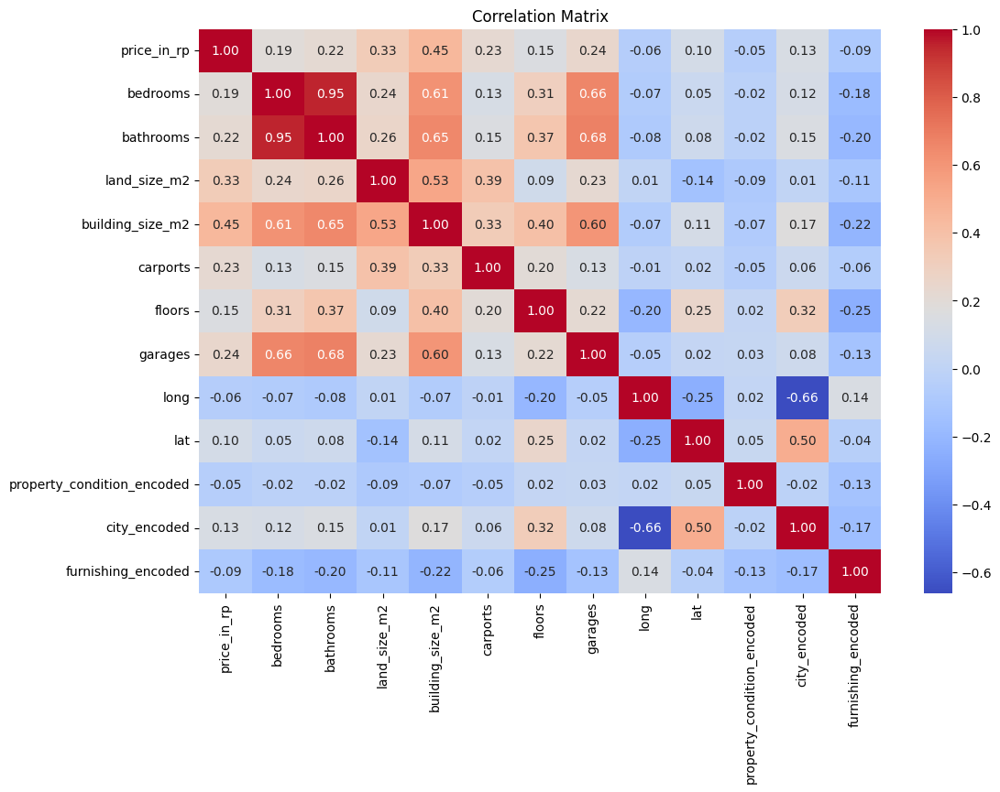

In [ ]:
#  Drop specified columns
# columns_to_drop = ['maid_bedrooms', 'maid_bathrooms']
# df = df.drop(columns=columns_to_drop)

# # Preprocessing data (contoh: menangani missing values, mengkonversi tipe data)
# df = df.fillna(0)  # Misalnya mengisi missing values dengan 0

# Langkah 4: Select numerical columns
numerical_cols = ['price_in_rp', 'bedrooms', 'bathrooms', 'land_size_m2', 'building_size_m2',
                  'carports', 'floors', 'garages', 'long', 'lat','property_condition_encoded','city_encoded','furnishing_encoded']

# Compute correlation matrix
correlation_matrix = df[numerical_cols].corr()

# Plotting the correlation matrix
plt.figure(figsize=(12, 8))
sns.heatmap(correlation_matrix, annot=True, cmap='coolwarm', fmt=".2f")
plt.title('Correlation Matrix')
plt.show()

In [ ]:
from scipy.cluster.hierarchy import dendrogram, linkage

In [ ]:
from sklearn.preprocessing import MinMaxScaler

df2 = df.copy(deep=True)
df2['price_in_rp_scale'] = MinMaxScaler().fit_transform(df2[['price_in_rp']])
df2['land_size_m2_scale'] = MinMaxScaler().fit_transform(df2[['land_size_m2']])
df2['building_size_m2_scale'] = MinMaxScaler().fit_transform(df2[['building_size_m2']])
df2

,price_in_rp,lat,long,bedrooms,bathrooms,city,land_size_m2,building_size_m2,carports,maid_bedrooms,...,floors,garages,property_condition,furnishing,property_condition_encoded,city_encoded,furnishing_encoded,price_in_rp_scale,land_size_m2_scale,building_size_m2_scale
0,2.990000e+09,-6.223945,106.986275,4.0,4.0,Bekasi,239.0,272.0,0.0,0.0,...,2.0,0.0,bagus,unfurnished,0,0,3,0.005083,0.028418,0.045174
2,1.950000e+09,-6.223945,106.986275,3.0,3.0,Bekasi,119.0,131.0,1.0,1.0,...,2.0,1.0,bagus,unfurnished,0,0,3,0.003290,0.013395,0.021670
3,3.300000e+09,-6.223945,106.986275,3.0,3.0,Bekasi,180.0,174.0,0.0,1.0,...,2.0,2.0,bagus sekali,unfurnished,1,0,3,0.005618,0.021032,0.028838
4,4.500000e+09,-6.223945,106.986275,4.0,3.0,Bekasi,328.0,196.0,2.0,1.0,...,2.0,1.0,bagus,unfurnished,0,0,3,0.007687,0.039559,0.032505
5,2.700000e+09,-6.223945,106.986275,3.0,3.0,Bekasi,136.0,200.0,2.0,1.0,...,2.0,1.0,bagus,semi furnished,0,0,2,0.004583,0.015523,0.033172
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
3548,5.880000e+08,-6.296615,106.704601,2.0,1.0,Tangerang,72.0,36.0,1.0,0.0,...,1.0,1.0,baru,furnished,2,8,1,0.000941,0.007511,0.005834
3549,7.850000e+08,-6.283454,106.638775,3.0,2.0,Tangerang,85.0,60.0,1.0,0.0,...,2.0,0.0,baru,unfurnished,2,8,3,0.001281,0.009139,0.009835
3550,7.550000e+08,-6.283454,106.638775,3.0,2.0,Tangerang,78.0,60.0,1.0,0.0,...,2.0,0.0,baru,unfurnished,2,8,3,0.001229,0.008262,0.009835
3551,8.000000e+08,-6.288237,106.665859,3.0,2.0,Tangerang,60.0,65.0,2.0,0.0,...,2.0,0.0,baru,furnished,2,8,1,0.001307,0.006009,0.010668


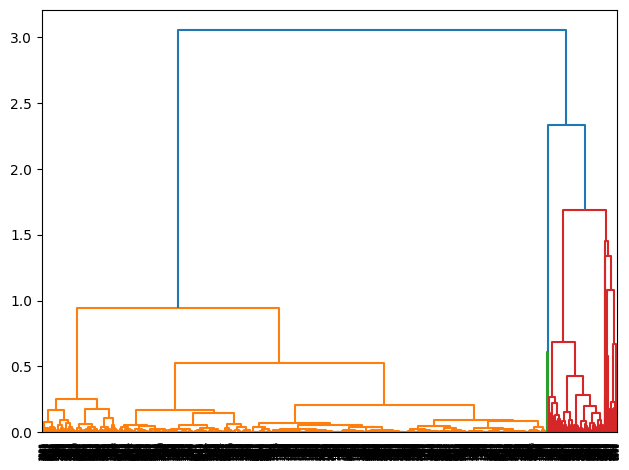

In [ ]:
linkage_data = linkage(df2[['price_in_rp_scale','land_size_m2_scale','building_size_m2_scale']], method = 'ward', metric = 'euclidean')
dendrogram(linkage_data)

plt.tight_layout()
plt.show()

In [ ]:
from sklearn.cluster import AgglomerativeClustering
hierarchical_cluster = AgglomerativeClustering(n_clusters = 4, affinity = 'euclidean', linkage = 'ward')
labels = hierarchical_cluster.fit(df2[['price_in_rp_scale','land_size_m2_scale','building_size_m2_scale']])

pred_agc = pd.Series(hierarchical_cluster.labels_)
df2['Cluster_HA'] = pred_agc; df['Cluster_HA'] = pred_agc

/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_agglomerative.py:983: FutureWarning: Attribute `affinity` was deprecated in version 1.2 and will be removed in 1.4. Use `metric` instead
  warnings.warn(


In [ ]:
hierarchical_cluster.labels_

array([1, 1, 1, ..., 1, 1, 1])

In [ ]:
from sklearn import metrics
labels = hierarchical_cluster.labels_
metrics.silhouette_score(df2[['price_in_rp_scale','land_size_m2_scale','building_size_m2_scale']], labels, metric='euclidean')

0.7053259063065724

In [ ]:
cluster_111 = df[['lat','long']][df["Cluster_HA"]==0].values.tolist()
cluster_222 = df[['lat','long']][df["Cluster_HA"]==1].values.tolist()
cluster_333 = df[['lat','long']][df["Cluster_HA"]==2].values.tolist()
cluster_444 = df[['lat','long']][df["Cluster_HA"]==3].values.tolist()

In [ ]:
import folium
from folium import plugins
map = folium.Map(location = [-2.548926, 118.0148634], zoom_start = 10, title = "openstreetmap")
map

In [ ]:
for i in cluster_111 :
  folium.CircleMarker(i,radius =2, color = "blue").add_to(map)
for i in cluster_222 :
  folium.CircleMarker(i,radius =2, color = "red").add_to(map)
for i in cluster_333 :
  folium.CircleMarker(i,radius =2, color = "yellow").add_to(map)
for i in cluster_444 :
  folium.CircleMarker(i,radius =2, color = "green").add_to(map)
map

# Divisive Hierarchical Clustering

In [ ]:
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
from scipy.spatial.distance import pdist, squareform
from scipy.cluster.hierarchy import fcluster, dendrogram, linkage
from sklearn.preprocessing import MinMaxScaler, LabelEncoder
from sklearn.metrics import silhouette_score

# Load data
df = pd.read_csv("/content/gdrive/MyDrive/datamining/jabodetabek_house_price.csv")

# Drop unnecessary columns
df = df.drop(["url", "property_type", "title", "address", "ads_id", "building_orientation",
              "building_age", "year_built", "certificate"], axis=1)

# Keep selected columns
df = df[["price_in_rp", "lat", "long", "bedrooms", "bathrooms", "city",
         "land_size_m2", "building_size_m2", "carports", "maid_bedrooms",
         "maid_bathrooms", "floors", "garages", "property_condition", "furnishing"]]

# Drop rows with missing values
df = df.dropna()


In [ ]:
# Encode categorical variables
label_encoder = LabelEncoder()
df['property_condition_encoded'] = label_encoder.fit_transform(df['property_condition'])
df['city_encoded'] = label_encoder.fit_transform(df['city'])
df['furnishing_encoded'] = label_encoder.fit_transform(df['furnishing'])


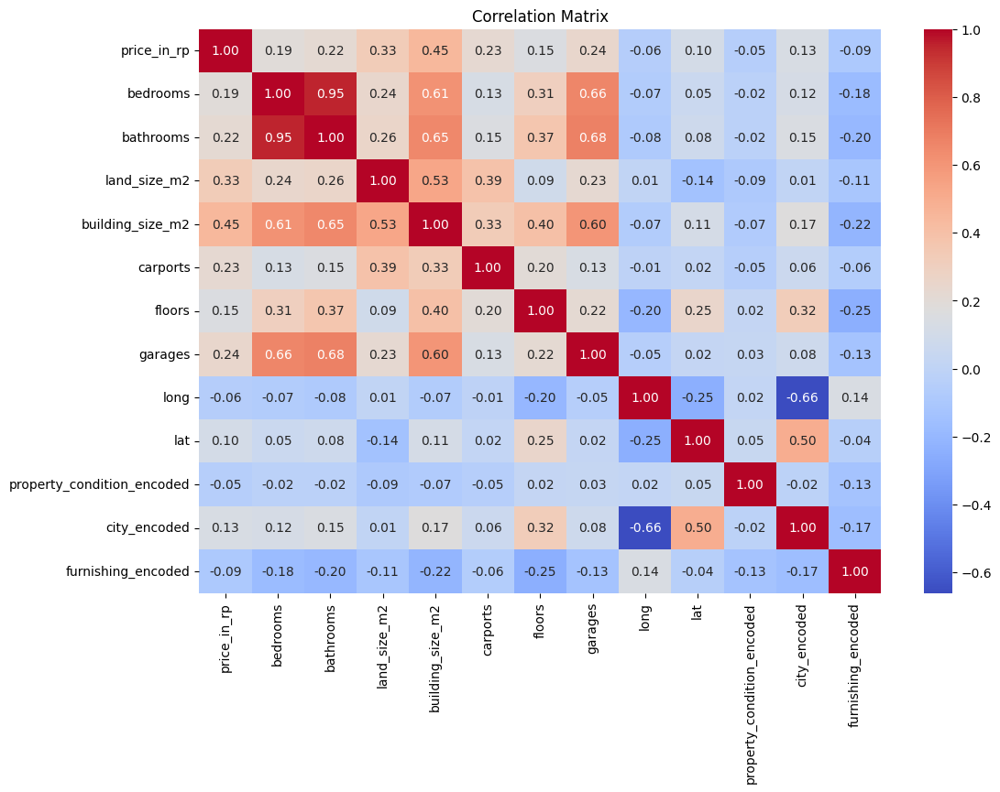

In [ ]:
# Select numerical columns
numerical_cols = ['price_in_rp', 'bedrooms', 'bathrooms', 'land_size_m2', 'building_size_m2',
                  'carports', 'floors', 'garages', 'long', 'lat', 'property_condition_encoded',
                  'city_encoded', 'furnishing_encoded']

# Compute correlation matrix
correlation_matrix = df[numerical_cols].corr()

# Plot the correlation matrix
plt.figure(figsize=(12, 8))
sns.heatmap(correlation_matrix, annot=True, cmap='coolwarm', fmt=".2f")
plt.title('Correlation Matrix')
plt.show()

In [ ]:
# Scale data
scaler = MinMaxScaler()
df[['price_in_rp_scale', 'land_size_m2_scale', 'building_size_m2_scale']] = scaler.fit_transform(df[['price_in_rp', 'land_size_m2', 'building_size_m2']])

In [ ]:
# Compute distance matrix
dist_matrix = pdist(df[['price_in_rp_scale', 'land_size_m2_scale', 'building_size_m2_scale']], metric='euclidean')

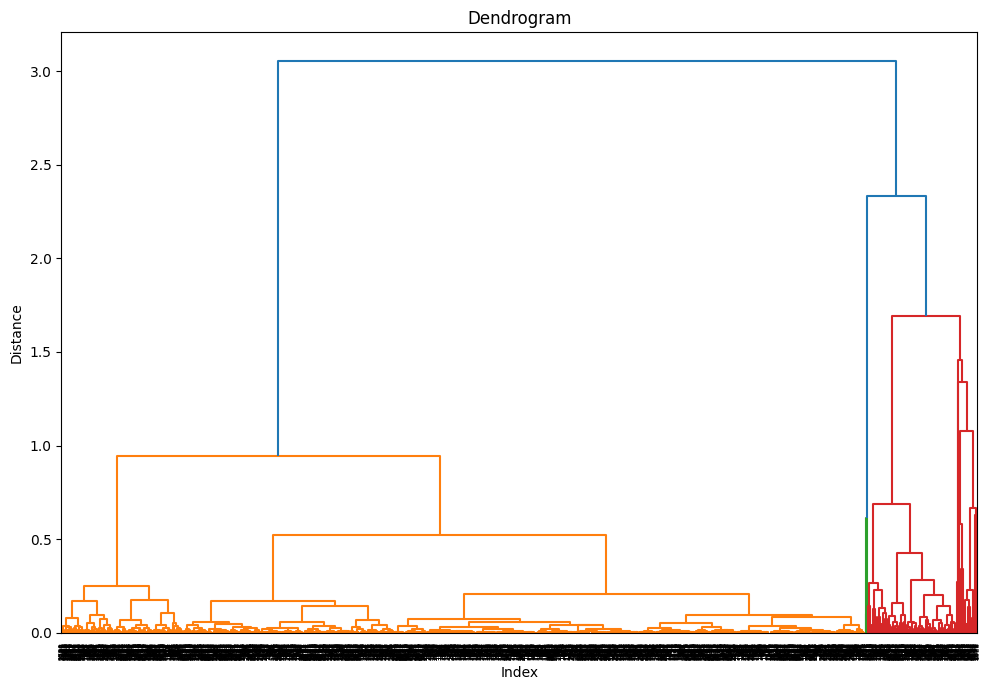

In [ ]:
# Hierarchical clustering using ward linkage
linkage_data = linkage(dist_matrix, method='ward')

# Plot dendrogram
plt.figure(figsize=(10, 7))
dendrogram(linkage_data)
plt.title('Dendrogram')
plt.xlabel('Index')
plt.ylabel('Distance')
plt.tight_layout()
plt.show()

In [ ]:
# Divisive Clustering
# Here we manually split the cluster by finding the largest gap in the dendrogram and splitting there

def divisive_clustering(linkage_data, n_clusters):
    from scipy.cluster.hierarchy import fcluster

    # Split into n_clusters by cutting the dendrogram at the appropriate level
    cluster_labels = fcluster(linkage_data, n_clusters, criterion='maxclust')

    return cluster_labels

# Apply divisive clustering
n_clusters = 4
df['Cluster_DHC'] = divisive_clustering(linkage_data, n_clusters)

# Compute silhouette score
labels = df['Cluster_DHC']
sil_score = silhouette_score(df[['price_in_rp_scale', 'land_size_m2_scale', 'building_size_m2_scale']], labels, metric='euclidean')
print(f'Silhouette Score for Divisive Hierarchical Clustering: {sil_score}')

Silhouette Score for Divisive Hierarchical Clustering: 0.7053259063065724


# Ward Hierarchical Clustering

In [ ]:
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
from sklearn.preprocessing import LabelEncoder, MinMaxScaler
from scipy.cluster.hierarchy import dendrogram, linkage
from sklearn.metrics import silhouette_score

# Load data
df = pd.read_csv("/content/gdrive/MyDrive/datamining/jabodetabek_house_price.csv")
print(df.columns)

# Display info about the dataset
df.info()

# Drop unnecessary columns
df = df.drop(["url", "property_type", "title", "address", "ads_id", "building_orientation",
              "building_age", "year_built", "certificate"], axis=1)

# Keep selected columns
df = df[["price_in_rp", "lat", "long", "bedrooms", "bathrooms", "city",
         "land_size_m2", "building_size_m2", "carports", "maid_bedrooms",
         "maid_bathrooms", "floors", "garages", "property_condition", "furnishing"]]

# Drop rows with missing values
df = df.dropna()

Index(['url', 'price_in_rp', 'title', 'address', 'district', 'city', 'lat',
       'long', 'facilities', 'property_type', 'ads_id', 'bedrooms',
       'bathrooms', 'land_size_m2', 'building_size_m2', 'carports',
       'certificate', 'electricity', 'maid_bedrooms', 'maid_bathrooms',
       'floors', 'building_age', 'year_built', 'property_condition',
       'building_orientation', 'garages', 'furnishing'],
      dtype='object')
<class 'pandas.core.frame.DataFrame'>
RangeIndex: 3553 entries, 0 to 3552
Data columns (total 27 columns):
 #   Column                Non-Null Count  Dtype  
---  ------                --------------  -----  
 0   url                   3553 non-null   object 
 1   price_in_rp           3553 non-null   float64
 2   title                 3553 non-null   object 
 3   address               3553 non-null   object 
 4   district              3553 non-null   object 
 5   city                  3553 non-null   object 
 6   lat                   3553 non-null   float64
 7

In [ ]:
# Encode categorical variables
label_encoder = LabelEncoder()
df['property_condition_encoded'] = label_encoder.fit_transform(df['property_condition'])
df['city_encoded'] = label_encoder.fit_transform(df['city'])
df['furnishing_encoded'] = label_encoder.fit_transform(df['furnishing'])

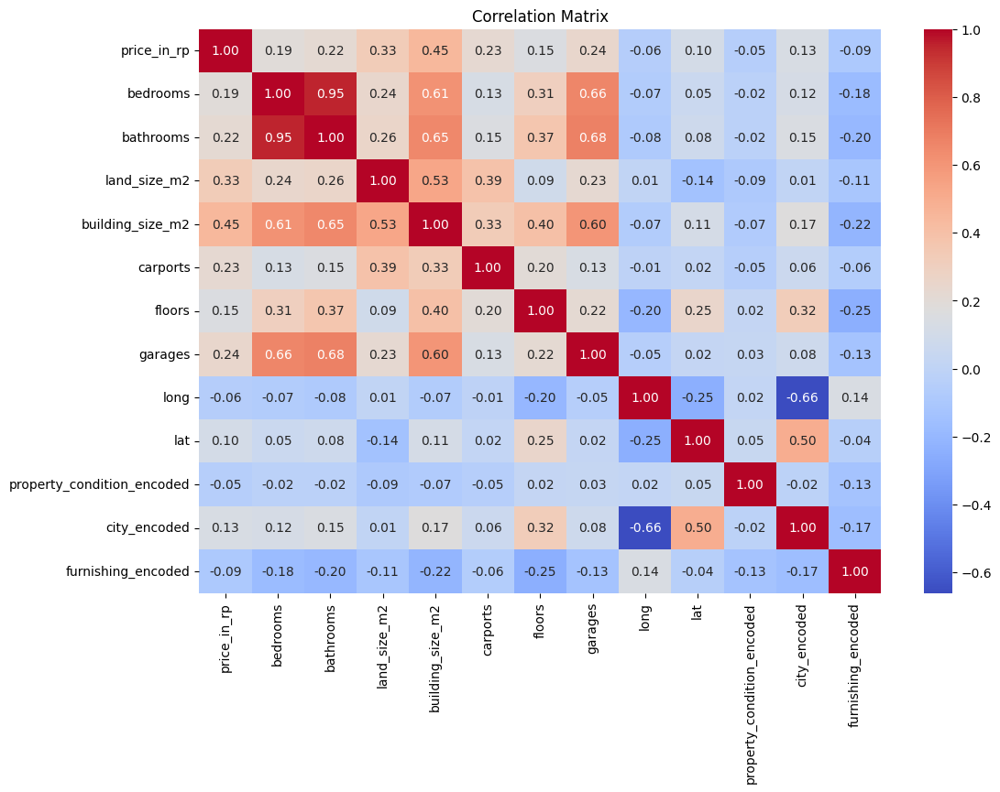

In [ ]:
# Select numerical columns
numerical_cols = ['price_in_rp', 'bedrooms', 'bathrooms', 'land_size_m2', 'building_size_m2',
                  'carports', 'floors', 'garages', 'long', 'lat', 'property_condition_encoded',
                  'city_encoded', 'furnishing_encoded']

# Compute correlation matrix
correlation_matrix = df[numerical_cols].corr()

# Plot the correlation matrix
plt.figure(figsize=(12, 8))
sns.heatmap(correlation_matrix, annot=True, cmap='coolwarm', fmt=".2f")
plt.title('Correlation Matrix')
plt.show()



In [ ]:
# Scale data
scaler = MinMaxScaler()
df2 = df.copy(deep=True)
df2[['price_in_rp_scale', 'land_size_m2_scale', 'building_size_m2_scale']] = scaler.fit_transform(
    df[['price_in_rp', 'land_size_m2', 'building_size_m2']])

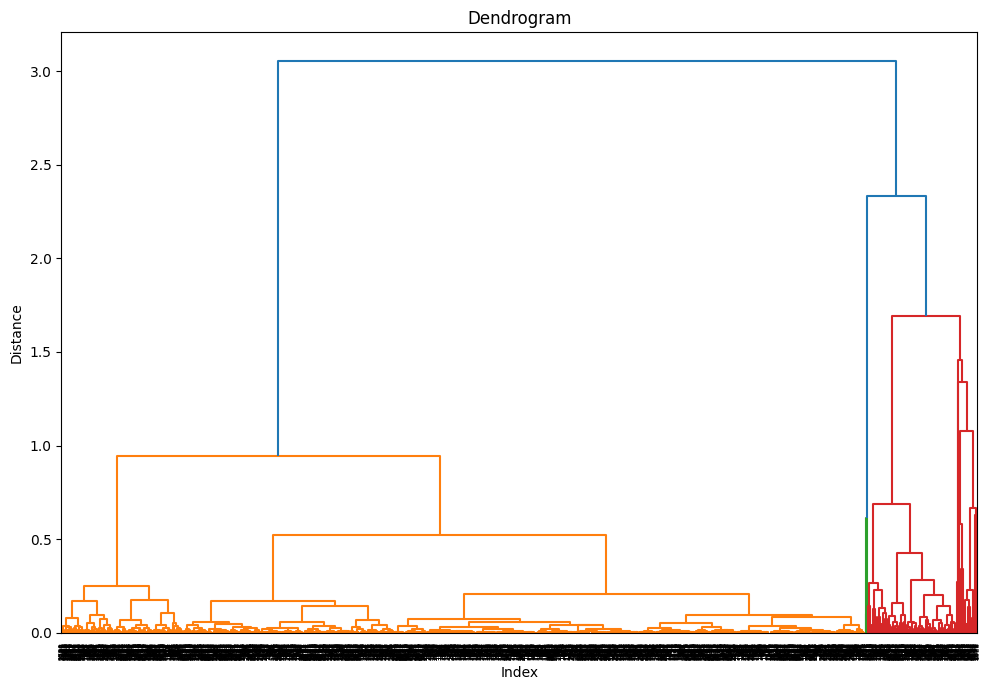

In [ ]:
# Compute linkage matrix using Ward's method
linkage_data = linkage(df2[['price_in_rp_scale', 'land_size_m2_scale', 'building_size_m2_scale']], method='ward')

# Plot dendrogram
plt.figure(figsize=(10, 7))
dendrogram(linkage_data)
plt.title('Dendrogram')
plt.xlabel('Index')
plt.ylabel('Distance')
plt.tight_layout()
plt.show()

In [ ]:
# Apply Ward Hierarchical Clustering
from sklearn.cluster import AgglomerativeClustering

# Number of clusters
n_clusters = 4
hierarchical_cluster = AgglomerativeClustering(n_clusters=n_clusters, affinity='euclidean', linkage='ward')
labels = hierarchical_cluster.fit_predict(df2[['price_in_rp_scale', 'land_size_m2_scale', 'building_size_m2_scale']])

# Add cluster labels to the DataFrame
df2['Cluster_Ward'] = labels
df['Cluster_Ward'] = labels

# Display cluster labels
print(hierarchical_cluster.labels_)

# Compute silhouette score
sil_score = silhouette_score(df2[['price_in_rp_scale', 'land_size_m2_scale', 'building_size_m2_scale']], labels, metric='euclidean')
print(f'Silhouette Score for Ward Hierarchical Clustering: {sil_score}')

/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_agglomerative.py:983: FutureWarning: Attribute `affinity` was deprecated in version 1.2 and will be removed in 1.4. Use `metric` instead
  warnings.warn(


[1 1 1 ... 1 1 1]
Silhouette Score for Ward Hierarchical Clustering: 0.7053259063065724


# K Medians Cluster (7 fitur)

In [ ]:
!pip install scikit-learn-extra


     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 2.0/2.0 MB 7.9 MB/s eta 0:00:00


0.0
0.9999999999999999
0.0
0.9999999999999998
0.0
1.0
0.0
1.0
0.0
1.0
0.0
1.0
0.0
0.9999999999999999


/usr/local/lib/python3.10/dist-packages/sklearn_extra/cluster/_k_medoids.py:329: UserWarning: Cluster 2 is empty! self.labels_[self.medoid_indices_[2]] may not be labeled with its corresponding cluster (2).
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/sklearn_extra/cluster/_k_medoids.py:329: UserWarning: Cluster 1 is empty! self.labels_[self.medoid_indices_[1]] may not be labeled with its corresponding cluster (1).
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/sklearn_extra/cluster/_k_medoids.py:329: UserWarning: Cluster 1 is empty! self.labels_[self.medoid_indices_[1]] may not be labeled with its corresponding cluster (1).
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/sklearn_extra/cluster/_k_medoids.py:329: UserWarning: Cluster 1 is empty! self.labels_[self.medoid_indices_[1]] may not be labeled with its corresponding cluster (1).
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/sklearn_extra/cluster/_k_medoids.py:329: UserWarning: Cluster 5 

[1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15]
[968.451548869496, 382.4478100059532, 376.965694725935, 251.80280122842794, 239.86203474614086, 238.26723313900007, 237.31374096545196, 236.83817517158946, 223.3729099738449, 221.9175045892112, 219.35014329831358, 219.1991967337255, 219.23738994855177, 211.03960206694518, 164.62839501299956]


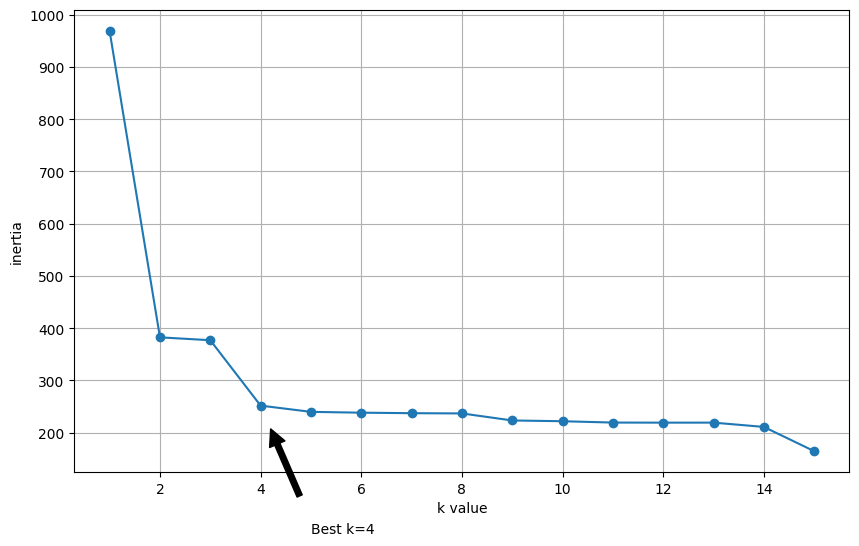

/usr/local/lib/python3.10/dist-packages/sklearn_extra/cluster/_k_medoids.py:329: UserWarning: Cluster 1 is empty! self.labels_[self.medoid_indices_[1]] may not be labeled with its corresponding cluster (1).
  warnings.warn(


,price_in_rp,city,lat,long,facilities,bedrooms,bathrooms,land_size_m2,building_size_m2,carports,certificate,electricity,property_condition,garages,furnishing,property_condition_encoded,city_encoded,furnishing_encoded,Cluster_KM
0,2.990000e+09,Bekasi,-6.223945,106.986275,"Tempat Jemuran, Jalur Telepon, Taman, Taman",4.0,4.0,239.0,272.0,0.0,shm - sertifikat hak milik,4400 mah,bagus,0.0,unfurnished,0,0,3,3
2,1.950000e+09,Bekasi,-6.223945,106.986275,"Jogging Track, Kolam Renang, Masjid, Taman,...",3.0,3.0,119.0,131.0,1.0,hgb - hak guna bangunan,2200 mah,bagus,1.0,unfurnished,0,0,3,3
3,3.300000e+09,Bekasi,-6.223945,106.986275,"Jalur Telepon, Jogging Track, Track Lari, K...",3.0,3.0,180.0,174.0,0.0,shm - sertifikat hak milik,3500 mah,bagus sekali,2.0,unfurnished,1,0,3,3
4,4.500000e+09,Bekasi,-6.223945,106.986275,"Jogging Track, Kolam Renang, Taman, Jalur Te...",4.0,3.0,328.0,196.0,2.0,shm - sertifikat hak milik,3500 mah,bagus,1.0,unfurnished,0,0,3,3
5,2.700000e+09,Bekasi,-6.223945,106.986275,"Jalur Telepon, Taman, Keamanan, Kolam Renang",3.0,3.0,136.0,200.0,2.0,shm - sertifikat hak milik,3500 mah,bagus,1.0,semi furnished,0,0,2,3
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
3548,5.880000e+08,Tangerang,-6.296615,106.704601,"Masjid, Taman, Tempat Jemuran, Keamanan 24 ja...",2.0,1.0,72.0,36.0,1.0,shm - sertifikat hak milik,1300 mah,baru,1.0,furnished,2,8,1,2
3549,7.850000e+08,Tangerang,-6.283454,106.638775,"Masjid, Keamanan, Jogging Track, Taman, Tem...",3.0,2.0,85.0,60.0,1.0,shm - sertifikat hak milik,1300 mah,baru,0.0,unfurnished,2,8,3,2
3550,7.550000e+08,Tangerang,-6.283454,106.638775,"Keamanan, Taman, Jogging Track, Tempat Jemur...",3.0,2.0,78.0,60.0,1.0,shm - sertifikat hak milik,1300 mah,baru,0.0,unfurnished,2,8,3,2
3551,8.000000e+08,Tangerang,-6.288237,106.665859,"Tempat Jemuran, Keamanan, Keamanan 24 jam, Was...",3.0,2.0,60.0,65.0,2.0,shm - sertifikat hak milik,2200 mah,baru,0.0,furnished,2,8,1,2


,price_in_rp,city,lat,long,facilities,bedrooms,bathrooms,land_size_m2,building_size_m2,carports,...,city_encoded,furnishing_encoded,Cluster_KM,price_in_rp_scale,city_encoded_scale,building_size_m2_scale,land_size_m2_scale,carports_scale,garages_scale,bathrooms_scale
0,2.990000e+09,Bekasi,-6.223945,106.986275,"Tempat Jemuran, Jalur Telepon, Taman, Taman",4.0,4.0,239.0,272.0,0.0,...,0,3,3,0.005083,0.0,0.042461,0.028418,0.000000,0.00,0.030612
2,1.950000e+09,Bekasi,-6.223945,106.986275,"Jogging Track, Kolam Renang, Masjid, Taman,...",3.0,3.0,119.0,131.0,1.0,...,0,3,3,0.003290,0.0,0.018890,0.013395,0.071429,0.02,0.020408
3,3.300000e+09,Bekasi,-6.223945,106.986275,"Jalur Telepon, Jogging Track, Track Lari, K...",3.0,3.0,180.0,174.0,0.0,...,0,3,3,0.005618,0.0,0.026078,0.021032,0.000000,0.04,0.020408
4,4.500000e+09,Bekasi,-6.223945,106.986275,"Jogging Track, Kolam Renang, Taman, Jalur Te...",4.0,3.0,328.0,196.0,2.0,...,0,3,3,0.007687,0.0,0.029756,0.039559,0.142857,0.02,0.020408
5,2.700000e+09,Bekasi,-6.223945,106.986275,"Jalur Telepon, Taman, Keamanan, Kolam Renang",3.0,3.0,136.0,200.0,2.0,...,0,2,3,0.004583,0.0,0.030425,0.015523,0.142857,0.02,0.020408
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
3548,5.880000e+08,Tangerang,-6.296615,106.704601,"Masjid, Taman, Tempat Jemuran, Keamanan 24 ja...",2.0,1.0,72.0,36.0,1.0,...,8,1,2,0.000941,1.0,0.003009,0.007511,0.071429,0.02,0.000000
3549,7.850000e+08,Tangerang,-6.283454,106.638775,"Masjid, Keamanan, Jogging Track, Taman, Tem...",3.0,2.0,85.0,60.0,1.0,...,8,3,2,0.001281,1.0,0.007021,0.009139,0.071429,0.00,0.010204
3550,7.550000e+08,Tangerang,-6.283454,106.638775,"Keamanan, Taman, Jogging Track, Tempat Jemur...",3.0,2.0,78.0,60.0,1.0,...,8,3,2,0.001229,1.0,0.007021,0.008262,0.071429,0.00,0.010204
3551,8.000000e+08,Tangerang,-6.288237,106.665859,"Tempat Jemuran, Keamanan, Keamanan 24 jam, Was...",3.0,2.0,60.0,65.0,2.0,...,8,1,2,0.001307,1.0,0.007857,0.006009,0.142857,0.00,0.010204


Cluster_KM
3    1195
2     756
1     577
0     322
Name: count, dtype: int64
Silhouette Score for K=4: 0.5374249003130218


/usr/local/lib/python3.10/dist-packages/sklearn_extra/cluster/_k_medoids.py:329: UserWarning: Cluster 1 is empty! self.labels_[self.medoid_indices_[1]] may not be labeled with its corresponding cluster (1).
  warnings.warn(


Silhouette Score for K=6: 0.5374249003130218


In [ ]:
# Import necessary libraries
from sklearn.preprocessing import MinMaxScaler
import pandas as pd
from sklearn_extra.cluster import KMedoids
from sklearn import metrics
import matplotlib.pyplot as plt

# Assuming df is your initial dataframe
df2 = df.copy(deep=True)

# Scale the features
scaler = MinMaxScaler()
df2['price_in_rp_scale'] = scaler.fit_transform(df2[['price_in_rp']])
df2['city_encoded_scale'] = scaler.fit_transform(df2[['city_encoded']])
df2['building_size_m2_scale'] = scaler.fit_transform(df2[['building_size_m2']])
df2['land_size_m2_scale'] = scaler.fit_transform(df2[['land_size_m2']])
df2['carports_scale'] = scaler.fit_transform(df2[['carports']])
df2['garages_scale'] = scaler.fit_transform(df2[['garages']])
df2['bathrooms_scale'] = scaler.fit_transform(df2[['bathrooms']])


# Print min and max values for scaled features
print(df2['price_in_rp_scale'].min())
print(df2['price_in_rp_scale'].max())
print(df2['land_size_m2_scale'].min())
print(df2['land_size_m2_scale'].max())
print(df2['building_size_m2_scale'].min())
print(df2['building_size_m2_scale'].max())
print(df2['city_encoded_scale'].min())
print(df2['city_encoded_scale'].max())
print(df2['carports_scale'].min())
print(df2['carports_scale'].max())
print(df2['garages_scale'].min())
print(df2['garages_scale'].max())
print(df2['bathrooms_scale'].min())
print(df2['bathrooms_scale'].max())

# Determine the optimal number of clusters
k = range(1, 16)
inertia = []

for i in k:
    km_model = KMedoids(n_clusters=i, random_state=1)
    km_model.fit(df2[['price_in_rp_scale', 'land_size_m2_scale', 'building_size_m2_scale', 'city_encoded_scale', 'garages_scale', 'carports_scale', 'bathrooms_scale']])
    inertia.append(km_model.inertia_)

print(list(k))
print(inertia)

# Plot the elbow graph
plt.figure(figsize=(10,6))
plt.plot(k, inertia, marker='o')
plt.xlabel('k value')
plt.ylabel('inertia')
plt.annotate('Best k=4', xy=(k[3], inertia[3]), xytext=(5, 8), arrowprops=dict(facecolor='black', shrink=0.2))
plt.grid()
plt.show()

# Apply K-Medians with the optimal number of clusters
kn5 = KMedoids(n_clusters=4, random_state=1)
kn5.fit(df2[['price_in_rp_scale', 'land_size_m2_scale', 'building_size_m2_scale', 'city_encoded_scale', 'garages_scale', 'carports_scale', 'bathrooms_scale']])

# Assign cluster labels
df['Cluster_KM'] = kn5.predict(df2[['price_in_rp_scale', 'land_size_m2_scale', 'building_size_m2_scale', 'city_encoded_scale', 'garages_scale', 'carports_scale', 'bathrooms_scale']])
df2['Cluster_KM'] = kn5.predict(df2[['price_in_rp_scale', 'land_size_m2_scale', 'building_size_m2_scale', 'city_encoded_scale', 'garages_scale', 'carports_scale', 'bathrooms_scale']])

# Display dataframes
display(df)
display(df2)

# Count number of data points in each cluster
print(df['Cluster_KM'].value_counts())

# Calculate silhouette score for the clustering
labels = kn5.labels_
silhouette_score = metrics.silhouette_score(df2[['price_in_rp_scale', 'land_size_m2_scale', 'building_size_m2_scale', 'city_encoded_scale', 'garages_scale', 'carports_scale', 'bathrooms_scale']], labels, metric='euclidean')
print('Silhouette Score for K=4:', silhouette_score)

# Experiment with another number of clusters (e.g., 6)
kn5_b = KMedoids(n_clusters=4, random_state=1)
kn5_b.fit(df2[['price_in_rp_scale', 'land_size_m2_scale', 'building_size_m2_scale', 'city_encoded_scale', 'garages_scale', 'carports_scale', 'bathrooms_scale']])
labels_b = kn5_b.labels_
silhouette_score_b = metrics.silhouette_score(df2[['price_in_rp_scale', 'land_size_m2_scale', 'building_size_m2_scale', 'city_encoded_scale', 'garages_scale', 'carports_scale', 'bathrooms_scale']], labels_b, metric='euclidean')
print('Silhouette Score for K=6:', silhouette_score_b)


In [ ]:
df.to_csv("cluster_kmedians.csv")

In [ ]:
df[df["Cluster_KM"]==0].head(10)

,price_in_rp,city,lat,long,facilities,bedrooms,bathrooms,land_size_m2,building_size_m2,carports,certificate,electricity,property_condition,garages,furnishing,property_condition_encoded,city_encoded,furnishing_encoded,Cluster_KM
2038,1.710000e+09,Jakarta Selatan,-6.330417,106.825463,"AC, Jogging Track, Ac, Kolam Renang, Jalur...",3.0,3.0,80.0,130.0,1.0,shm - sertifikat hak milik,2200 mah,baru,1.0,semi furnished,2,5,2,0
2039,1.950000e+09,Jakarta Selatan,-6.330417,106.825463,"Kolam Renang, Taman, Kolam Renang, Keamanan,...",4.0,4.0,95.0,150.0,2.0,shm - sertifikat hak milik,2200 mah,baru,0.0,semi furnished,2,5,2,0
2041,2.400000e+09,Jakarta Selatan,-6.330417,106.825463,"Ac, AC",4.0,4.0,113.0,160.0,2.0,shm - sertifikat hak milik,2200 mah,baru,2.0,semi furnished,2,5,2,0
2042,1.550000e+09,Jakarta Selatan,-6.330417,106.825463,"Jogging Track, Track Lari, One Gate System,...",3.0,3.0,70.0,120.0,0.0,shm - sertifikat hak milik,2200 mah,baru,1.0,semi furnished,2,5,2,0
2043,6.950000e+08,Jakarta Selatan,-6.330417,106.825463,"Keamanan, Keamanan 24 jam, AC, Masjid, Masji...",2.0,2.0,40.0,80.0,1.0,shm - sertifikat hak milik,2200 mah,baru,0.0,unfurnished,2,5,3,0
2044,2.640000e+09,Jakarta Selatan,-6.330417,106.825463,"Tempat Jemuran, Keamanan 24 jam, Taman",4.0,4.0,110.0,140.0,1.0,shm - sertifikat hak milik,2200 mah,bagus,0.0,unfurnished,0,5,3,0
2045,4.500000e+09,Jakarta Selatan,-6.330417,106.825463,"Kolam Renang, Taman",4.0,4.0,168.0,230.0,1.0,shm - sertifikat hak milik,3300 mah,baru,2.0,unfurnished,2,5,3,0
2046,2.640000e+09,Jakarta Selatan,-6.330417,106.825463,"Taman, Keamanan",4.0,4.0,110.0,140.0,0.0,shm - sertifikat hak milik,2200 mah,bagus,1.0,unfurnished,0,5,3,0
2048,1.450000e+09,Jakarta Selatan,-6.330417,106.825463,"Taman, Keamanan, Ac, Jalur Telepon, Keamanan...",3.0,3.0,97.0,130.0,2.0,shm - sertifikat hak milik,2200 mah,baru,2.0,semi furnished,2,5,2,0
2049,3.700000e+09,Jakarta Selatan,-6.330417,106.825463,"Tempat Jemuran, Kitchen Set, Taman, Keamanan",4.0,4.0,112.0,240.0,2.0,shm - sertifikat hak milik,2200 mah,baru,2.0,unfurnished,2,5,3,0


In [ ]:
df[df["Cluster_KM"]==1].head(10)

,price_in_rp,city,lat,long,facilities,bedrooms,bathrooms,land_size_m2,building_size_m2,carports,certificate,electricity,property_condition,garages,furnishing,property_condition_encoded,city_encoded,furnishing_encoded,Cluster_KM
1467,7.990000e+08,Depok,-6.399113,106.799954,Taman,3.0,2.0,74.0,70.0,1.0,shm - sertifikat hak milik,2200 mah,baru,0.0,unfurnished,2,2,3,1
1468,8.110000e+08,Depok,-6.399113,106.799954,"Masjid, CCTV, Keamanan, Taman",3.0,2.0,72.0,70.0,0.0,shm - sertifikat hak milik,1300 mah,baru,2.0,unfurnished,2,2,3,1
1469,6.600000e+08,Depok,-6.399113,106.799954,"Keamanan, Taman",2.0,1.0,80.0,45.0,0.0,shm - sertifikat hak milik,2200 mah,bagus,1.0,unfurnished,0,2,3,1
1471,3.300000e+08,Depok,-6.399113,106.799954,"Tempat Jemuran, Akses Parkir, One Gate Syste...",2.0,1.0,60.0,40.0,1.0,shm - sertifikat hak milik,1300 mah,baru,1.0,semi furnished,2,2,2,1
1472,1.200000e+09,Depok,-6.399113,106.799954,"Keamanan, Taman",3.0,3.0,120.0,100.0,1.0,shm - sertifikat hak milik,2200 mah,bagus,0.0,unfurnished,0,2,3,1
1473,6.600000e+08,Depok,-6.399113,106.799954,"Keamanan, Taman",2.0,1.0,80.0,45.0,0.0,shm - sertifikat hak milik,2200 mah,bagus,1.0,unfurnished,0,2,3,1
1474,2.280000e+09,Depok,-6.399113,106.799954,"Keamanan, Taman",3.0,4.0,180.0,200.0,1.0,shm - sertifikat hak milik,2200 mah,bagus,1.0,unfurnished,0,2,3,1
1475,7.900000e+08,Depok,-6.399113,106.799954,"Tempat Jemuran, Ac, Jogging Track, Track Lar...",3.0,2.0,72.0,85.0,1.0,shm - sertifikat hak milik,2200 mah,baru,1.0,semi furnished,2,2,2,1
1476,6.900000e+08,Depok,-6.399113,106.799954,"Jogging Track, AC, Masjid, CCTV, Wastafel, ...",2.0,1.0,75.0,50.0,1.0,shm - sertifikat hak milik,2200 mah,baru,1.0,semi furnished,2,2,2,1
1477,1.030000e+09,Depok,-6.399113,106.799954,"Jalur Telepon, Taman, Keamanan",3.0,2.0,83.0,90.0,0.0,shm - sertifikat hak milik,2200 mah,baru,0.0,unfurnished,2,2,3,1


In [ ]:
df[df["Cluster_KM"]==2].head(10)

,price_in_rp,city,lat,long,facilities,bedrooms,bathrooms,land_size_m2,building_size_m2,carports,certificate,electricity,property_condition,garages,furnishing,property_condition_encoded,city_encoded,furnishing_encoded,Cluster_KM
2095,2.900000e+10,Jakarta Utara,-6.102478,106.74119,"AC, Kolam Renang, Jalur Telepon, Keamanan 24...",4.0,4.0,450.0,850.0,2.0,shm - sertifikat hak milik,8000 mah,bagus,2.0,semi furnished,0,7,2,2
2096,7.700000e+09,Jakarta Utara,-6.102478,106.74119,"Keamanan 24 jam, Taman, Keamanan",4.0,3.0,200.0,400.0,0.0,shm - sertifikat hak milik,4400 mah,bagus,0.0,semi furnished,0,7,2,2
2098,1.800000e+10,Jakarta Utara,-6.102478,106.74119,"Jalur Telepon, Keamanan 24 jam, Kitchen Set, O...",5.0,3.0,450.0,600.0,0.0,shm - sertifikat hak milik,lainnya mah,bagus,0.0,semi furnished,0,7,2,2
2100,2.500000e+10,Jakarta Utara,-6.102478,106.74119,"Jalur Telepon, AC, Taman",6.0,6.0,785.0,839.0,0.0,shm - sertifikat hak milik,lainnya mah,bagus,0.0,semi furnished,0,7,2,2
2101,1.000000e+10,Jakarta Utara,-6.102478,106.74119,"Jalur Telepon, Kitchen Set, Wastafel, Keamanan...",6.0,5.0,270.0,700.0,0.0,shm - sertifikat hak milik,lainnya mah,bagus,0.0,semi furnished,0,7,2,2
2102,2.300000e+10,Jakarta Utara,-6.102478,106.74119,"Taman, Keamanan 24 jam, Kitchen Set, Wastafel,...",7.0,7.0,377.0,1100.0,0.0,shm - sertifikat hak milik,lainnya mah,bagus,0.0,semi furnished,0,7,2,2
2103,1.200000e+10,Jakarta Utara,-6.102478,106.74119,"Taman, Keamanan, Jogging Track, Track Lari, T...",3.0,3.0,300.0,320.0,1.0,"lainnya (ppjb,girik,adat,dll)",16500 mah,bagus,1.0,semi furnished,0,7,2,2
2104,2.350000e+09,Jakarta Utara,-6.102478,106.74119,"Taman, Kolam Renang, Keamanan, Jalur Telepon...",3.0,3.0,75.0,98.0,2.0,"lainnya (ppjb,girik,adat,dll)",4400 mah,baru,0.0,unfurnished,2,7,3,2
2105,2.500000e+10,Jakarta Utara,-6.102478,106.74119,"Kolam Renang, Taman, Jogging Track, Keamanan...",6.0,5.0,785.0,839.0,2.0,shm - sertifikat hak milik,16500 mah,bagus sekali,2.0,semi furnished,1,7,2,2
2106,3.150000e+09,Jakarta Utara,-6.102478,106.74119,"Jogging Track, Keamanan, Jalur Telepon, Kol...",3.0,3.0,100.0,150.0,1.0,"lainnya (ppjb,girik,adat,dll)",4400 mah,baru,1.0,unfurnished,2,7,3,2


In [ ]:
df[df["Cluster_KM"]==3].head(10)

,price_in_rp,city,lat,long,facilities,bedrooms,bathrooms,land_size_m2,building_size_m2,carports,certificate,electricity,property_condition,garages,furnishing,property_condition_encoded,city_encoded,furnishing_encoded,Cluster_KM
0,2.990000e+09,Bekasi,-6.223945,106.986275,"Tempat Jemuran, Jalur Telepon, Taman, Taman",4.0,4.0,239.0,272.0,0.0,shm - sertifikat hak milik,4400 mah,bagus,0.0,unfurnished,0,0,3,3
2,1.950000e+09,Bekasi,-6.223945,106.986275,"Jogging Track, Kolam Renang, Masjid, Taman,...",3.0,3.0,119.0,131.0,1.0,hgb - hak guna bangunan,2200 mah,bagus,1.0,unfurnished,0,0,3,3
3,3.300000e+09,Bekasi,-6.223945,106.986275,"Jalur Telepon, Jogging Track, Track Lari, K...",3.0,3.0,180.0,174.0,0.0,shm - sertifikat hak milik,3500 mah,bagus sekali,2.0,unfurnished,1,0,3,3
4,4.500000e+09,Bekasi,-6.223945,106.986275,"Jogging Track, Kolam Renang, Taman, Jalur Te...",4.0,3.0,328.0,196.0,2.0,shm - sertifikat hak milik,3500 mah,bagus,1.0,unfurnished,0,0,3,3
5,2.700000e+09,Bekasi,-6.223945,106.986275,"Jalur Telepon, Taman, Keamanan, Kolam Renang",3.0,3.0,136.0,200.0,2.0,shm - sertifikat hak milik,3500 mah,bagus,1.0,semi furnished,0,0,2,3
11,9.520000e+08,Bekasi,-6.223945,106.986275,"One Gate System, Kolam Renang, Akses Parkir,...",2.0,2.0,55.0,50.0,1.0,"lainnya (ppjb,girik,adat,dll)",2200 mah,baru,0.0,unfurnished,2,0,3,3
12,1.800000e+09,Bekasi,-6.223945,106.986275,"Ac, Jogging Track, Kolam Renang, Taman, M...",2.0,1.0,119.0,82.0,1.0,shm - sertifikat hak milik,2200 mah,bagus sekali,1.0,semi furnished,1,0,2,3
13,2.350000e+09,Bekasi,-6.223945,106.986275,"Jogging Track, Kolam Renang, Taman, Jalur Te...",3.0,3.0,144.0,149.0,1.0,hgb - hak guna bangunan,2200 mah,bagus,1.0,unfurnished,0,0,3,3
15,2.700000e+09,Bekasi,-6.223945,106.986275,"Tempat Jemuran, Track Lari, One Gate System, ...",3.0,3.0,193.0,136.0,1.0,hgb - hak guna bangunan,3500 mah,bagus,1.0,unfurnished,0,0,3,3
16,5.360000e+09,Bekasi,-6.223945,106.986275,"Tempat Jemuran, Jogging Track, Tempat Gym, T...",5.0,4.0,192.0,370.0,2.0,hgb - hak guna bangunan,3500 mah,baru,0.0,unfurnished,2,0,3,3


In [ ]:
!pip install scikit-learn-extra

In [ ]:
!pip install pyclustering

<Figure size 1200x600 with 0 Axes>

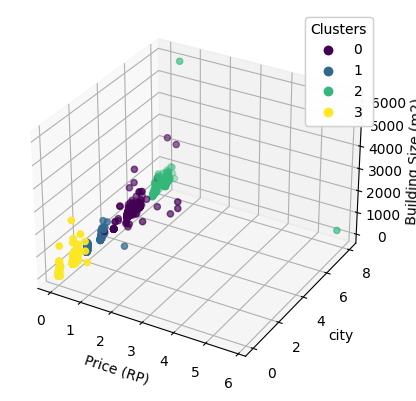

In [ ]:
import matplotlib.pyplot as plt
from mpl_toolkits.mplot3d import Axes3D
import seaborn as sns

plt.figure(figsize=(12, 6))
palette = ['blue', 'red', 'gold', 'green']

# Buat plot 3D
fig = plt.figure()
ax = fig.add_subplot(111, projection='3d')

# Scatter plot
scatter = ax.scatter(df['price_in_rp'], df['city_encoded'], df['building_size_m2'], c=df['Cluster_KM'], cmap='viridis')

# Label sumbu
ax.set_xlabel('Price (RP)')
ax.set_ylabel('city')
ax.set_zlabel('Building Size (m2)')

# Tambahkan legenda
legend = ax.legend(*scatter.legend_elements(), title='Clusters', loc='upper right')
ax.add_artist(legend)

plt.show()


In [ ]:
cluster_11 = df[['lat','long']][df["Cluster_KM"]==0].values.tolist()
cluster_22 = df[['lat','long']][df["Cluster_KM"]==1].values.tolist()
cluster_33 = df[['lat','long']][df["Cluster_KM"]==2].values.tolist()
cluster_44 = df[['lat','long']][df["Cluster_KM"]==3].values.tolist()

In [ ]:
import folium
from folium import plugins
map = folium.Map(location = [-2.548926, 118.0148634], zoom_start = 10, title = "openstreetmap")
map

In [ ]:
for i in cluster_11 :
  folium.CircleMarker(i,radius =2, color = "blue").add_to(map)
for i in cluster_22 :
  folium.CircleMarker(i,radius =2, color = "red").add_to(map)
for i in cluster_33 :
  folium.CircleMarker(i,radius =2, color = "yellow").add_to(map)
for i in cluster_44 :
  folium.CircleMarker(i,radius =2, color = "green").add_to(map)
map